In [1]:
import torch
import numpy as np
import torch.nn as nn
import torch.optim as optim
from mmd import mix_rbf_mmd2
from torch import Tensor
import torch.nn.functional as F
import matplotlib.pyplot as plt
import pandas as pd

In [2]:
torch.cuda.is_available()
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
device = get_default_device()
device

device(type='cuda')

In [3]:
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

In [3]:
herwig = "../data/events_anomalydetection_DelphesHerwig_qcd_features.h5"
pythiabg = "../data/events_anomalydetection_DelphesPythia8_v2_qcd_features.h5"
pythiasig = "../data/events_anomalydetection_DelphesPythia8_v2_Wprime_features.h5"

datatypes = ["herwig", "pythiabg", "pythiasig"]
df = {}

df["herwig"] = pd.read_hdf(herwig)
df["pythiabg"] = pd.read_hdf(pythiabg)
df["pythiasig"] = pd.read_hdf(pythiasig)

for datatype in datatypes:
    df[datatype]["tau21j2"] = df[datatype]["tau2j2"] / df[datatype]["tau1j2"]
nsubjetherwig = df["herwig"]["tau21j2"]
data = np.asarray(nsubjetherwig)


data2 = data[0:256]
short_data = data[0:256]
short_data = torch.FloatTensor(short_data)
short_data = short_data.unsqueeze(0)
short_data = short_data.permute(1,0)

all_data = data
all_data = torch.FloatTensor(all_data)
all_data = all_data.unsqueeze(0)
all_data = all_data.permute(1,0)

In [4]:
print(all_data.shape)

torch.Size([999999, 1])


In [4]:
class GNet(nn.Module):
    def __init__(self):
        super().__init__()
        model = nn.Sequential(
            nn.Linear(1, 7),
            nn.ELU(),
            nn.Linear(7, 13),
            nn.ELU(),
            nn.Linear(13, 7),
            nn.ELU(),
            nn.Linear(7, 1)
        )
        self.model = model
    def forward(self, input):
        return self.model(input)

class Encoder(nn.Module):
    def __init__(self):
        super().__init__()
        model = nn.Sequential(
            nn.Linear(1, 11),
            nn.ELU(),
            nn.Linear(11, 29),
            nn.ELU()
        )
        self.model = model
    def forward(self, input):
        return self.model(input)

class Decoder(nn.Module):
    def __init__(self):
        super().__init__()
        model = nn.Sequential(
            nn.Linear(29, 11),
            nn.ELU(),
            nn.Linear(11, 1),
        )
        self.model = model
    def forward(self, input):
        return self.model(input)

In [5]:
def data_sampler(dist_type, dist_param, batch_size=1):
    if dist_type=="gaussian":
        return Tensor(np.random.normal(dist_param[0], dist_param[1], (batch_size, 1))).requires_grad_()#.to(torch.device("cuda:0"))

In [10]:
num_iteration = 100000
num_gen = 1
num_enc_dec = 5
lr = 1e-3
batch_size = 128
target_dist = "gaussian"
target_param = (23., 1.)
noise_dist = "gaussian"
noise_param = (0., 1.)


In [11]:


lambda_AE = 8.
# sigma for MMD
base = 1.0
sigma_list = [1, 2, 4, 8, 16]
sigma_list = [sigma / base for sigma in sigma_list]
print_int = 100

gen = GNet()
enc = Encoder()
dec = Decoder()
# lr = (1e-2, 1e-3, 1e-4)
criterion = nn.MSELoss()
gen_optimizer = optim.Adam(gen.parameters(), lr=lr)
enc_optimizer = optim.Adam(enc.parameters(), lr=lr)
dec_optimizer = optim.Adam(dec.parameters(), lr=lr)
cum_dis_loss = 0
cum_gen_loss = 0

cum_dis_loss -388.4698391273022, cum_gen_loss 2.7568907165527343


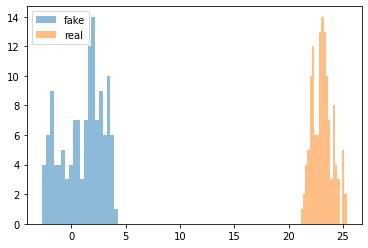

cum_dis_loss 1.7918421156406403, cum_gen_loss 2.4513128757476808


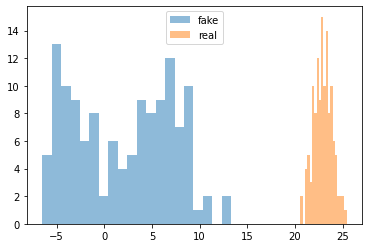

cum_dis_loss 2.0546160666942597, cum_gen_loss 2.097269693613052


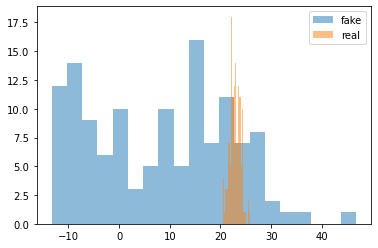

cum_dis_loss 1.567313689470291, cum_gen_loss 1.6034906470775605


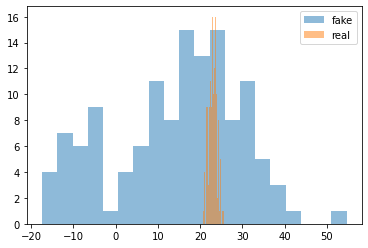

cum_dis_loss 1.4254703159332276, cum_gen_loss 1.4266777324676514


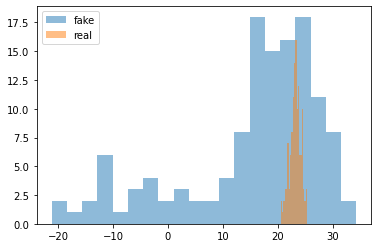

cum_dis_loss 0.8938901079595089, cum_gen_loss 0.886751651763916


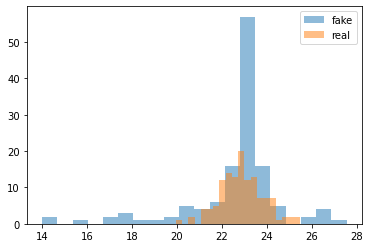

cum_dis_loss 0.2716172828823328, cum_gen_loss 0.266119871661067


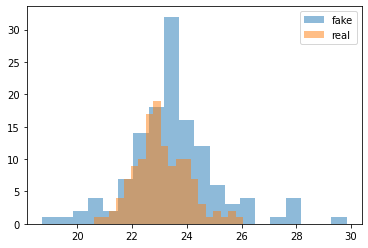

cum_dis_loss 0.20659247218817473, cum_gen_loss 0.19885901123285293


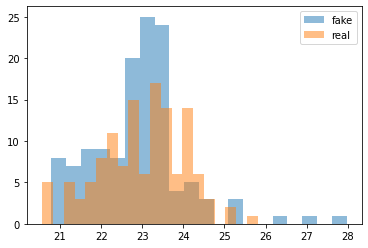

cum_dis_loss 0.18379622768610715, cum_gen_loss 0.1812802769243717


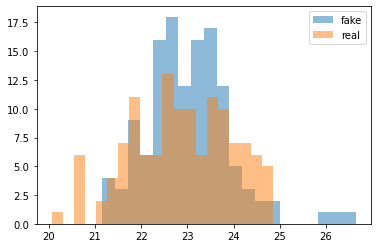

cum_dis_loss 0.1787773303091526, cum_gen_loss 0.1690821187198162


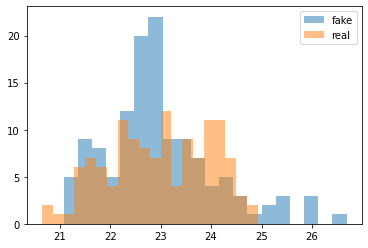

cum_dis_loss 0.17722948890924453, cum_gen_loss 0.17372238382697106


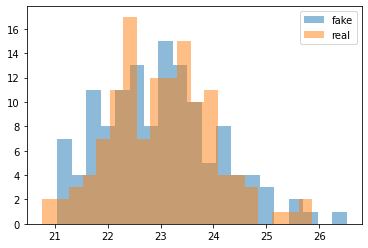

cum_dis_loss 0.16991177847981453, cum_gen_loss 0.17998434863984586


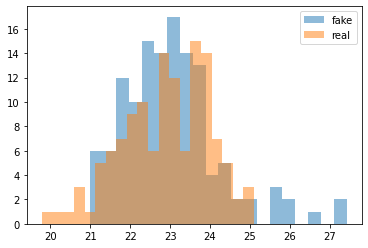

cum_dis_loss 0.165660783611238, cum_gen_loss 0.16852665454149246


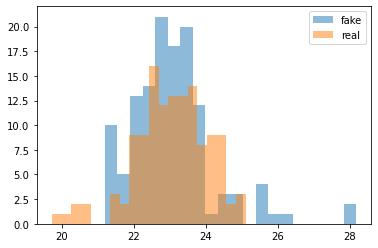

cum_dis_loss 0.1656068860590458, cum_gen_loss 0.16012979738414287


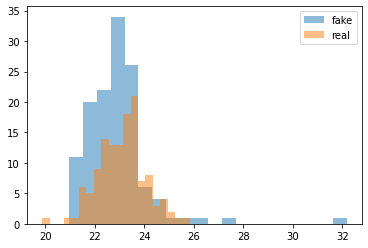

cum_dis_loss 0.1742001061141491, cum_gen_loss 0.18137171633541585


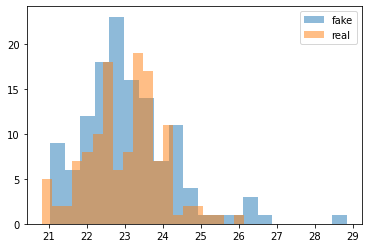

cum_dis_loss 0.16746277311444283, cum_gen_loss 0.1696199544519186


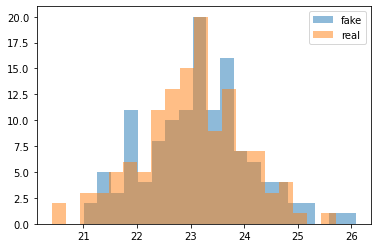

cum_dis_loss 0.16558090180158616, cum_gen_loss 0.18509286791086196


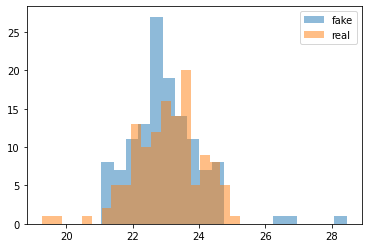

cum_dis_loss 0.1611642973050475, cum_gen_loss 0.1748647490888834


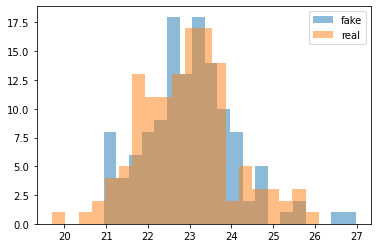

cum_dis_loss 0.16599826635420323, cum_gen_loss 0.1706687992438674


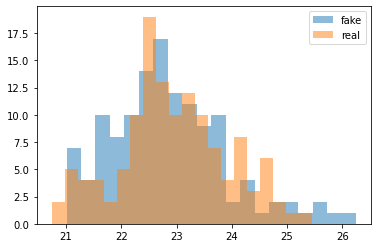

cum_dis_loss 0.1649533075094223, cum_gen_loss 0.16936115644872188


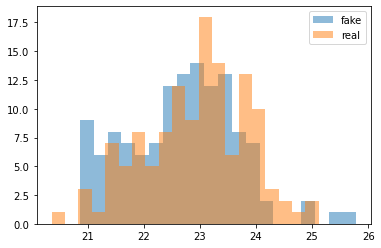

cum_dis_loss 0.16682106793671847, cum_gen_loss 0.16228994391858578


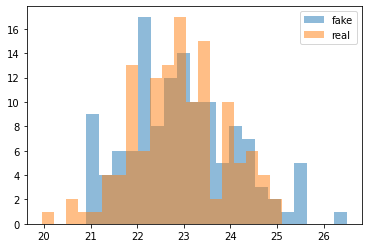

cum_dis_loss 0.17031657333672046, cum_gen_loss 0.17225885979831218


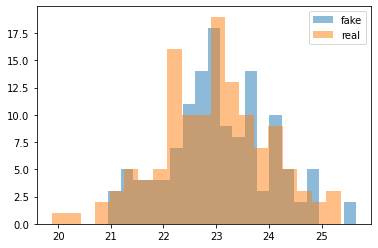

cum_dis_loss 0.15895578134059907, cum_gen_loss 0.17232728958129884


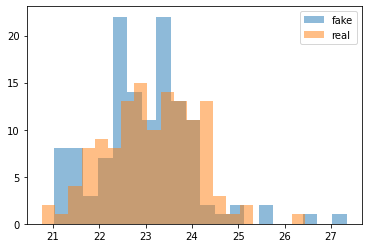

cum_dis_loss 0.15623886685818433, cum_gen_loss 0.16596649140119552


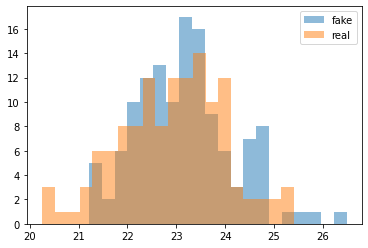

cum_dis_loss 0.1563873024880886, cum_gen_loss 0.16429618809372187


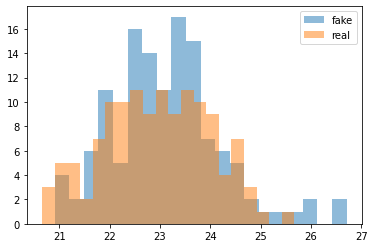

cum_dis_loss 0.15530697298794985, cum_gen_loss 0.17646538011729718


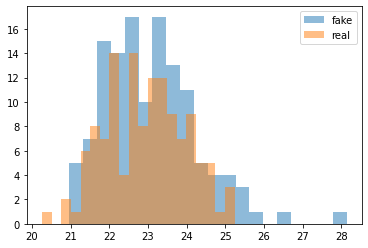

cum_dis_loss 0.15872956753522158, cum_gen_loss 0.17185914438217878


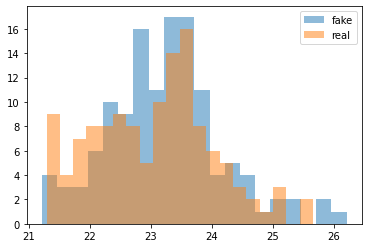

cum_dis_loss 0.16423133720457553, cum_gen_loss 0.16668909948319197


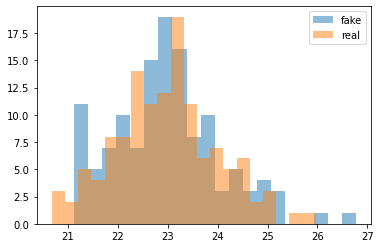

cum_dis_loss 0.16287302797287703, cum_gen_loss 0.1732825356721878


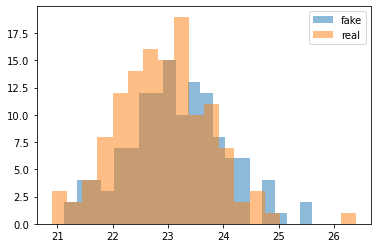

cum_dis_loss 0.17227465245127677, cum_gen_loss 0.18871295675635338


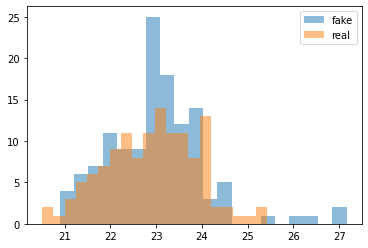

cum_dis_loss 0.17003489733487367, cum_gen_loss 0.17311011090874673


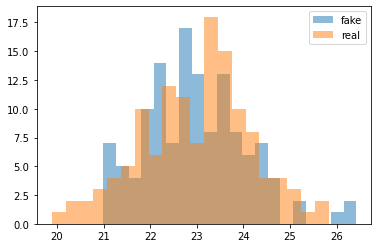

cum_dis_loss 0.1675345273539424, cum_gen_loss 0.1800165870040655


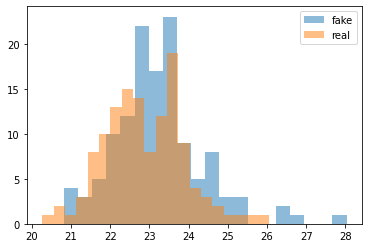

cum_dis_loss 0.1674440878778696, cum_gen_loss 0.18344096384942532


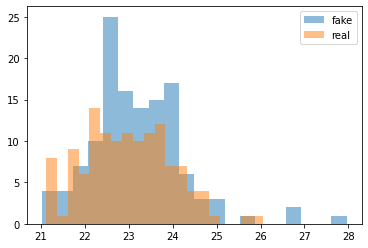

cum_dis_loss 0.16894598814100026, cum_gen_loss 0.18111851282417774


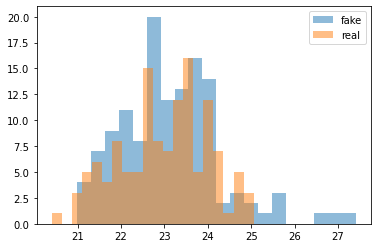

cum_dis_loss 0.16690455494821071, cum_gen_loss 0.1816981526464224


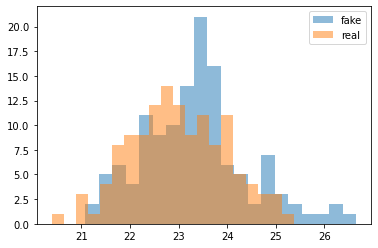

cum_dis_loss 0.16850057287514209, cum_gen_loss 0.18787339434027672


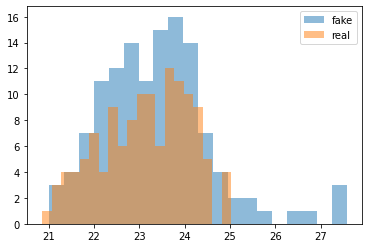

cum_dis_loss 0.1677840734049678, cum_gen_loss 0.1745854053646326


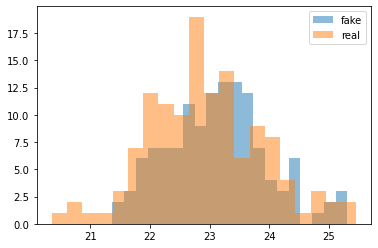

cum_dis_loss 0.17857289261370898, cum_gen_loss 0.17848780423402785


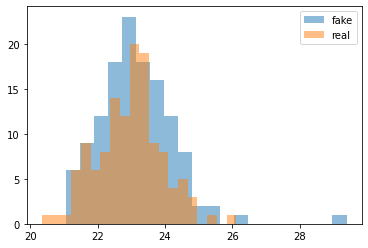

cum_dis_loss 0.17788552394509316, cum_gen_loss 0.18018658630549908


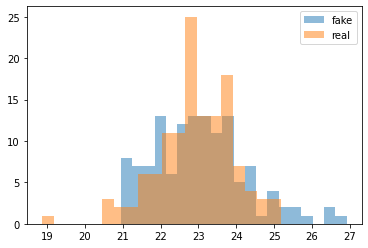

cum_dis_loss 0.1789146569222212, cum_gen_loss 0.19096873581409454


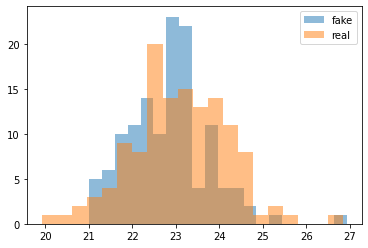

cum_dis_loss 0.18841287113726138, cum_gen_loss 0.21263069942593574


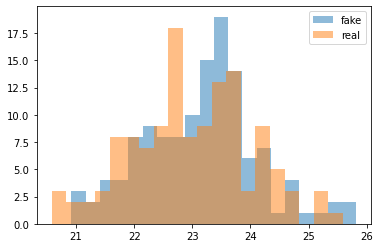

cum_dis_loss 0.18743337769061327, cum_gen_loss 0.19238975070416928


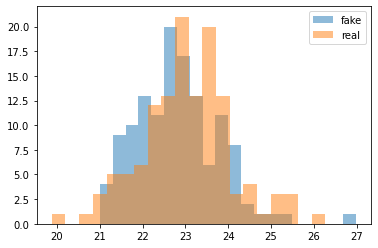

cum_dis_loss 0.16931749932467938, cum_gen_loss 0.19131365962326527


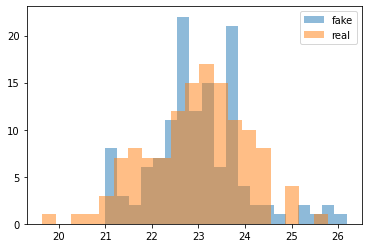

cum_dis_loss 0.18559079177677631, cum_gen_loss 0.20899774372577667


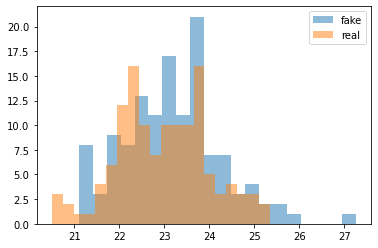

cum_dis_loss 0.18594845612347127, cum_gen_loss 0.20578491367399693


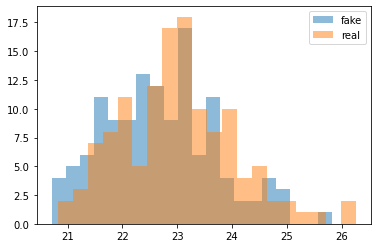

cum_dis_loss 0.1866285826265812, cum_gen_loss 0.20357985712587834


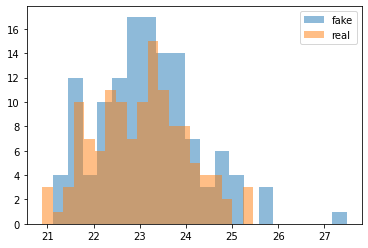

cum_dis_loss 0.19060950449109076, cum_gen_loss 0.22018807351589204


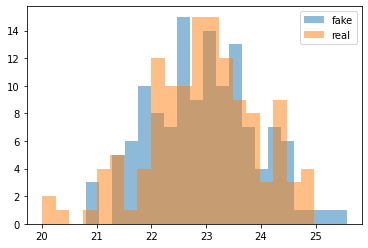

cum_dis_loss 0.1870792242437601, cum_gen_loss 0.2161317602545023


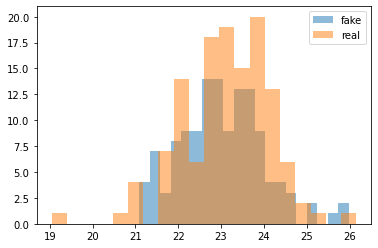

cum_dis_loss 0.20430818225443365, cum_gen_loss 0.21733861684799194


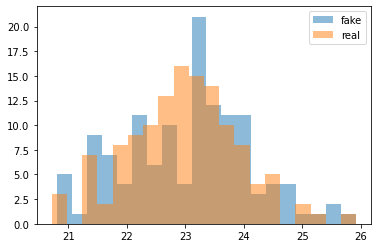

cum_dis_loss 0.19498361086845398, cum_gen_loss 0.2113783534616232


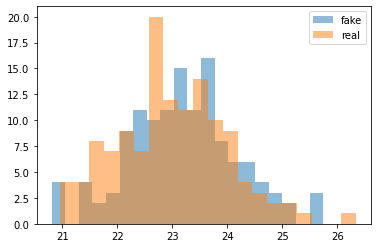

cum_dis_loss 0.19702091355621815, cum_gen_loss 0.21924711316823958


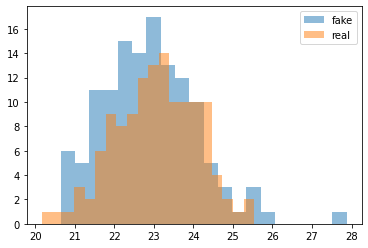

cum_dis_loss 0.1952297419756651, cum_gen_loss 0.21846591979265212


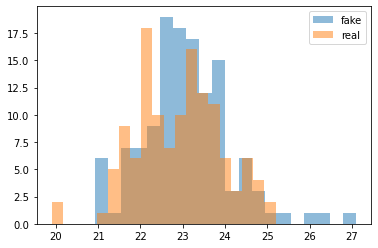

cum_dis_loss 0.20047344817221166, cum_gen_loss 0.2264021921902895


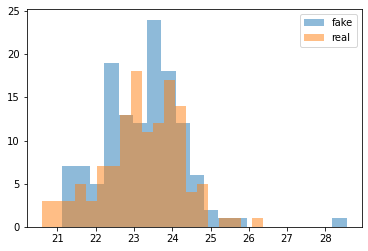

cum_dis_loss 0.21145857137441634, cum_gen_loss 0.23052985087037087


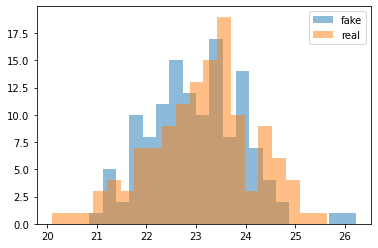

cum_dis_loss 0.1971197706460953, cum_gen_loss 0.20981693528592588


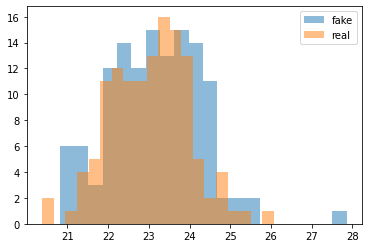

cum_dis_loss 0.20198462779819965, cum_gen_loss 0.21686145797371864


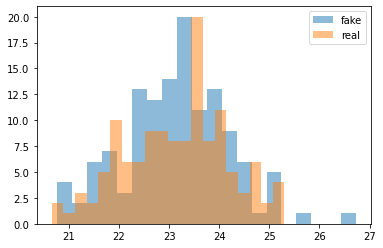

cum_dis_loss 0.19756693036854267, cum_gen_loss 0.22495562709867956


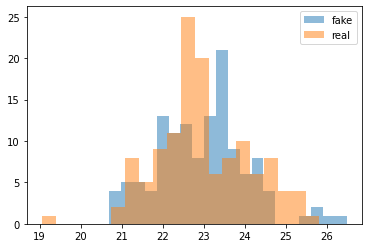

cum_dis_loss 0.20255705289542675, cum_gen_loss 0.22340044997632502


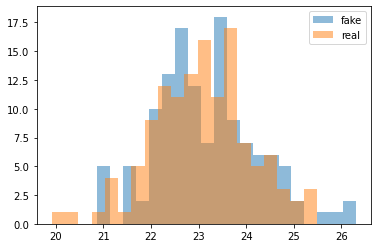

cum_dis_loss 0.20905307610332965, cum_gen_loss 0.22331057414412497


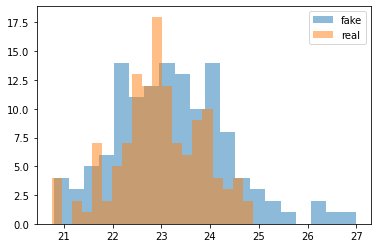

cum_dis_loss 0.19891149497032165, cum_gen_loss 0.23466623425483704


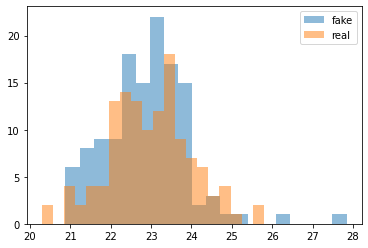

cum_dis_loss 0.2136519449800253, cum_gen_loss 0.2391659977287054


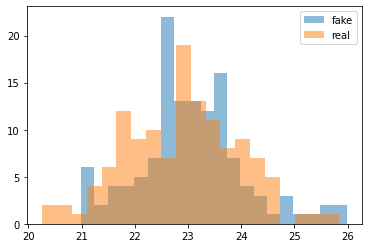

cum_dis_loss 0.20211405491828918, cum_gen_loss 0.22184857681393624


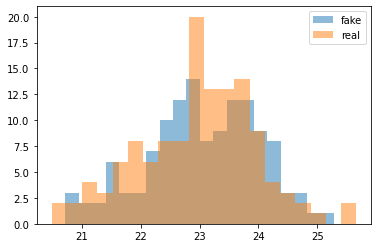

cum_dis_loss 0.2110314175337553, cum_gen_loss 0.2273486515879631


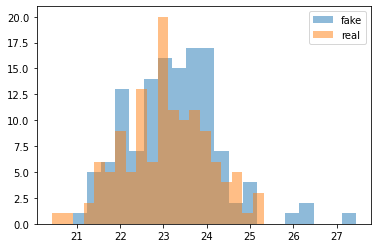

cum_dis_loss 0.2072931951135397, cum_gen_loss 0.22737036064267158


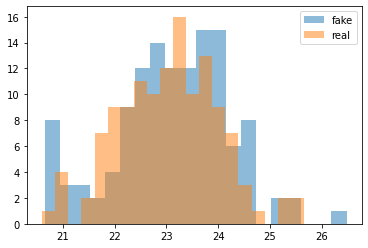

cum_dis_loss 0.2020095973610878, cum_gen_loss 0.2388268569111824


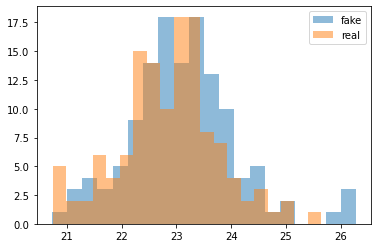

cum_dis_loss 0.20993891674280166, cum_gen_loss 0.2241197009384632


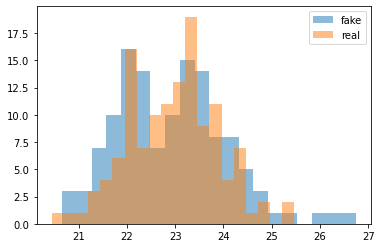

cum_dis_loss 0.21853648161888123, cum_gen_loss 0.2305055970698595


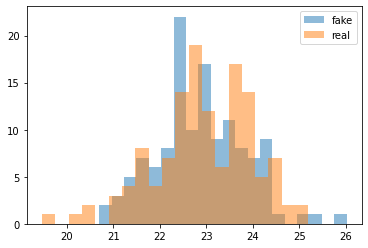

cum_dis_loss 0.20924277681112288, cum_gen_loss 0.21720269717276097


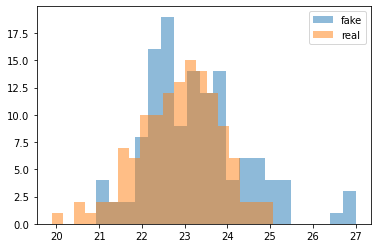

cum_dis_loss 0.2069606164395809, cum_gen_loss 0.21999912306666375


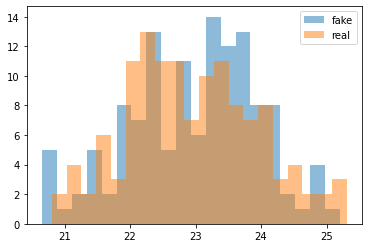

cum_dis_loss 0.2125177684277296, cum_gen_loss 0.23503328077495098


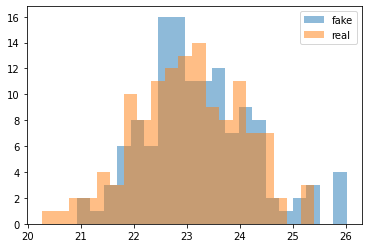

cum_dis_loss 0.20364195926487447, cum_gen_loss 0.22551739186048508


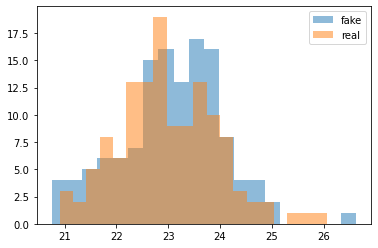

cum_dis_loss 0.2073881903141737, cum_gen_loss 0.22722427055239677


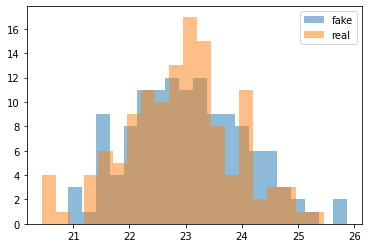

cum_dis_loss 0.2205399426072836, cum_gen_loss 0.236675233989954


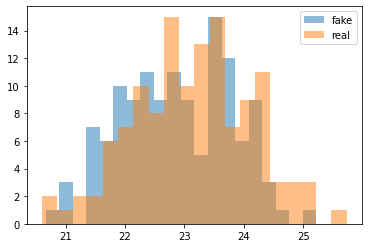

cum_dis_loss 0.20755819818377494, cum_gen_loss 0.22578965067863466


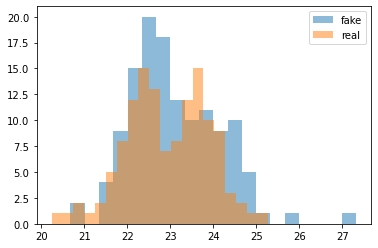

cum_dis_loss 0.21467959076166154, cum_gen_loss 0.22662311553955078


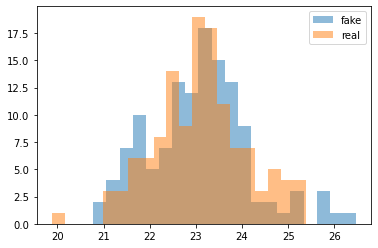

cum_dis_loss 0.21239888997375966, cum_gen_loss 0.2359610578417778


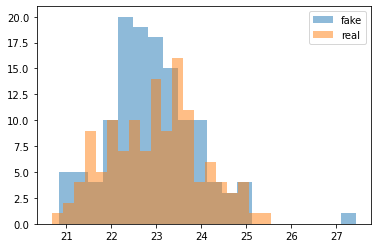

cum_dis_loss 0.2186469376385212, cum_gen_loss 0.22215244822204114


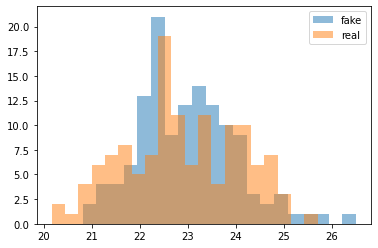

cum_dis_loss 0.20576685639470815, cum_gen_loss 0.23044162288308143


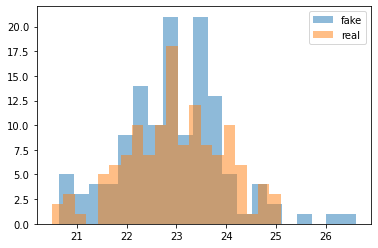

cum_dis_loss 0.21207393772900104, cum_gen_loss 0.2306345849484205


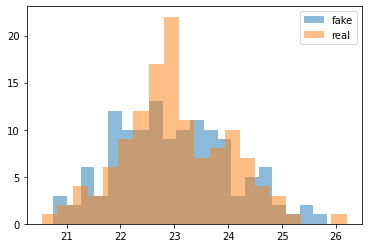

cum_dis_loss 0.21102756893634797, cum_gen_loss 0.24519538581371308


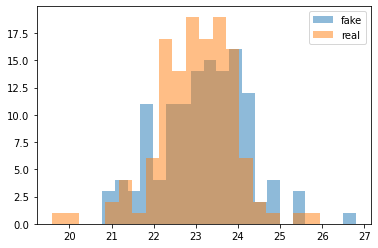

cum_dis_loss 0.22535362181067467, cum_gen_loss 0.24147763095796107


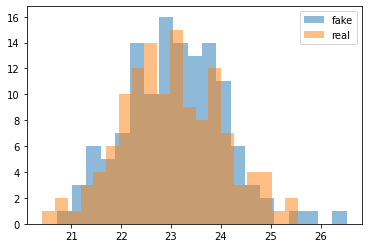

cum_dis_loss 0.20674057956039907, cum_gen_loss 0.24374543949961663


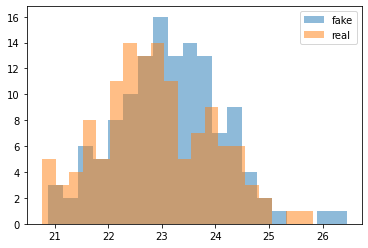

cum_dis_loss 0.21696814307570458, cum_gen_loss 0.23312732361257077


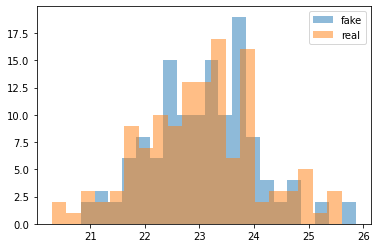

cum_dis_loss 0.21206115752458574, cum_gen_loss 0.2280644565820694


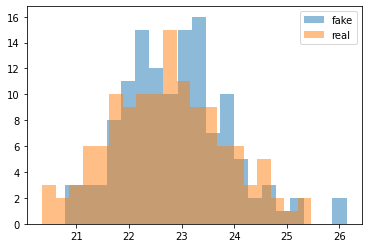

cum_dis_loss 0.20205105544626714, cum_gen_loss 0.2375488831102848


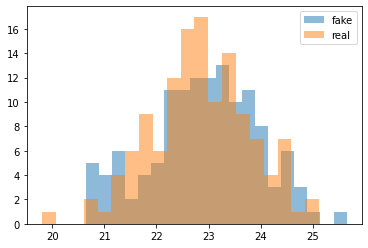

cum_dis_loss 0.21333243043720723, cum_gen_loss 0.2396846543252468


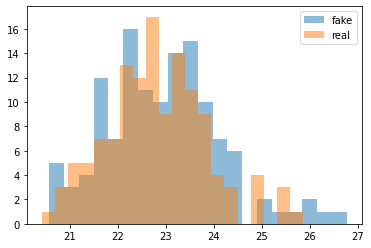

cum_dis_loss 0.21288409568369387, cum_gen_loss 0.23273741312325


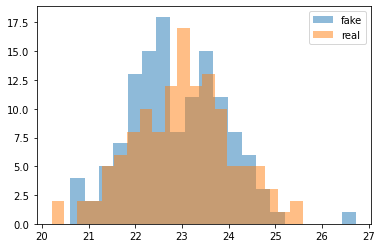

cum_dis_loss 0.2076974468678236, cum_gen_loss 0.2306298565864563


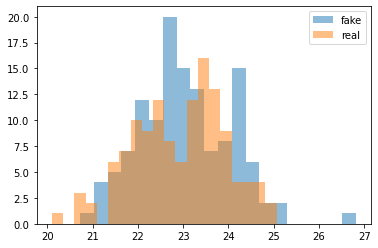

cum_dis_loss 0.212521734893322, cum_gen_loss 0.22897595487535


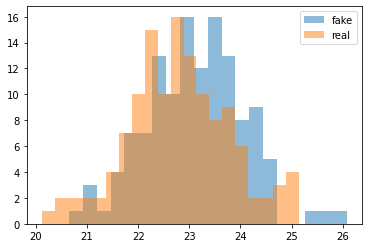

cum_dis_loss 0.21588743340969085, cum_gen_loss 0.2397176916897297


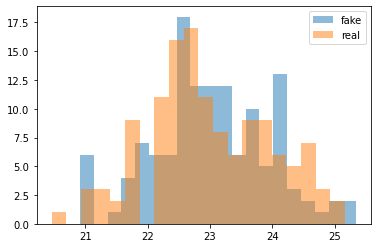

cum_dis_loss 0.21223466637730598, cum_gen_loss 0.23718928113579751


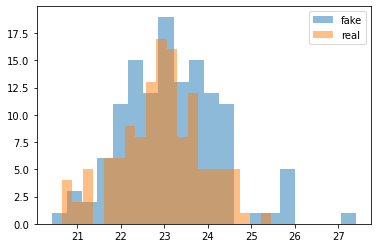

cum_dis_loss 0.22237757086753845, cum_gen_loss 0.2415584810078144


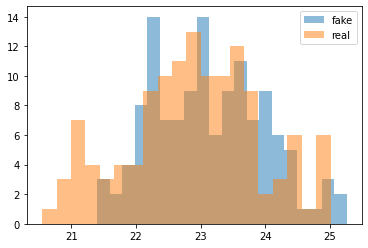

cum_dis_loss 0.2137261098921299, cum_gen_loss 0.23443110525608063


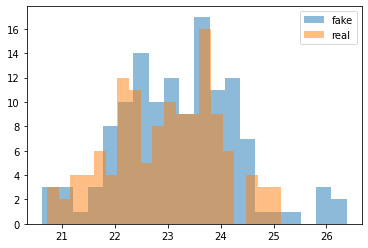

cum_dis_loss 0.21438635715842247, cum_gen_loss 0.2380432079732418


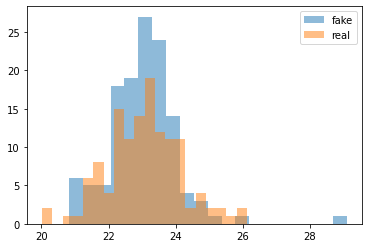

cum_dis_loss 0.21156328727304935, cum_gen_loss 0.23803184777498246


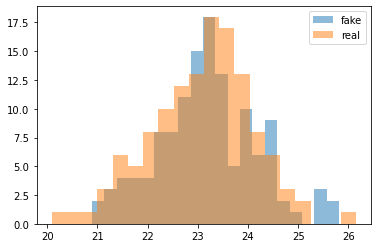

cum_dis_loss 0.22098659491539002, cum_gen_loss 0.23298975631594657


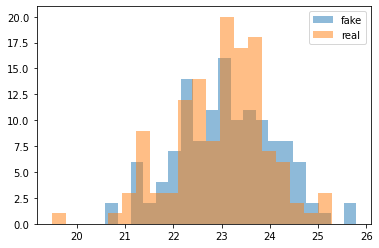

cum_dis_loss 0.22666767199337481, cum_gen_loss 0.24168726235628127


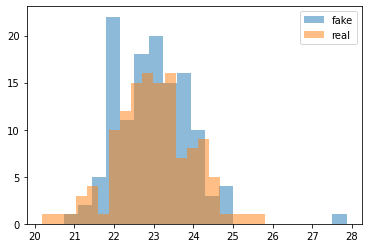

cum_dis_loss 0.22222884330153464, cum_gen_loss 0.2487899622321129


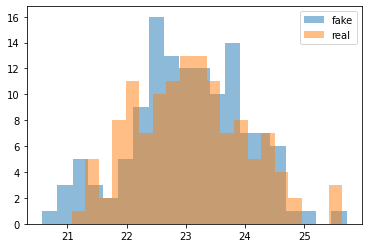

cum_dis_loss 0.21781916180253028, cum_gen_loss 0.2308005042374134


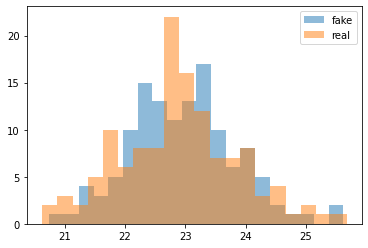

cum_dis_loss 0.22101886421442032, cum_gen_loss 0.2345590030401945


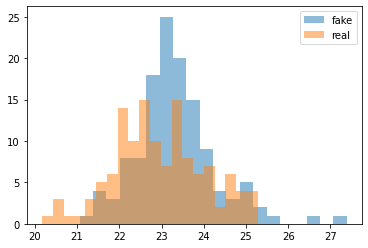

cum_dis_loss 0.21515104122459888, cum_gen_loss 0.23014274671673773


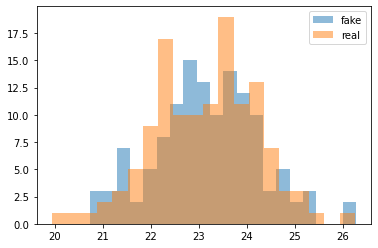

cum_dis_loss 0.2150083517283201, cum_gen_loss 0.224066856354475


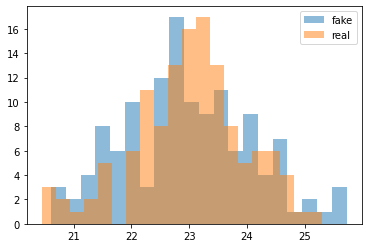

cum_dis_loss 0.22443000896275042, cum_gen_loss 0.23544010996818543


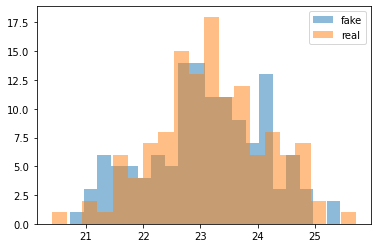

cum_dis_loss 0.21577499447762966, cum_gen_loss 0.23158953435719012


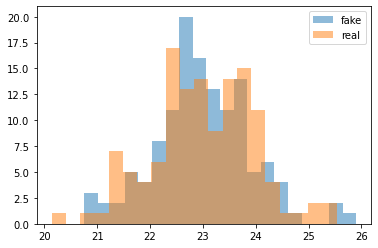

cum_dis_loss 0.21491238911449909, cum_gen_loss 0.2396622222661972


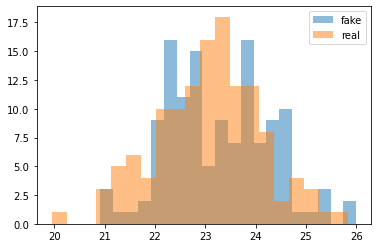

cum_dis_loss 0.21221406364440917, cum_gen_loss 0.24213684879243375


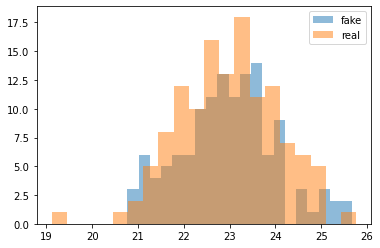

cum_dis_loss 0.21650081427395343, cum_gen_loss 0.23774733483791352


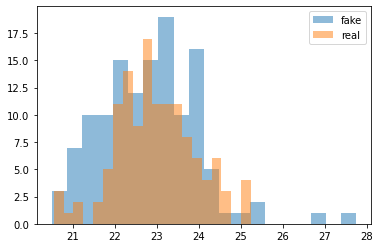

cum_dis_loss 0.22397647579014301, cum_gen_loss 0.23610578894615172


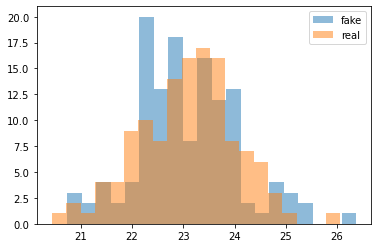

cum_dis_loss 0.21811503159999848, cum_gen_loss 0.2339639335870743


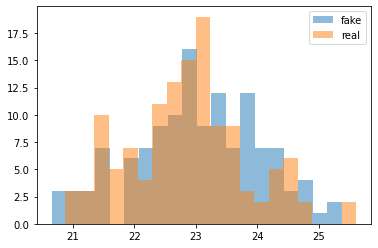

cum_dis_loss 0.22075229083001613, cum_gen_loss 0.2360430432856083


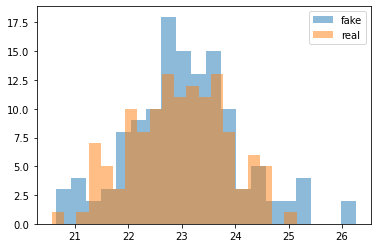

cum_dis_loss 0.21905171373486518, cum_gen_loss 0.23426539361476897


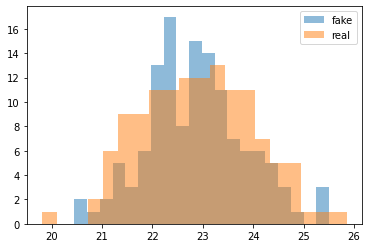

cum_dis_loss 0.22047951078414918, cum_gen_loss 0.22656740203499795


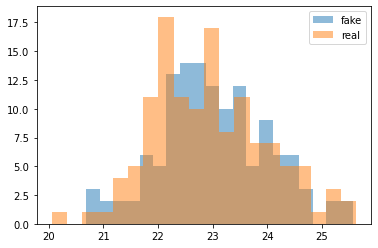

cum_dis_loss 0.22894059075415135, cum_gen_loss 0.2498173674941063


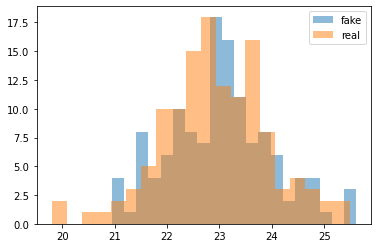

cum_dis_loss 0.21961456020176412, cum_gen_loss 0.24206458121538163


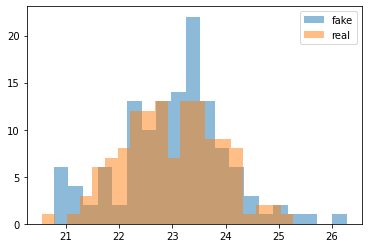

cum_dis_loss 0.2152332547158003, cum_gen_loss 0.2440918953716755


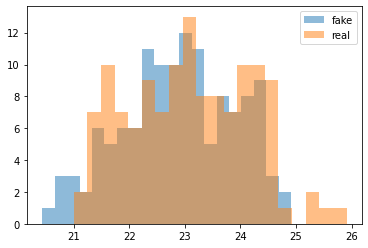

cum_dis_loss 0.22900676412880422, cum_gen_loss 0.24597889810800552


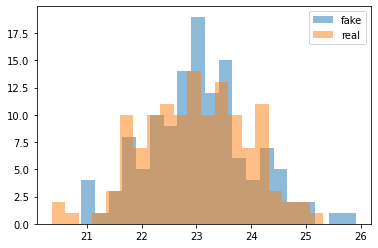

cum_dis_loss 0.21680506151914597, cum_gen_loss 0.24332578390836715


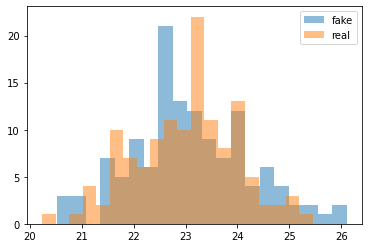

cum_dis_loss 0.22220050601661206, cum_gen_loss 0.23318940848112107


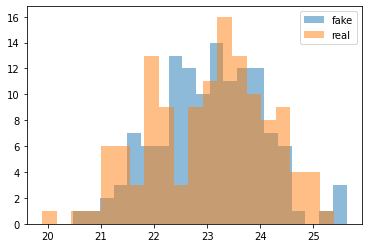

cum_dis_loss 0.21886153529584407, cum_gen_loss 0.2379628936201334


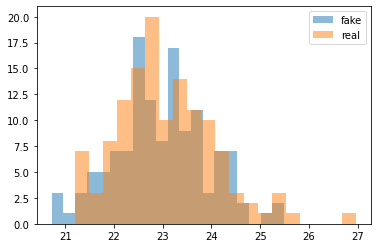

cum_dis_loss 0.22571797826886178, cum_gen_loss 0.24076895147562027


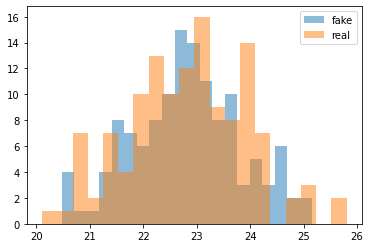

cum_dis_loss 0.21337257699668408, cum_gen_loss 0.24110869467258453


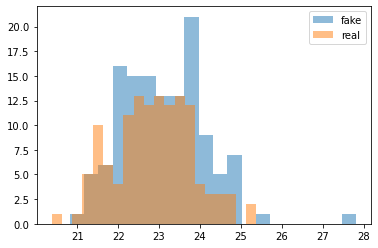

cum_dis_loss 0.22385920540988447, cum_gen_loss 0.24657369017601014


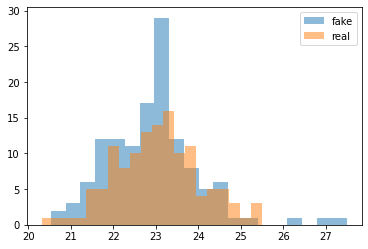

cum_dis_loss 0.22807936269044876, cum_gen_loss 0.23582066148519515


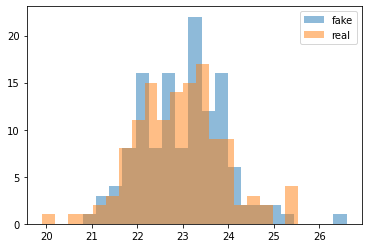

cum_dis_loss 0.22228037086129188, cum_gen_loss 0.24885743543505667


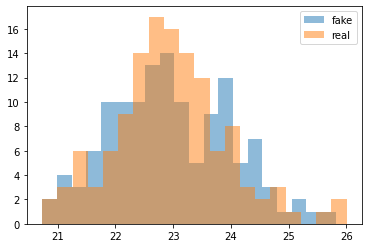

cum_dis_loss 0.2300094436109066, cum_gen_loss 0.24744357779622078


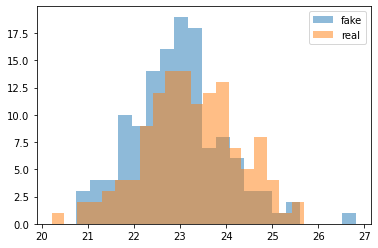

cum_dis_loss 0.2224151017218828, cum_gen_loss 0.23478996530175208


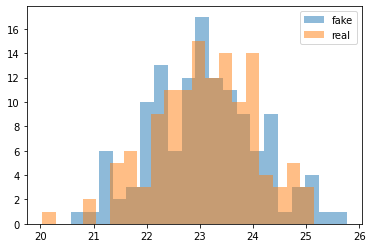

cum_dis_loss 0.22162832564115525, cum_gen_loss 0.2387664397060871


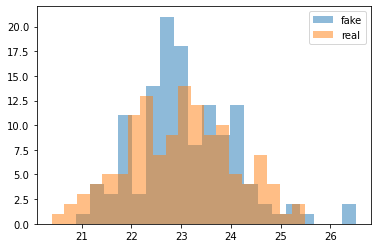

cum_dis_loss 0.23596357102692128, cum_gen_loss 0.24993638694286346


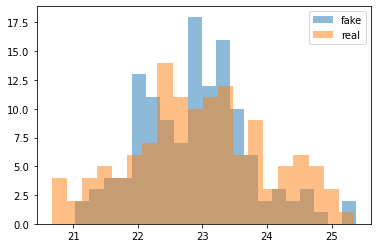

cum_dis_loss 0.22712639757990838, cum_gen_loss 0.23801626093685627


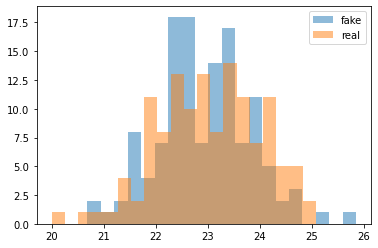

cum_dis_loss 0.2172808922678232, cum_gen_loss 0.25040201559662817


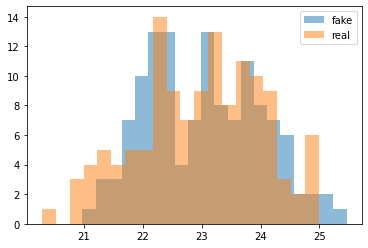

cum_dis_loss 0.21794883064925671, cum_gen_loss 0.23987852334976195


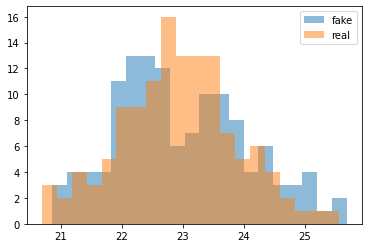

cum_dis_loss 0.22473105932772158, cum_gen_loss 0.23058941408991815


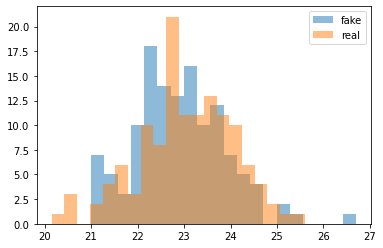

cum_dis_loss 0.22714277581870557, cum_gen_loss 0.23782488465309143


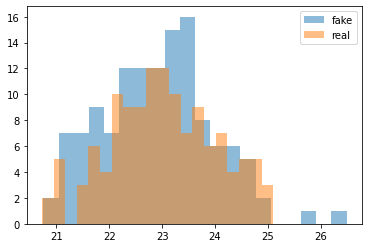

cum_dis_loss 0.23018102994561196, cum_gen_loss 0.2517323049902916


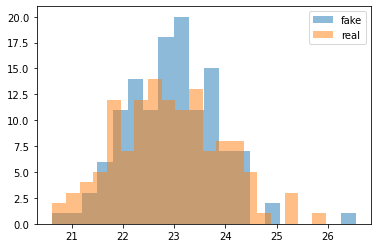

cum_dis_loss 0.22706607303023338, cum_gen_loss 0.23139550119638444


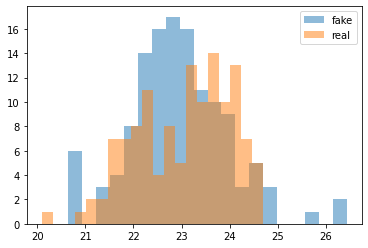

cum_dis_loss 0.2209919298887253, cum_gen_loss 0.23644428476691245


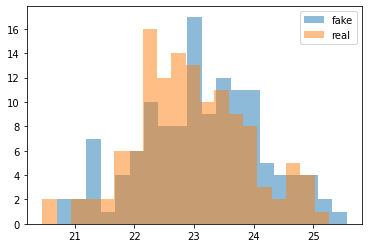

cum_dis_loss 0.22378792329132557, cum_gen_loss 0.2381834191083908


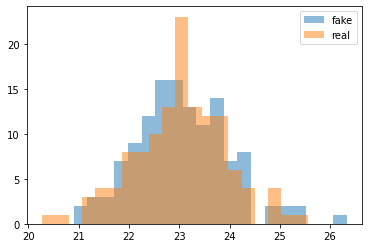

cum_dis_loss 0.21894305017590523, cum_gen_loss 0.23737134344875813


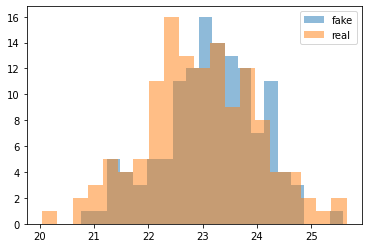

cum_dis_loss 0.21676660767197609, cum_gen_loss 0.2528857985138893


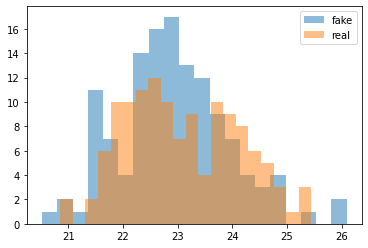

cum_dis_loss 0.22834651319682597, cum_gen_loss 0.24389474779367448


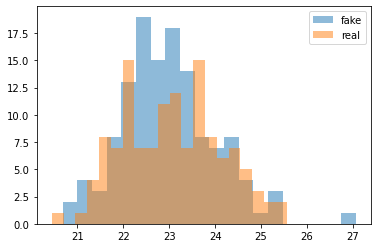

cum_dis_loss 0.22580706329643727, cum_gen_loss 0.24353062272071838


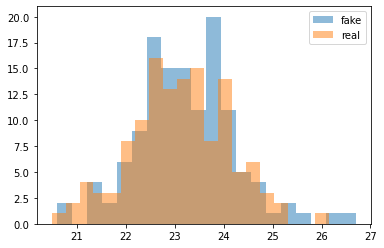

cum_dis_loss 0.22147795261442663, cum_gen_loss 0.24300988852977753


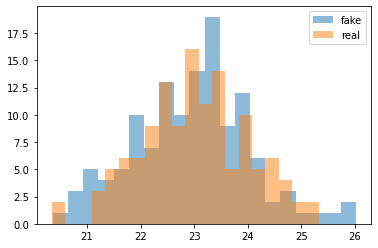

cum_dis_loss 0.21938150425255298, cum_gen_loss 0.24429779395461082


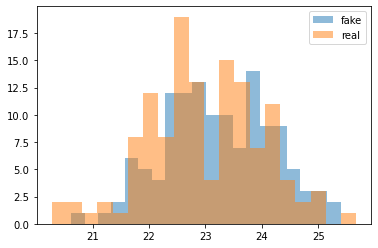

cum_dis_loss 0.222959448620677, cum_gen_loss 0.2367399864643812


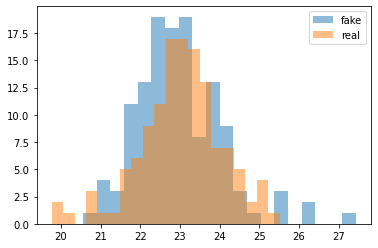

cum_dis_loss 0.22422898079454898, cum_gen_loss 0.23970107480883598


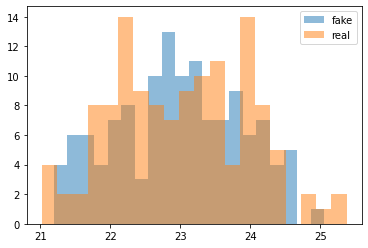

cum_dis_loss 0.22684287244081497, cum_gen_loss 0.2510822170972824


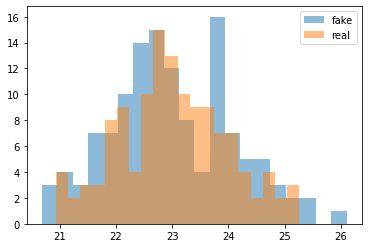

cum_dis_loss 0.218840972751379, cum_gen_loss 0.24609967276453973


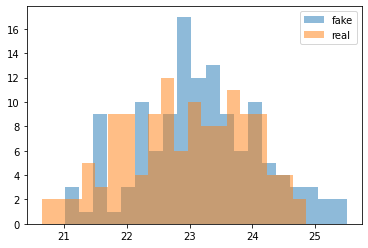

cum_dis_loss 0.2222430207580328, cum_gen_loss 0.245098444968462


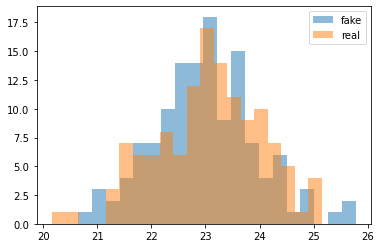

cum_dis_loss 0.22675293570756913, cum_gen_loss 0.23416210785508157


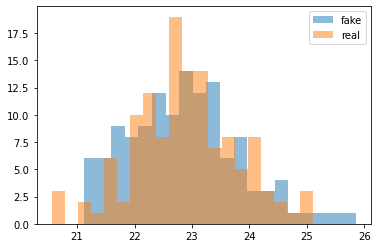

cum_dis_loss 0.22510507196187973, cum_gen_loss 0.24107770390808583


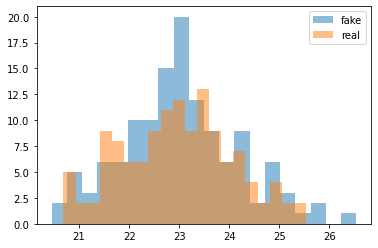

cum_dis_loss 0.21954983188211918, cum_gen_loss 0.23388301342725754


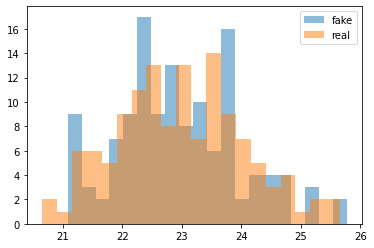

cum_dis_loss 0.23638361363112925, cum_gen_loss 0.24409488022327422


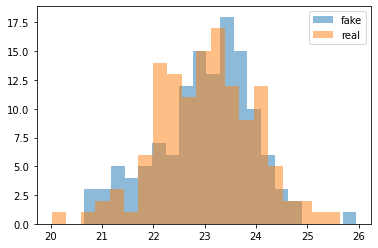

cum_dis_loss 0.2240944800376892, cum_gen_loss 0.24082602083683013


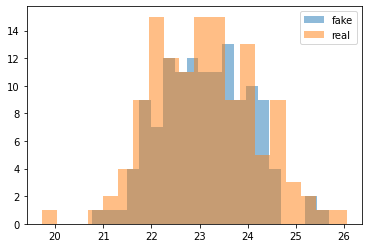

cum_dis_loss 0.2316090924292803, cum_gen_loss 0.23943612076342105


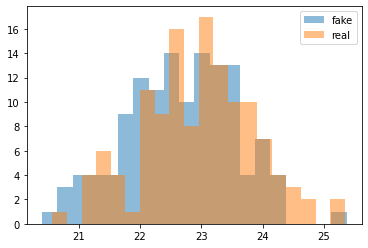

cum_dis_loss 0.2312452609539032, cum_gen_loss 0.24144258692860604


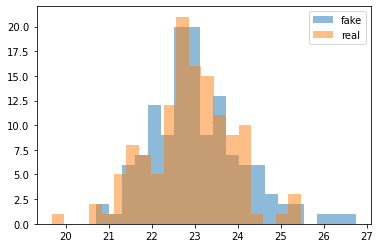

cum_dis_loss 0.22290758754312992, cum_gen_loss 0.24844399303197862


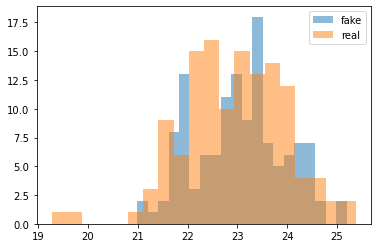

cum_dis_loss 0.22320519529283048, cum_gen_loss 0.242092052847147


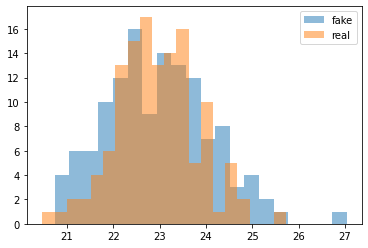

cum_dis_loss 0.2329227526932955, cum_gen_loss 0.2506453504413366


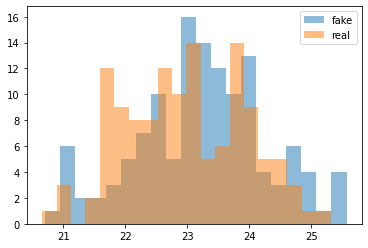

cum_dis_loss 0.23603091576695442, cum_gen_loss 0.25926226407289504


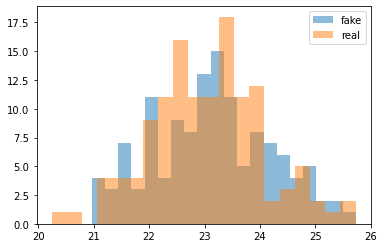

cum_dis_loss 0.23246931052207948, cum_gen_loss 0.236553975045681


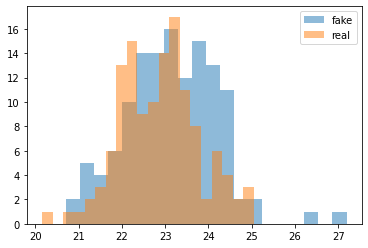

cum_dis_loss 0.22801106581091882, cum_gen_loss 0.24409031391143798


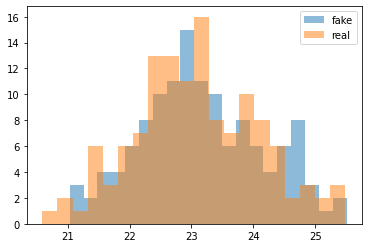

cum_dis_loss 0.2291778579354286, cum_gen_loss 0.24904316037893295


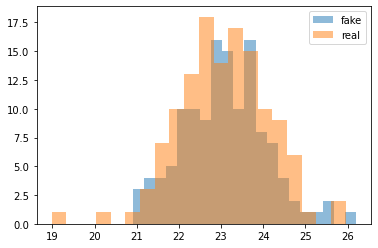

cum_dis_loss 0.2246607353836298, cum_gen_loss 0.23701957136392593


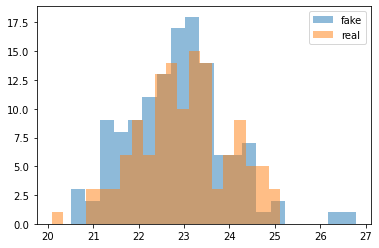

cum_dis_loss 0.23220244280993937, cum_gen_loss 0.23945873618125915


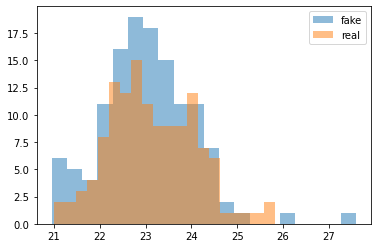

cum_dis_loss 0.23645538996160032, cum_gen_loss 0.2492678178846836


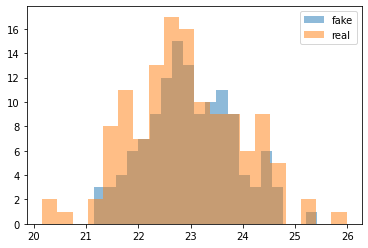

cum_dis_loss 0.22182343558967113, cum_gen_loss 0.24664851263165474


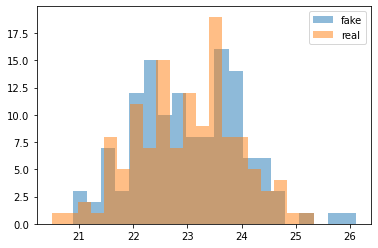

cum_dis_loss 0.22487694023549556, cum_gen_loss 0.24189480409026146


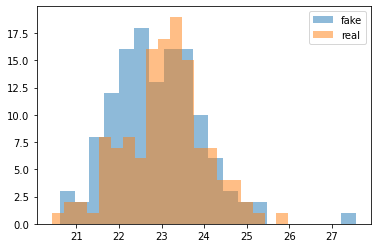

cum_dis_loss 0.22014000363647937, cum_gen_loss 0.24228288128972053


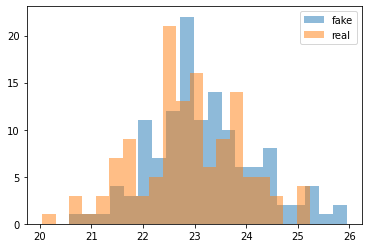

cum_dis_loss 0.24221499286592008, cum_gen_loss 0.24865323692560196


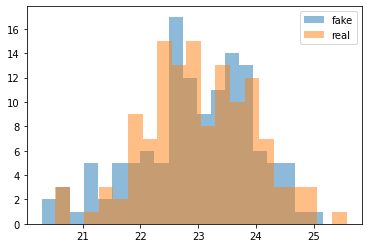

cum_dis_loss 0.23460770808160306, cum_gen_loss 0.24720189064741135


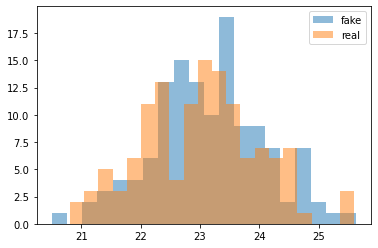

cum_dis_loss 0.2209004656970501, cum_gen_loss 0.2356751635670662


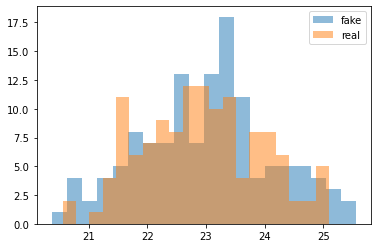

cum_dis_loss 0.23347788268327713, cum_gen_loss 0.24163838237524032


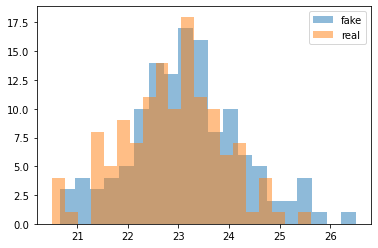

cum_dis_loss 0.22526716341078282, cum_gen_loss 0.24669813737273216


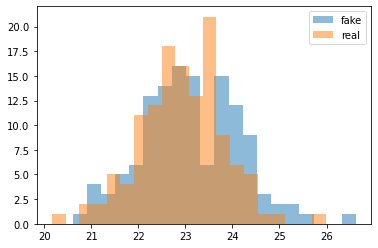

cum_dis_loss 0.23215511219203472, cum_gen_loss 0.2488467289507389


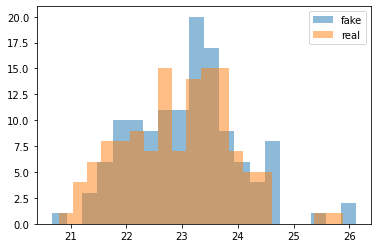

cum_dis_loss 0.2262121565937996, cum_gen_loss 0.24310109719634057


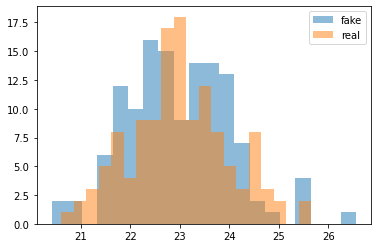

cum_dis_loss 0.23115254284441472, cum_gen_loss 0.24641907021403311


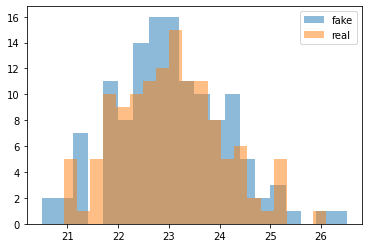

cum_dis_loss 0.22631196415424346, cum_gen_loss 0.24484823644161224


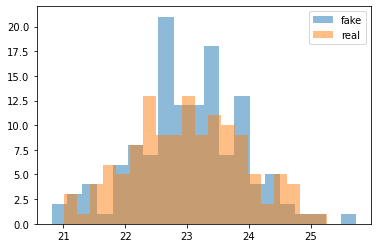

cum_dis_loss 0.2305978010594845, cum_gen_loss 0.24210685417056083


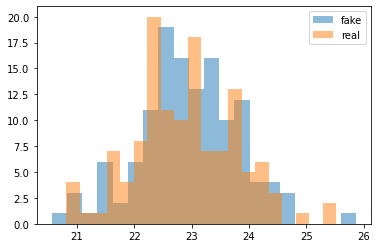

cum_dis_loss 0.2264235288798809, cum_gen_loss 0.2506430983543396


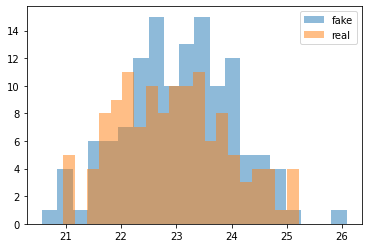

cum_dis_loss 0.2330024138689041, cum_gen_loss 0.25117141410708427


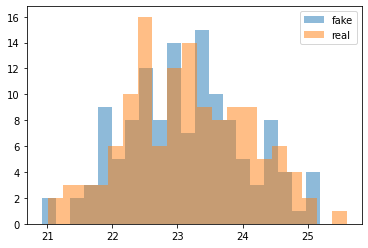

cum_dis_loss 0.23568340182304381, cum_gen_loss 0.23899404004216193


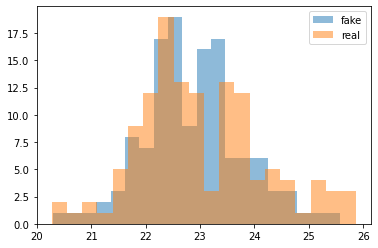

cum_dis_loss 0.2221259416490793, cum_gen_loss 0.24402788236737252


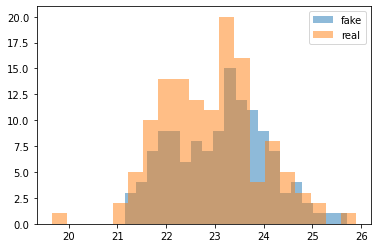

cum_dis_loss 0.23271129055321216, cum_gen_loss 0.2486482682824135


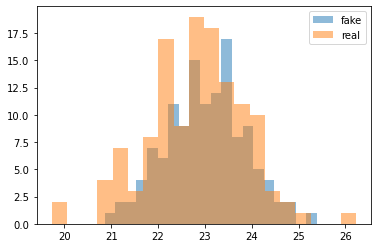

cum_dis_loss 0.23577880556881428, cum_gen_loss 0.24977901458740234


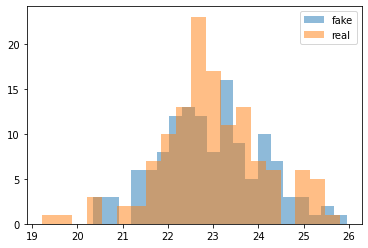

cum_dis_loss 0.23963521094620227, cum_gen_loss 0.25569080516695974


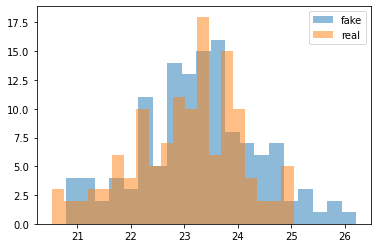

cum_dis_loss 0.23458272886276246, cum_gen_loss 0.25124185606837274


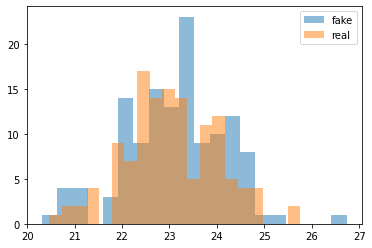

cum_dis_loss 0.22806518791615962, cum_gen_loss 0.24413979083299636


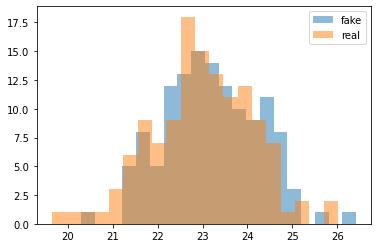

cum_dis_loss 0.2279598271548748, cum_gen_loss 0.24834673926234246


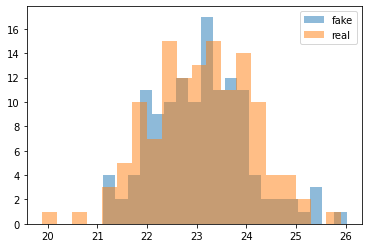

cum_dis_loss 0.2282378145903349, cum_gen_loss 0.24213876605033874


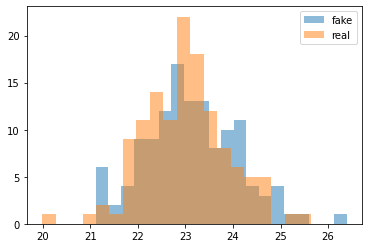

cum_dis_loss 0.23528348504006863, cum_gen_loss 0.2459964981675148


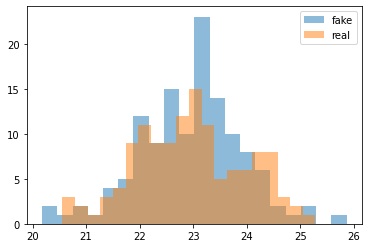

cum_dis_loss 0.22974580515921117, cum_gen_loss 0.2444779135286808


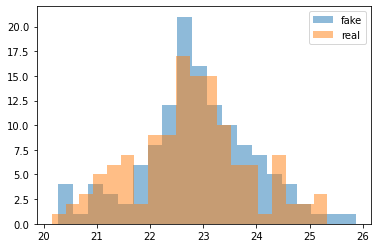

cum_dis_loss 0.24046032559871675, cum_gen_loss 0.25604586154222486


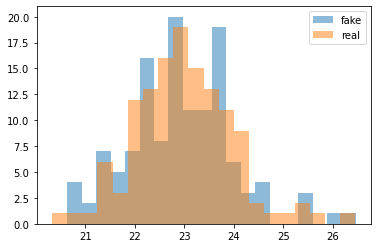

cum_dis_loss 0.22655156530439854, cum_gen_loss 0.24511228427290915


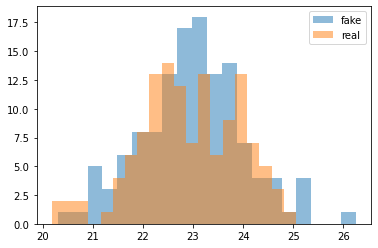

cum_dis_loss 0.22505565148591994, cum_gen_loss 0.24172964692115784


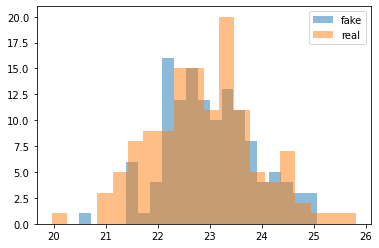

cum_dis_loss 0.2307601798772812, cum_gen_loss 0.25557100161910057


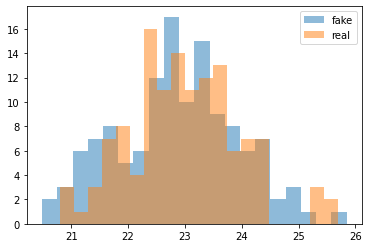

cum_dis_loss 0.23504778921604155, cum_gen_loss 0.24021674275398255


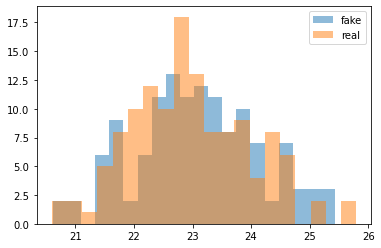

cum_dis_loss 0.2349242160767317, cum_gen_loss 0.2481813594698906


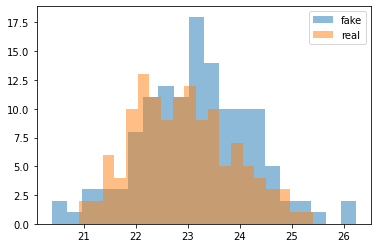

cum_dis_loss 0.23146926495432854, cum_gen_loss 0.25946701407432554


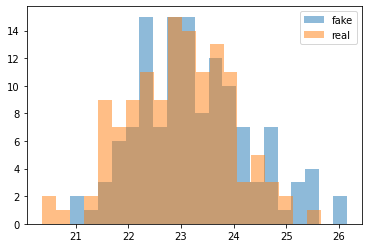

cum_dis_loss 0.2362641376554966, cum_gen_loss 0.25434127673506735


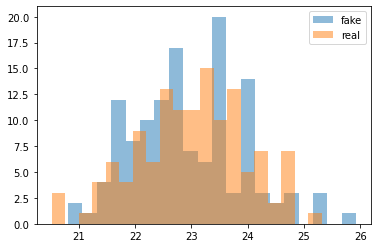

cum_dis_loss 0.23040991893410684, cum_gen_loss 0.2560372489690781


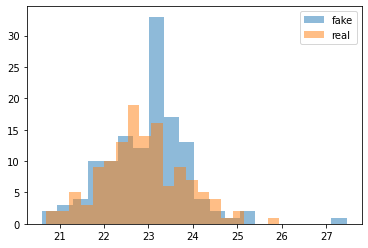

cum_dis_loss 0.22830886621773244, cum_gen_loss 0.2553983071446419


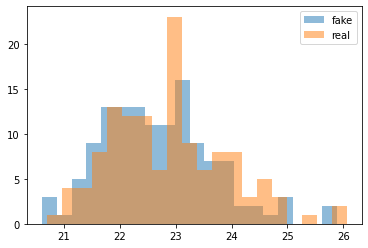

cum_dis_loss 0.24005226708948613, cum_gen_loss 0.2428098948299885


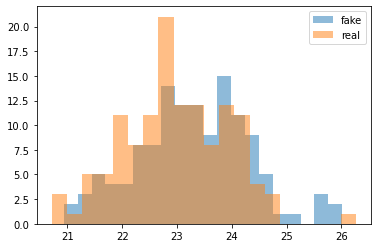

cum_dis_loss 0.2273142136335373, cum_gen_loss 0.25141693025827405


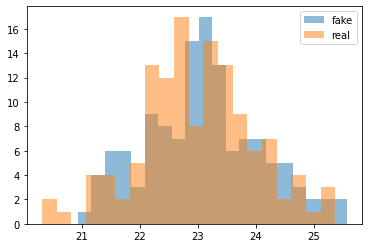

cum_dis_loss 0.2277531657665968, cum_gen_loss 0.25251817345619204


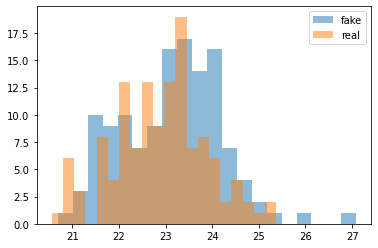

cum_dis_loss 0.23144212752580642, cum_gen_loss 0.24404589593410492


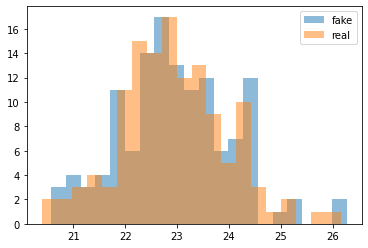

cum_dis_loss 0.2312846009284258, cum_gen_loss 0.2509458814561367


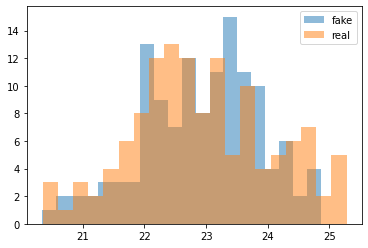

cum_dis_loss 0.23704408432543278, cum_gen_loss 0.2484619626402855


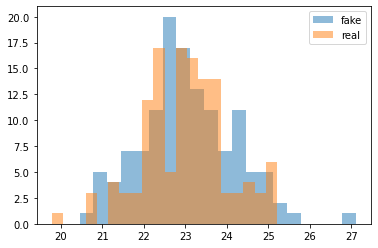

cum_dis_loss 0.2339468138217926, cum_gen_loss 0.2547572183609009


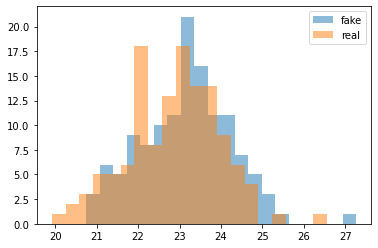

cum_dis_loss 0.22851259849965572, cum_gen_loss 0.24515504121780396


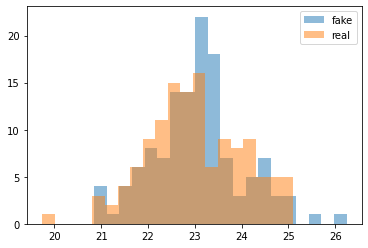

cum_dis_loss 0.24356748490035535, cum_gen_loss 0.2520478205382824


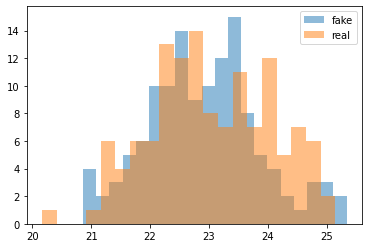

cum_dis_loss 0.23224322210252285, cum_gen_loss 0.25785390719771384


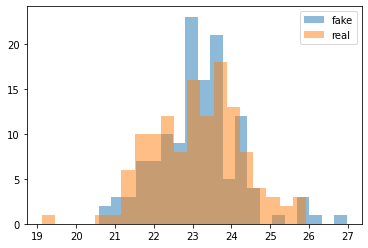

cum_dis_loss 0.23052135625481607, cum_gen_loss 0.23963287860155105


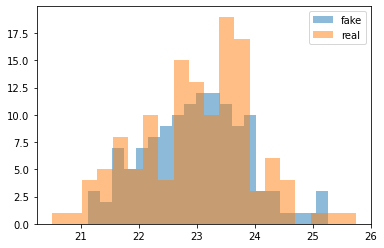

cum_dis_loss 0.23161854323744774, cum_gen_loss 0.24170705303549767


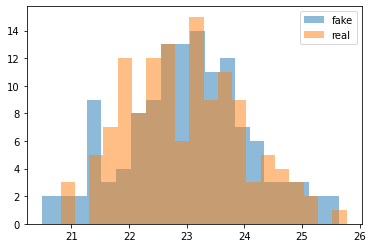

cum_dis_loss 0.22355933336913586, cum_gen_loss 0.248354035615921


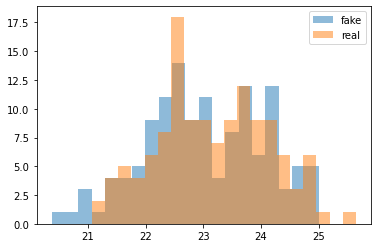

cum_dis_loss 0.23700269129872323, cum_gen_loss 0.25253731161355975


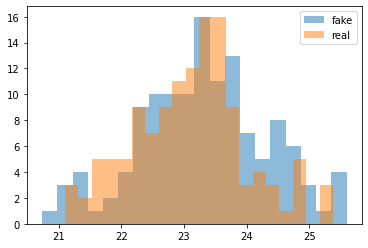

cum_dis_loss 0.2338913648277521, cum_gen_loss 0.24600228771567345


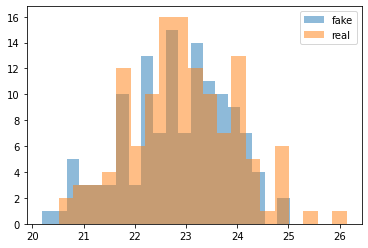

cum_dis_loss 0.2378258567750454, cum_gen_loss 0.24881948679685592


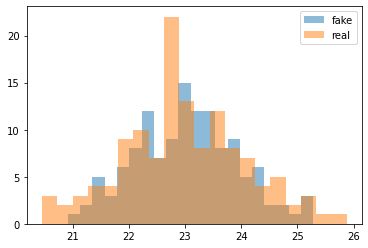

cum_dis_loss 0.23461194390058518, cum_gen_loss 0.24681128859519957


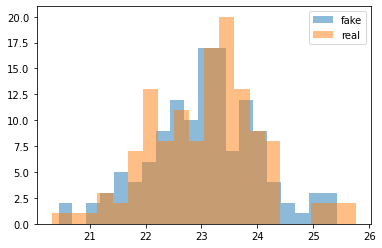

cum_dis_loss 0.2382011251449585, cum_gen_loss 0.2525725504755974


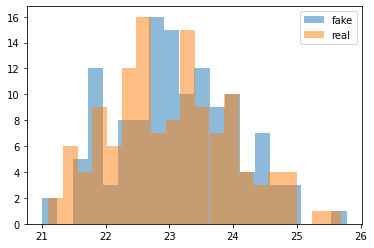

cum_dis_loss 0.2302188409715891, cum_gen_loss 0.25375086545944214


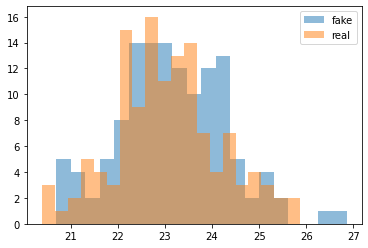

cum_dis_loss 0.2380827171355486, cum_gen_loss 0.24822050109505653


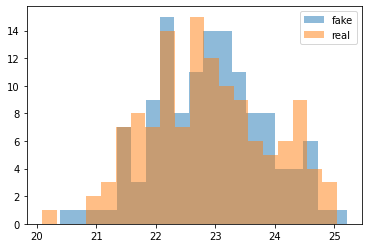

cum_dis_loss 0.2331886944025755, cum_gen_loss 0.2554060524702072


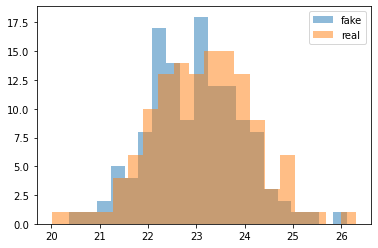

cum_dis_loss 0.22986218039691447, cum_gen_loss 0.2517347832024097


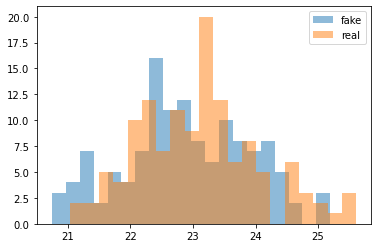

cum_dis_loss 0.22966439087688922, cum_gen_loss 0.24619820907711984


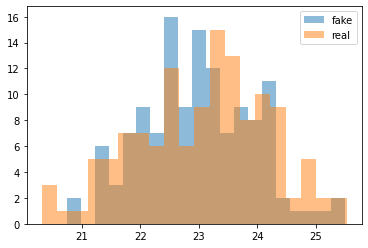

cum_dis_loss 0.23019893530011176, cum_gen_loss 0.2526725347340107


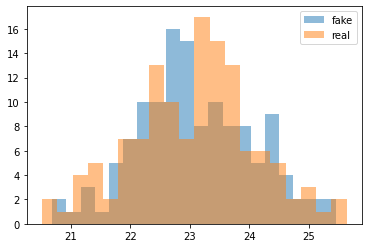

cum_dis_loss 0.24367184454202653, cum_gen_loss 0.24468125611543656


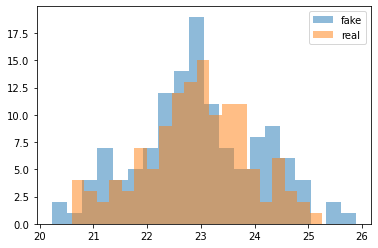

cum_dis_loss 0.2337125184237957, cum_gen_loss 0.254765902608633


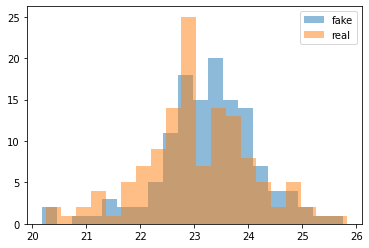

cum_dis_loss 0.24039668104052545, cum_gen_loss 0.25376130878925324


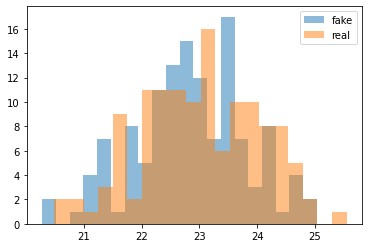

cum_dis_loss 0.23428634858131409, cum_gen_loss 0.2507874548435211


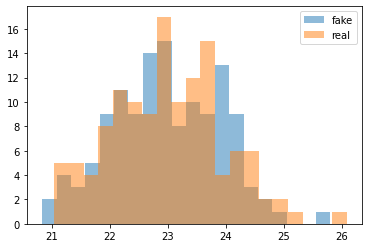

cum_dis_loss 0.23348227214813233, cum_gen_loss 0.24895307764410973


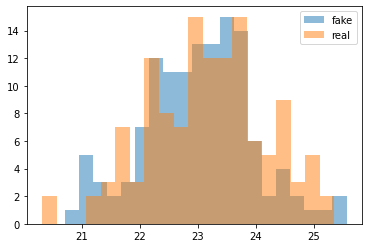

cum_dis_loss 0.2320627119243145, cum_gen_loss 0.2470259629189968


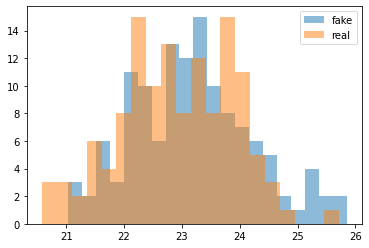

cum_dis_loss 0.23085687750577927, cum_gen_loss 0.25076241075992584


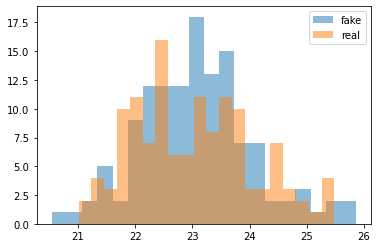

cum_dis_loss 0.2392451141923666, cum_gen_loss 0.25001780658960343


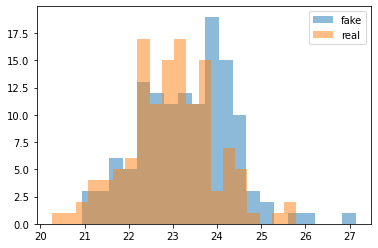

cum_dis_loss 0.23587985044717788, cum_gen_loss 0.24817062452435493


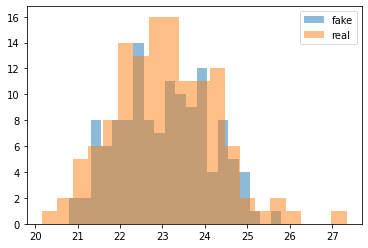

cum_dis_loss 0.23185515965521336, cum_gen_loss 0.2414753383398056


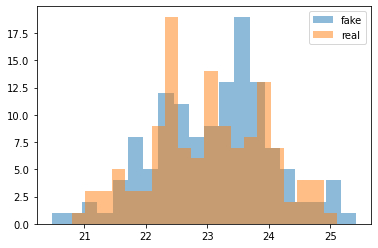

cum_dis_loss 0.2398796304911375, cum_gen_loss 0.25866451248526573


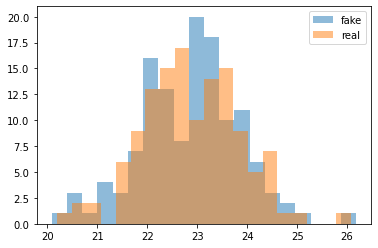

cum_dis_loss 0.23546902157366276, cum_gen_loss 0.25170878916978834


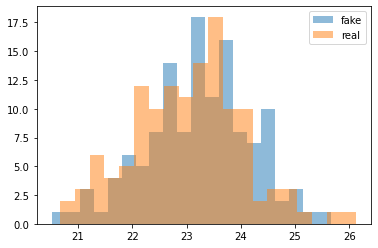

cum_dis_loss 0.24324288561940194, cum_gen_loss 0.2572127997875214


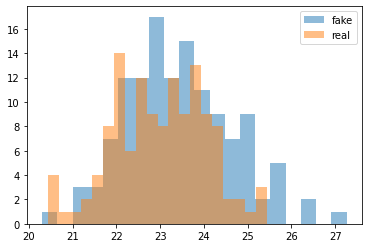

cum_dis_loss 0.2470173395574093, cum_gen_loss 0.2573071834445


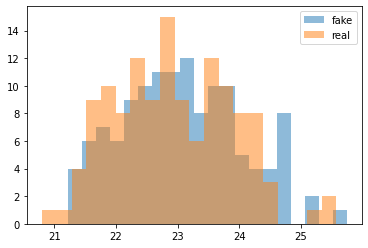

cum_dis_loss 0.2444597101062536, cum_gen_loss 0.2546412168443203


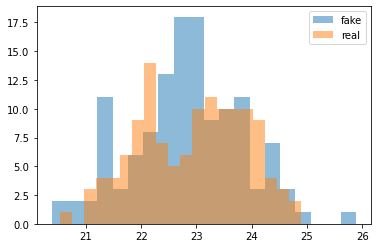

cum_dis_loss 0.235562632471323, cum_gen_loss 0.2552423536777496


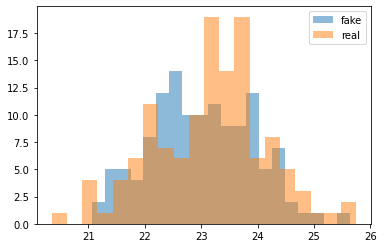

cum_dis_loss 0.23767855653166772, cum_gen_loss 0.2520406658947468


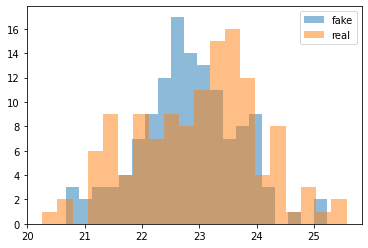

cum_dis_loss 0.23545832493901253, cum_gen_loss 0.25773066774010656


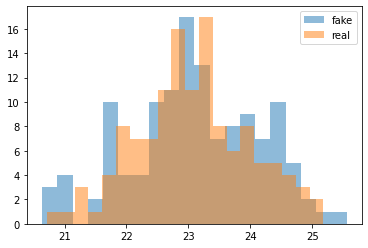

cum_dis_loss 0.24369162602722644, cum_gen_loss 0.2572033666074276


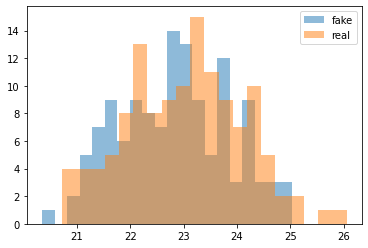

cum_dis_loss 0.23872444947063923, cum_gen_loss 0.2517922654747963


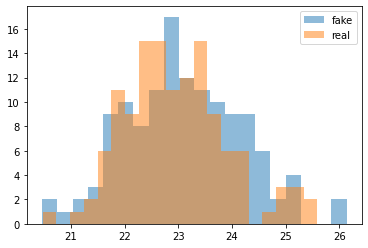

cum_dis_loss 0.2430467494726181, cum_gen_loss 0.259861790984869


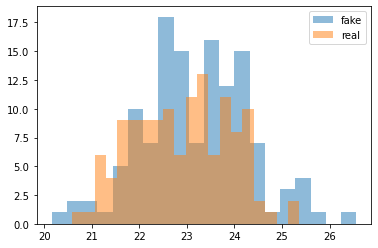

cum_dis_loss 0.24222078830003738, cum_gen_loss 0.256810889840126


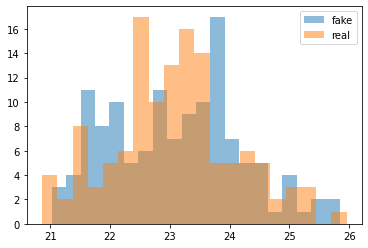

cum_dis_loss 0.2449206666201353, cum_gen_loss 0.2560955107212067


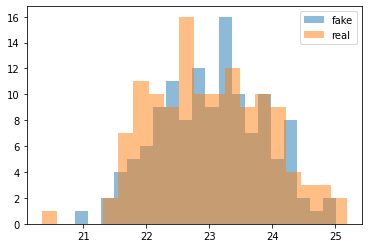

cum_dis_loss 0.23173161789774896, cum_gen_loss 0.25441343322396276


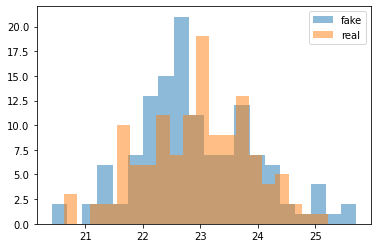

cum_dis_loss 0.2435730882138014, cum_gen_loss 0.24621620804071426


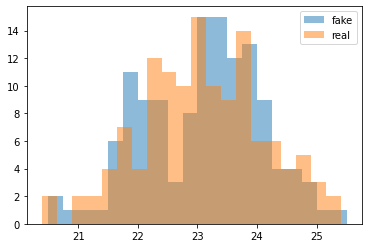

cum_dis_loss 0.23904442377388477, cum_gen_loss 0.24592271998524665


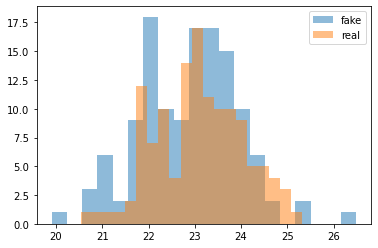

cum_dis_loss 0.24084247170388698, cum_gen_loss 0.2607418289780617


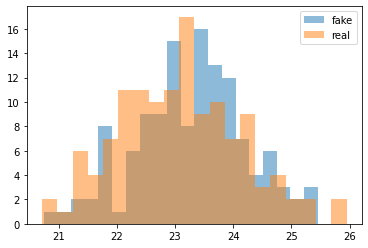

cum_dis_loss 0.24474160930514335, cum_gen_loss 0.250791152715683


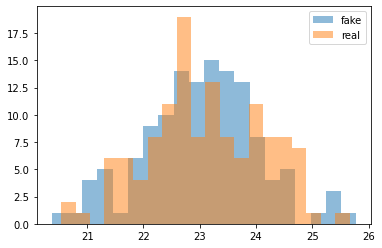

cum_dis_loss 0.2445457179993391, cum_gen_loss 0.24952295273542405


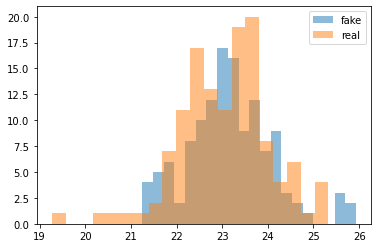

cum_dis_loss 0.2403102294355631, cum_gen_loss 0.2536760503053665


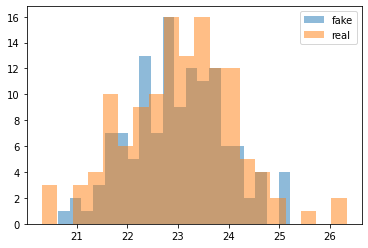

cum_dis_loss 0.23853477807343007, cum_gen_loss 0.2528269137442112


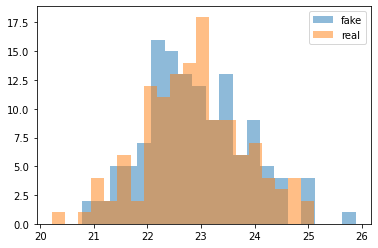

cum_dis_loss 0.23755151018500328, cum_gen_loss 0.26013867303729055


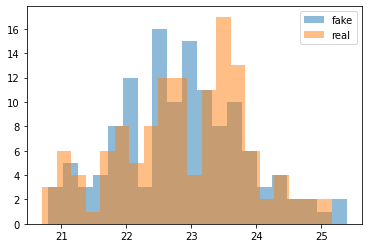

cum_dis_loss 0.24599414992332458, cum_gen_loss 0.26431286334991455


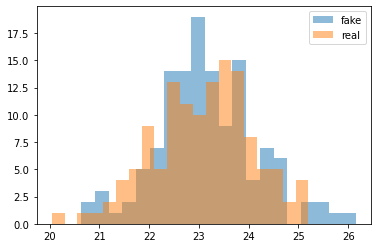

cum_dis_loss 0.23882682017982007, cum_gen_loss 0.2529323759675026


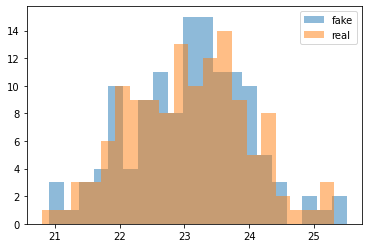

cum_dis_loss 0.24355268809199332, cum_gen_loss 0.2505761760473251


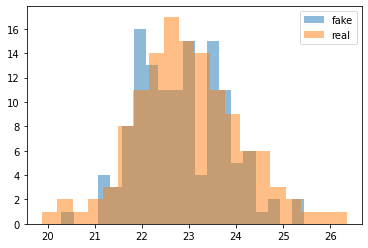

cum_dis_loss 0.24371207718551158, cum_gen_loss 0.25560983791947367


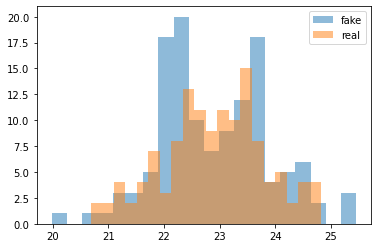

cum_dis_loss 0.24547179923951626, cum_gen_loss 0.25172090202569963


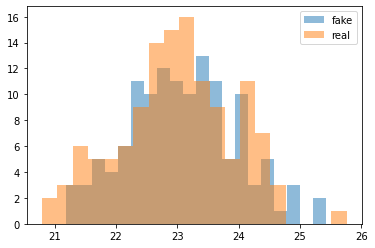

cum_dis_loss 0.2478049557954073, cum_gen_loss 0.24685797482728958


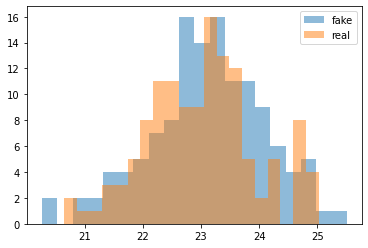

cum_dis_loss 0.23908426858484744, cum_gen_loss 0.25010368674993516


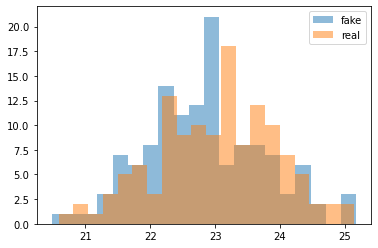

cum_dis_loss 0.24349706260859966, cum_gen_loss 0.2485920162498951


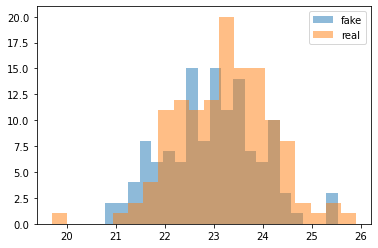

cum_dis_loss 0.238494747787714, cum_gen_loss 0.2546492433547974


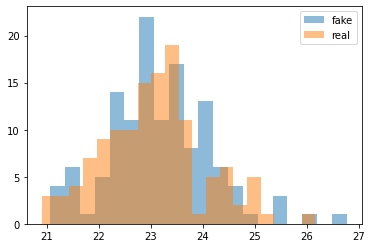

cum_dis_loss 0.23847162027657032, cum_gen_loss 0.25567404821515083


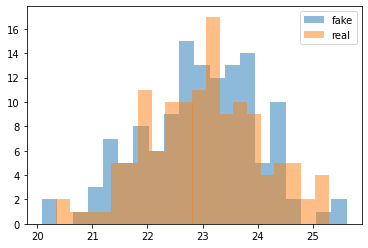

cum_dis_loss 0.2474155496954918, cum_gen_loss 0.24807984948158265


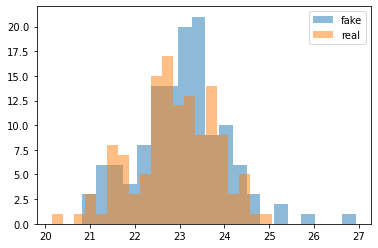

cum_dis_loss 0.23886182737350464, cum_gen_loss 0.2458662337064743


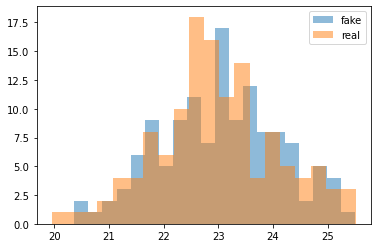

cum_dis_loss 0.24035745085775853, cum_gen_loss 0.2562618534266949


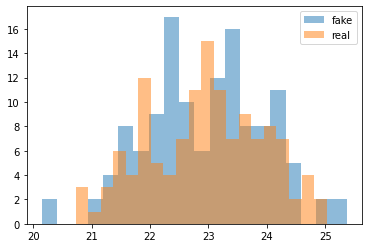

cum_dis_loss 0.2426747002005577, cum_gen_loss 0.256738710552454


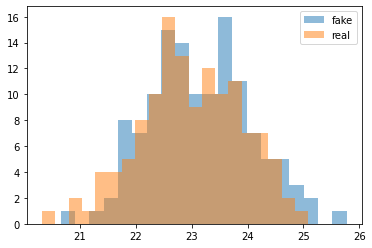

cum_dis_loss 0.2442815689742565, cum_gen_loss 0.2552224850654602


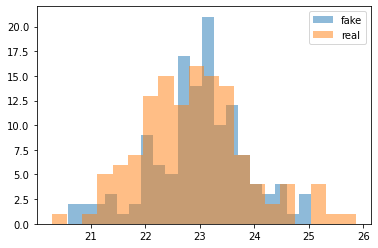

cum_dis_loss 0.23662582214176656, cum_gen_loss 0.2585200935602188


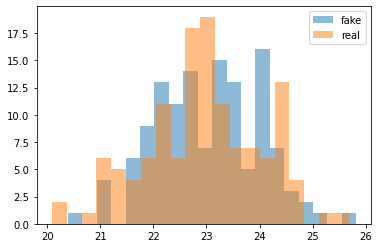

cum_dis_loss 0.2432759481072426, cum_gen_loss 0.24542027652263643


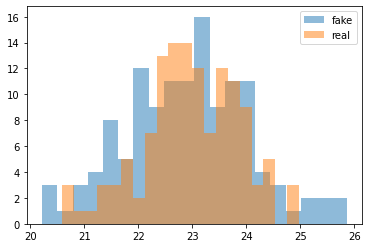

cum_dis_loss 0.23675969284772874, cum_gen_loss 0.2549293088912964


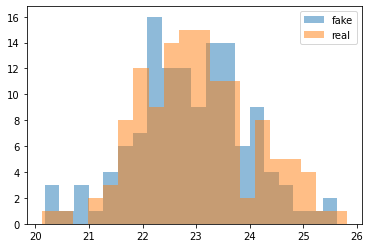

cum_dis_loss 0.2421807623654604, cum_gen_loss 0.254966531842947


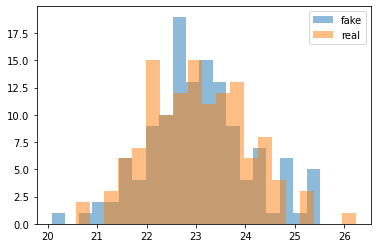

cum_dis_loss 0.24639351645112037, cum_gen_loss 0.2506986217200756


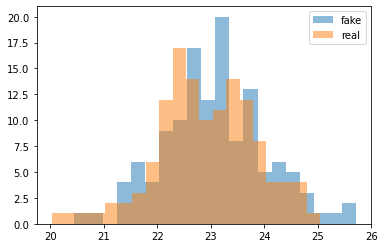

cum_dis_loss 0.2484749122709036, cum_gen_loss 0.2532123236358166


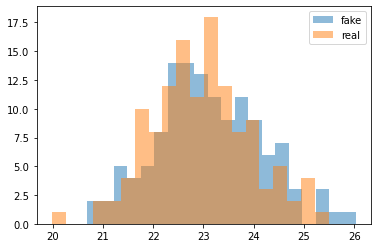

cum_dis_loss 0.25158444526791574, cum_gen_loss 0.25052863761782646


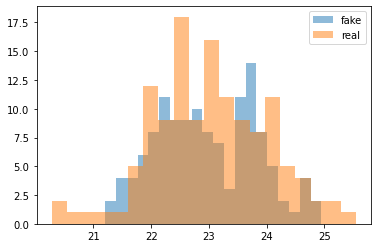

cum_dis_loss 0.25106345710158345, cum_gen_loss 0.2532599051296711


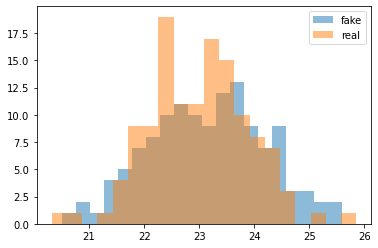

cum_dis_loss 0.24516691967844964, cum_gen_loss 0.24582056134939193


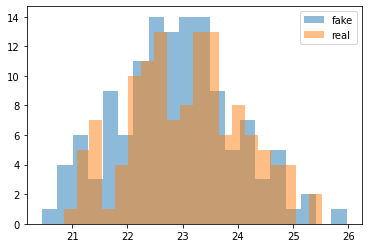

cum_dis_loss 0.24017004373669623, cum_gen_loss 0.2510060289502144


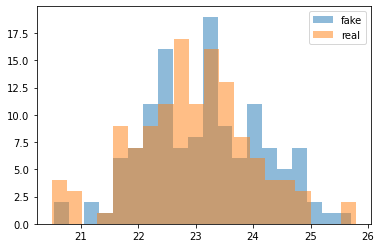

cum_dis_loss 0.24055956655740737, cum_gen_loss 0.2501720441877842


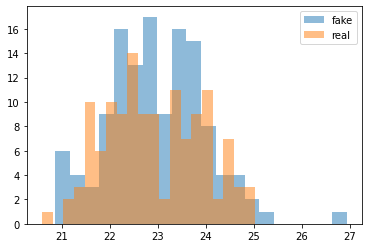

cum_dis_loss 0.2520044994354248, cum_gen_loss 0.255117439776659


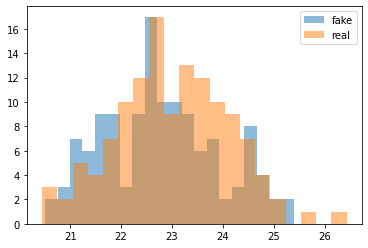

cum_dis_loss 0.2518309391885996, cum_gen_loss 0.26731459975242616


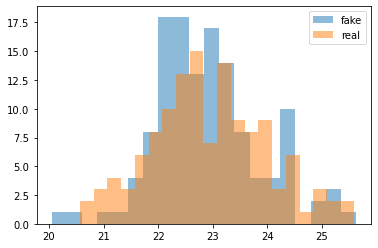

cum_dis_loss 0.25432422225177287, cum_gen_loss 0.2660246112942696


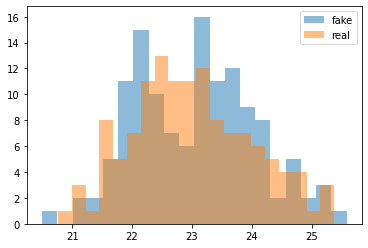

cum_dis_loss 0.24689936009049415, cum_gen_loss 0.2640324804186821


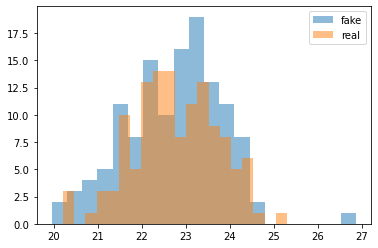

cum_dis_loss 0.2403244527578354, cum_gen_loss 0.253672294318676


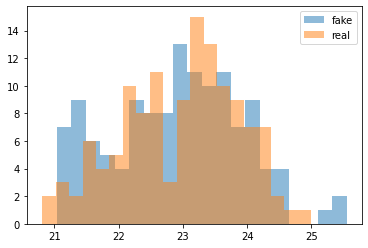

cum_dis_loss 0.23849159932136535, cum_gen_loss 0.254304313659668


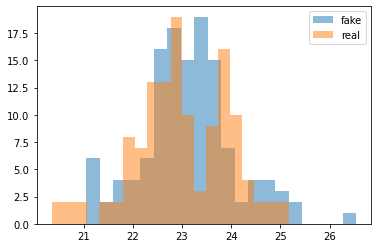

cum_dis_loss 0.24744131171703337, cum_gen_loss 0.24656412333250047


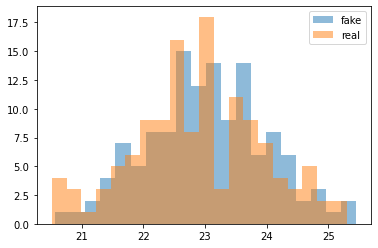

cum_dis_loss 0.24897952973842621, cum_gen_loss 0.25176617994904515


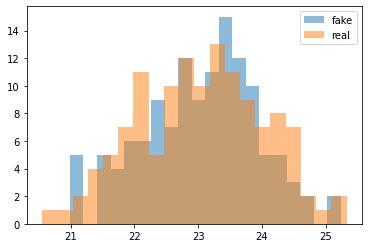

cum_dis_loss 0.24983002641797067, cum_gen_loss 0.26579016804695127


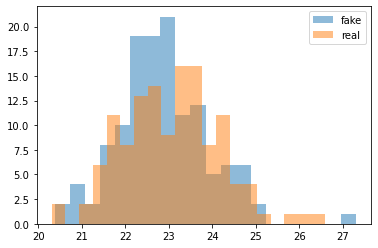

cum_dis_loss 0.24332200483977795, cum_gen_loss 0.25207934111356733


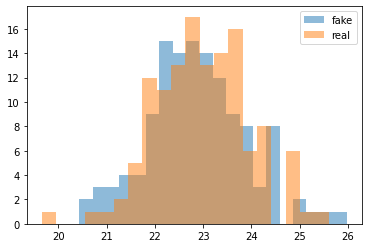

cum_dis_loss 0.2487377431243658, cum_gen_loss 0.25253271237015723


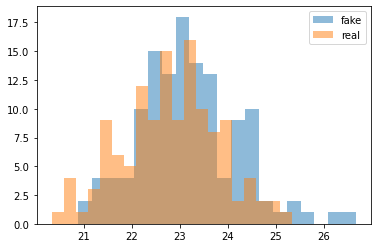

cum_dis_loss 0.2358128395974636, cum_gen_loss 0.24478286236524582


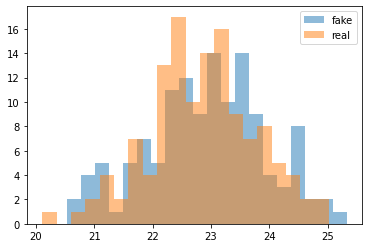

cum_dis_loss 0.25155535876750945, cum_gen_loss 0.2601781216263771


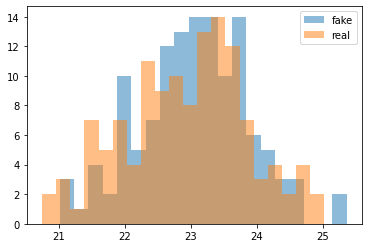

cum_dis_loss 0.242954276740551, cum_gen_loss 0.2527310851216316


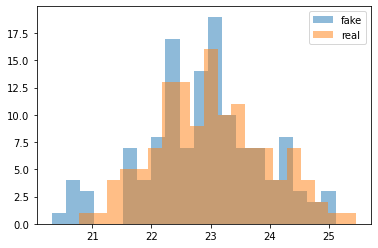

cum_dis_loss 0.24595215889811517, cum_gen_loss 0.2562137804925442


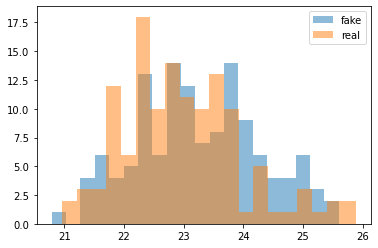

cum_dis_loss 0.23554900628328324, cum_gen_loss 0.2610354483127594


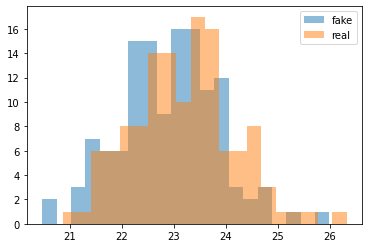

cum_dis_loss 0.24694450491666795, cum_gen_loss 0.2566161119937897


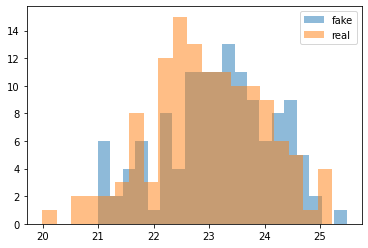

cum_dis_loss 0.24277991431951523, cum_gen_loss 0.2687644045054913


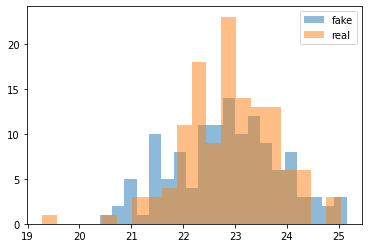

cum_dis_loss 0.25162401297688486, cum_gen_loss 0.2551970835030079


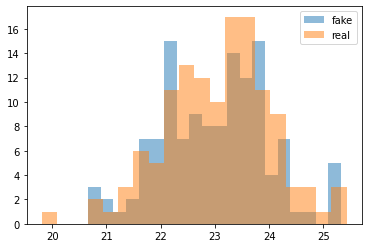

cum_dis_loss 0.25245230405032637, cum_gen_loss 0.25290318876504897


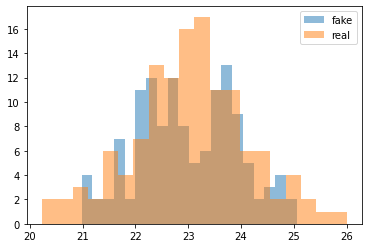

cum_dis_loss 0.24456619474291802, cum_gen_loss 0.2539554661512375


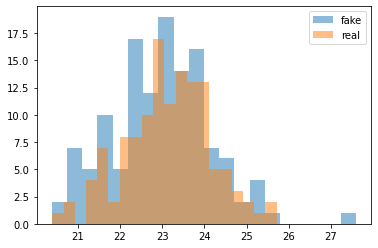

cum_dis_loss 0.24871932157874108, cum_gen_loss 0.2577133268117905


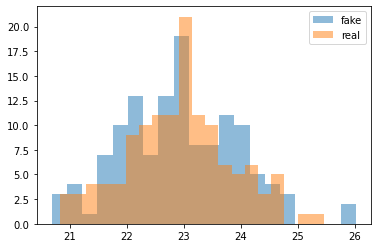

cum_dis_loss 0.24332187712192535, cum_gen_loss 0.2560682973265648


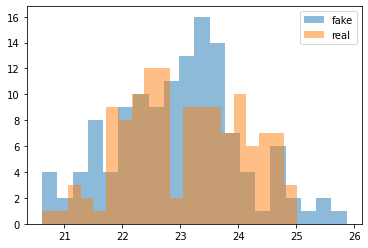

cum_dis_loss 0.24940747825801374, cum_gen_loss 0.2580707877874374


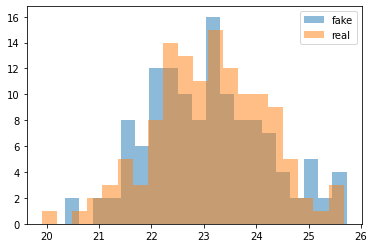

cum_dis_loss 0.24345877818763256, cum_gen_loss 0.2555201154947281


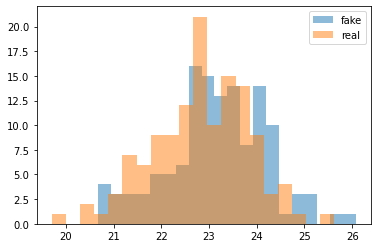

cum_dis_loss 0.25152749958634374, cum_gen_loss 0.26094690516591074


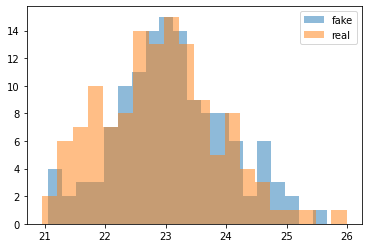

cum_dis_loss 0.25373757986724377, cum_gen_loss 0.2533450013399124


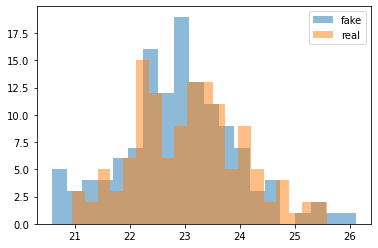

cum_dis_loss 0.24434990802407264, cum_gen_loss 0.24820640981197356


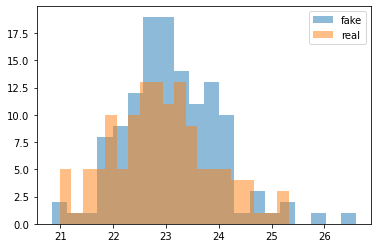

cum_dis_loss 0.2560542423427105, cum_gen_loss 0.2507629641890526


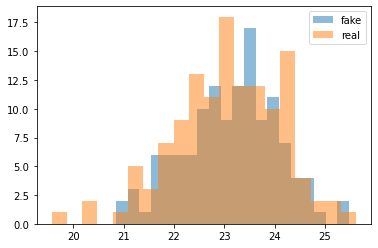

cum_dis_loss 0.24508118703961373, cum_gen_loss 0.2508012901246548


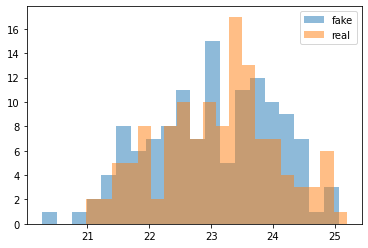

cum_dis_loss 0.25194024699926376, cum_gen_loss 0.2580918833613396


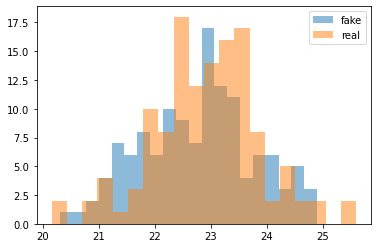

cum_dis_loss 0.24697072015702726, cum_gen_loss 0.2520598265528679


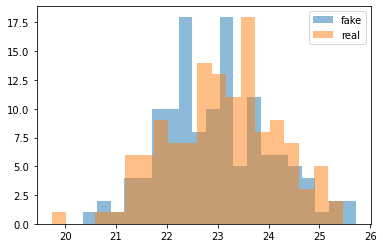

cum_dis_loss 0.24697203281521798, cum_gen_loss 0.2611897437274456


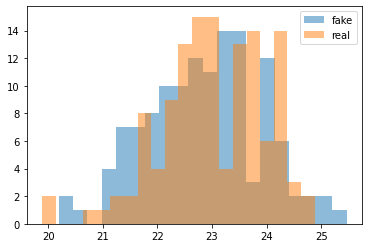

cum_dis_loss 0.24876963317394257, cum_gen_loss 0.24861809730529785


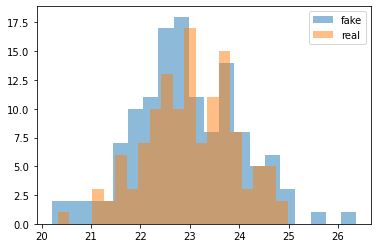

cum_dis_loss 0.25068706113100053, cum_gen_loss 0.2614502921700478


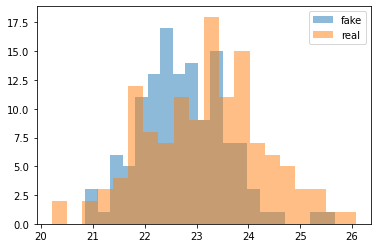

cum_dis_loss 0.25475966373085973, cum_gen_loss 0.26003382563591004


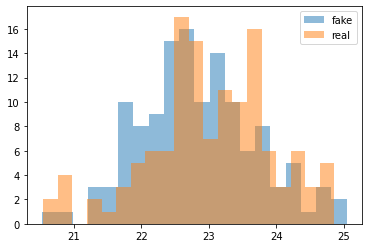

cum_dis_loss 0.24573918716609477, cum_gen_loss 0.2593777385354042


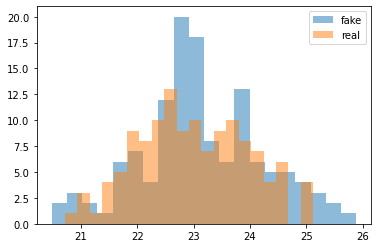

cum_dis_loss 0.25280530977249144, cum_gen_loss 0.2593259207904339


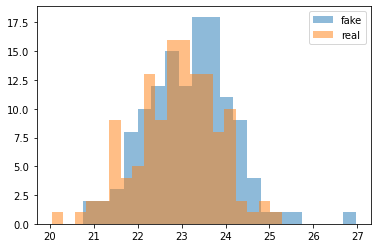

cum_dis_loss 0.2518448716700077, cum_gen_loss 0.269873998016119


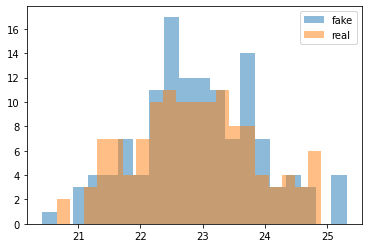

cum_dis_loss 0.24944923728704452, cum_gen_loss 0.2557307843863964


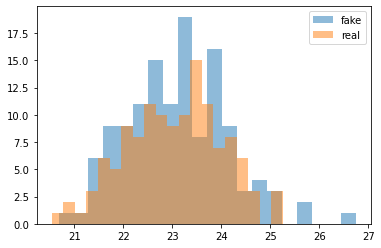

cum_dis_loss 0.24388182106614112, cum_gen_loss 0.2542830137908459


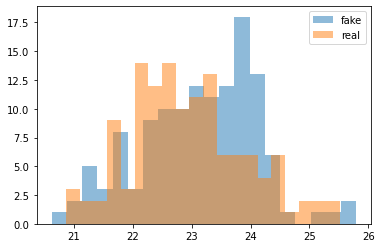

cum_dis_loss 0.25588205775618555, cum_gen_loss 0.2539859092235565


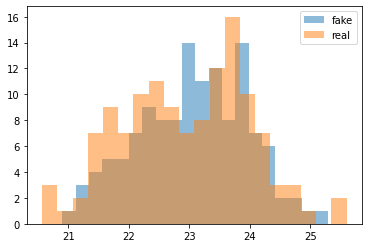

cum_dis_loss 0.2449827918410301, cum_gen_loss 0.25183103397488593


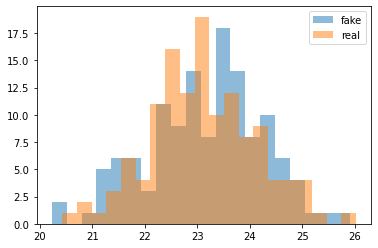

cum_dis_loss 0.25241125401854514, cum_gen_loss 0.2546225945651531


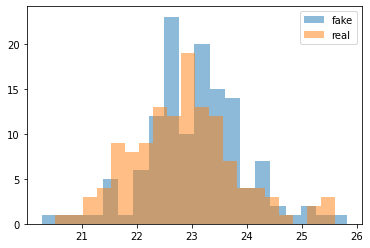

cum_dis_loss 0.23990737718343735, cum_gen_loss 0.2624821721017361


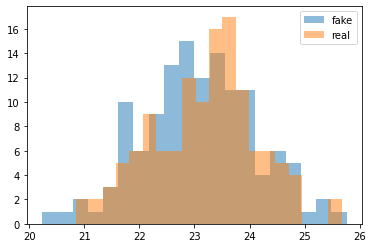

cum_dis_loss 0.25691525408625604, cum_gen_loss 0.25760209783911703


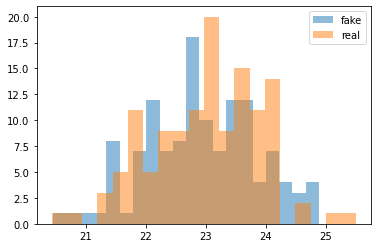

cum_dis_loss 0.24335979154706, cum_gen_loss 0.25883173912763596


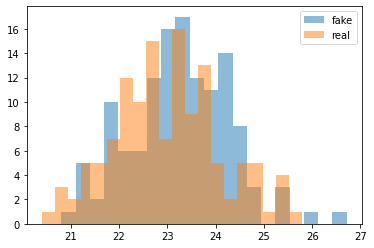

cum_dis_loss 0.2451946938931942, cum_gen_loss 0.24249296337366105


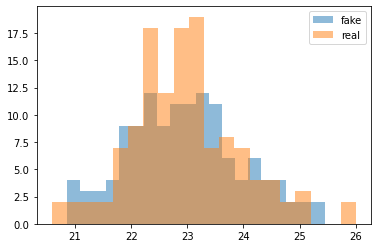

cum_dis_loss 0.2517447902560234, cum_gen_loss 0.2554205760359764


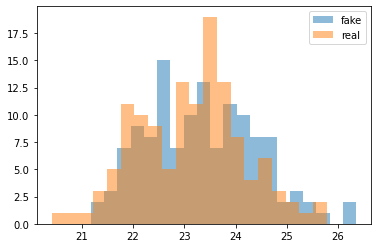

cum_dis_loss 0.24603462164103984, cum_gen_loss 0.26129424437880516


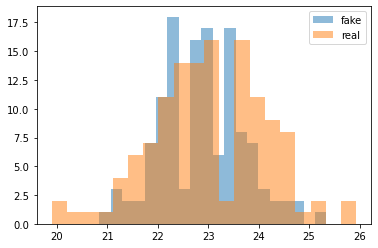

cum_dis_loss 0.24620052167773246, cum_gen_loss 0.25542444676160814


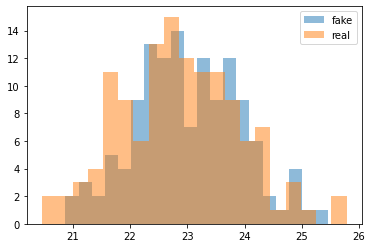

cum_dis_loss 0.24960072800517083, cum_gen_loss 0.2548626647889614


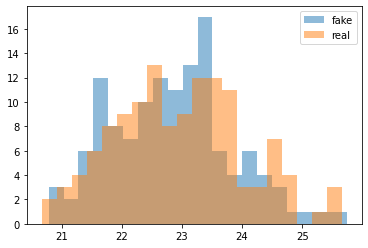

cum_dis_loss 0.2520433774590492, cum_gen_loss 0.25583877801895144


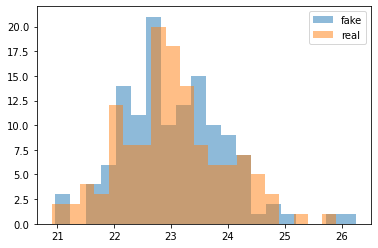

cum_dis_loss 0.25159463623166084, cum_gen_loss 0.2608247521519661


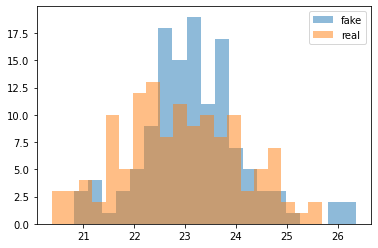

cum_dis_loss 0.2510170652121305, cum_gen_loss 0.25651226729154586


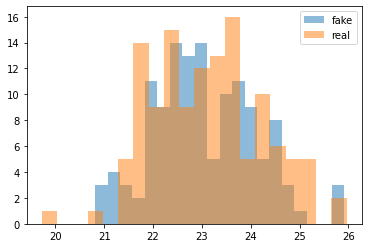

cum_dis_loss 0.25160649690032005, cum_gen_loss 0.25581512778997423


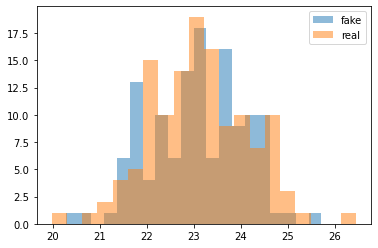

cum_dis_loss 0.25041819033026697, cum_gen_loss 0.25620160743594167


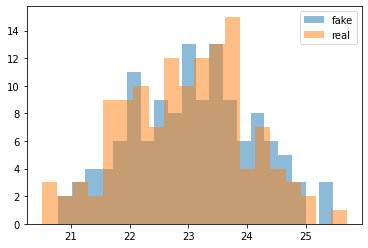

cum_dis_loss 0.24286915436387063, cum_gen_loss 0.267354926019907


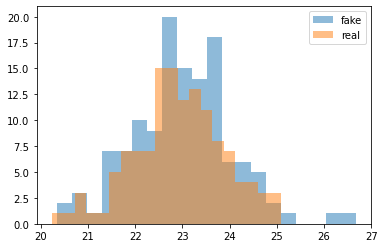

cum_dis_loss 0.26034065622091296, cum_gen_loss 0.25885705441236495


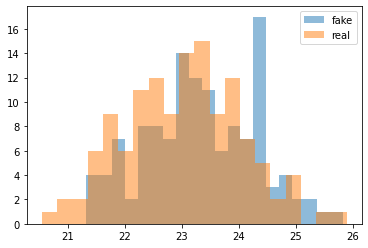

cum_dis_loss 0.2463801189213991, cum_gen_loss 0.26149674266576767


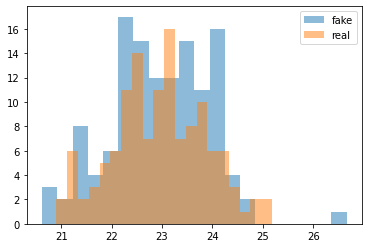

cum_dis_loss 0.25258638717234133, cum_gen_loss 0.26702578336000443


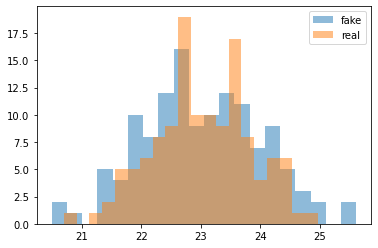

cum_dis_loss 0.24617745415866374, cum_gen_loss 0.2595521880686283


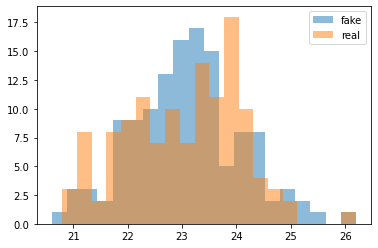

cum_dis_loss 0.25808183807134627, cum_gen_loss 0.2698353399336338


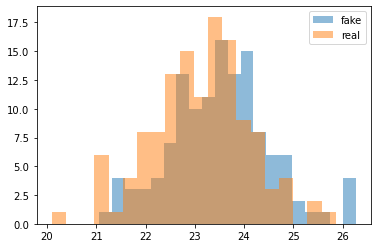

cum_dis_loss 0.2497236442565918, cum_gen_loss 0.25730096161365507


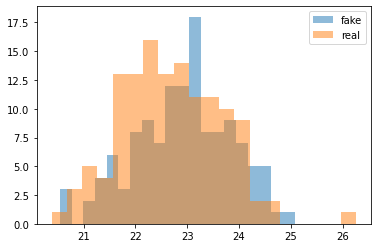

cum_dis_loss 0.24517749844491482, cum_gen_loss 0.26121778711676596


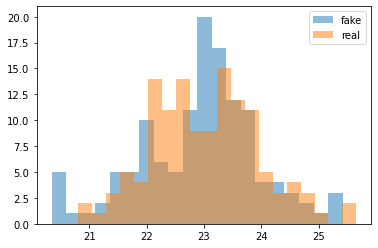

cum_dis_loss 0.25150109669566156, cum_gen_loss 0.2541592328250408


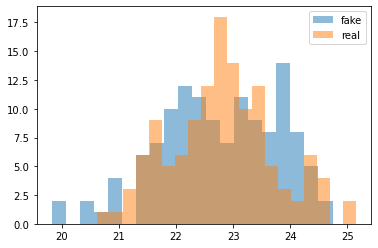

cum_dis_loss 0.2538870500177145, cum_gen_loss 0.26016646102070806


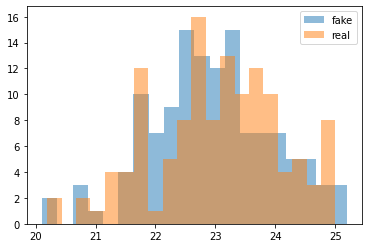

cum_dis_loss 0.24871408258378505, cum_gen_loss 0.2550933513045311


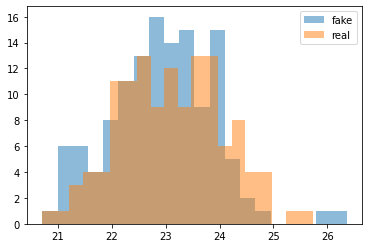

cum_dis_loss 0.25411376322805884, cum_gen_loss 0.25808138608932496


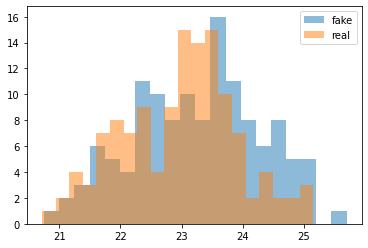

cum_dis_loss 0.2642165079116821, cum_gen_loss 0.272916152626276


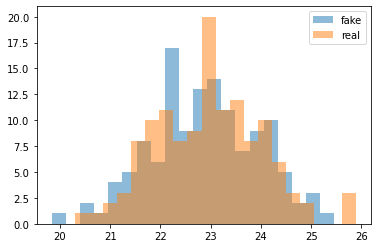

cum_dis_loss 0.2565555658042431, cum_gen_loss 0.2642841424047947


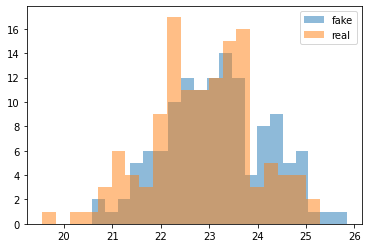

cum_dis_loss 0.2559051569998264, cum_gen_loss 0.2586858458817005


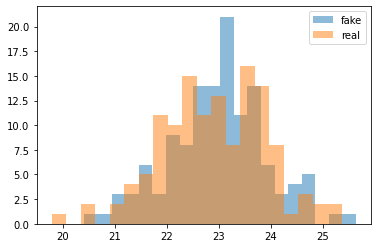

cum_dis_loss 0.24899754472076893, cum_gen_loss 0.2635917441546917


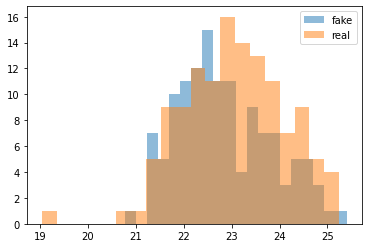

cum_dis_loss 0.25375369676947596, cum_gen_loss 0.2573812147974968


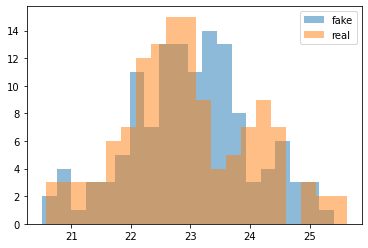

cum_dis_loss 0.25367291969060896, cum_gen_loss 0.25750333532691


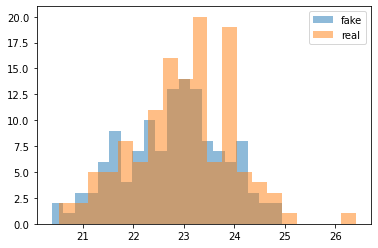

cum_dis_loss 0.25213961087167264, cum_gen_loss 0.2579959274828434


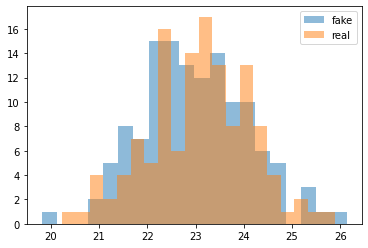

cum_dis_loss 0.255365034237504, cum_gen_loss 0.2635433912277222


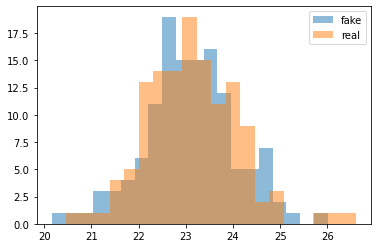

cum_dis_loss 0.2548610309064388, cum_gen_loss 0.2671885171532631


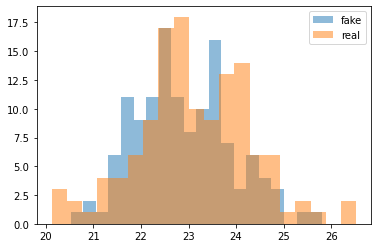

cum_dis_loss 0.25514610221982004, cum_gen_loss 0.26396330624818803


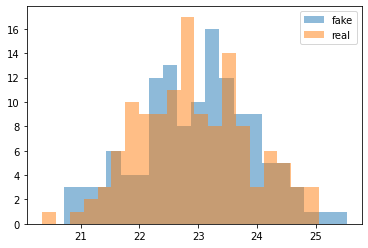

cum_dis_loss 0.24972441771626472, cum_gen_loss 0.26142705500125885


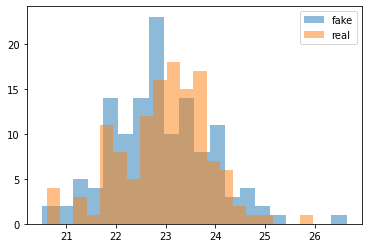

cum_dis_loss 0.24617584803700446, cum_gen_loss 0.26323995292186736


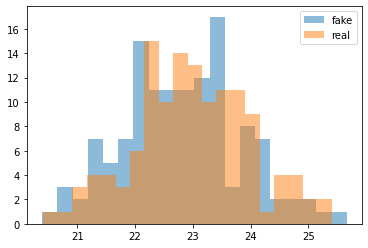

cum_dis_loss 0.2524025139808655, cum_gen_loss 0.2644678595662117


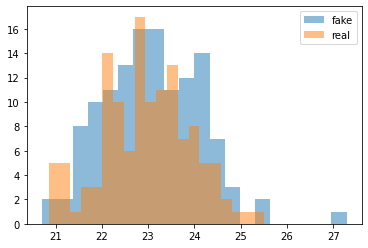

cum_dis_loss 0.2603032797574997, cum_gen_loss 0.25794583216309547


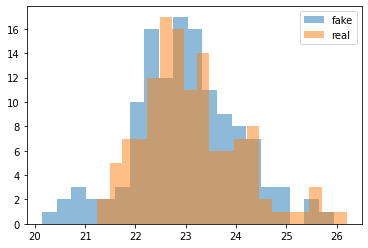

cum_dis_loss 0.25604085575044155, cum_gen_loss 0.2630504977703094


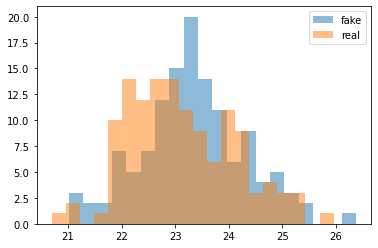

cum_dis_loss 0.25379440730810165, cum_gen_loss 0.2604773913323879


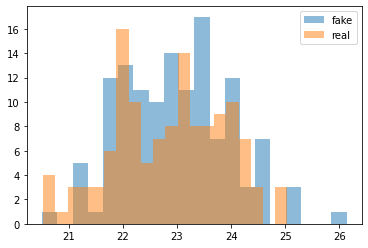

cum_dis_loss 0.2535722286403179, cum_gen_loss 0.2516555659472942


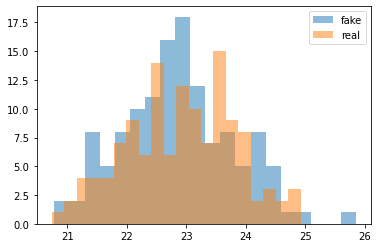

cum_dis_loss 0.2500846108496189, cum_gen_loss 0.2578533194959164


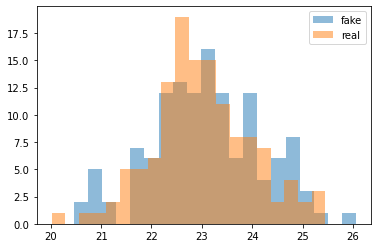

cum_dis_loss 0.25258794423937797, cum_gen_loss 0.266119969189167


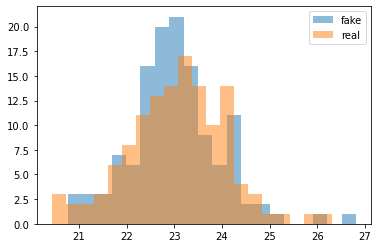

cum_dis_loss 0.2537423919737339, cum_gen_loss 0.25399707645177844


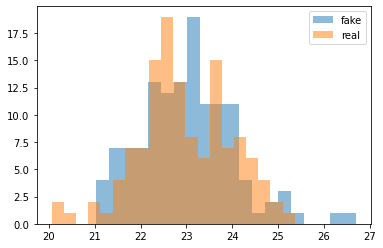

cum_dis_loss 0.2510091228634119, cum_gen_loss 0.2635342147946358


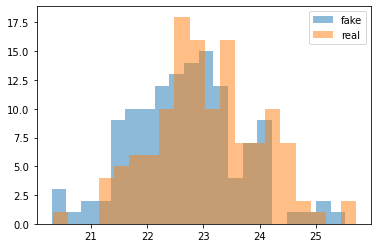

cum_dis_loss 0.2623137535750866, cum_gen_loss 0.26400016218423844


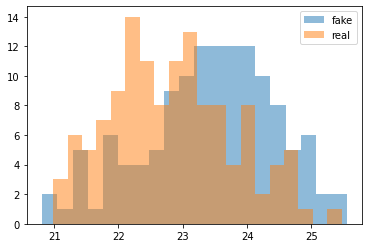

cum_dis_loss 0.2602858608663082, cum_gen_loss 0.2558353404700756


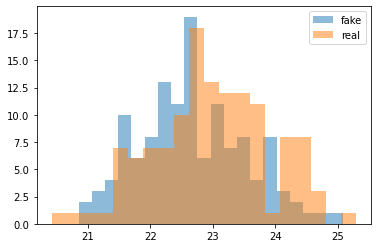

cum_dis_loss 0.2531462967395782, cum_gen_loss 0.25882314160466197


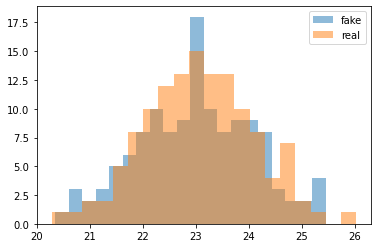

cum_dis_loss 0.2532206369638443, cum_gen_loss 0.2627884578704834


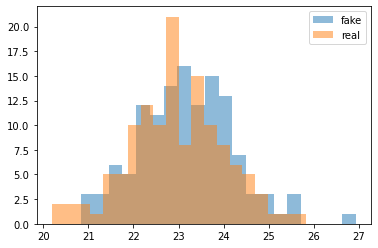

cum_dis_loss 0.25835376846790314, cum_gen_loss 0.25820038601756096


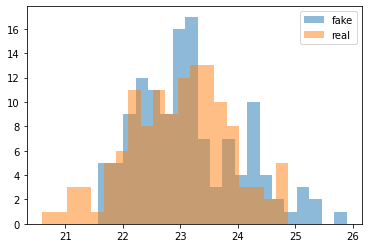

cum_dis_loss 0.2567236257493496, cum_gen_loss 0.2541576190292835


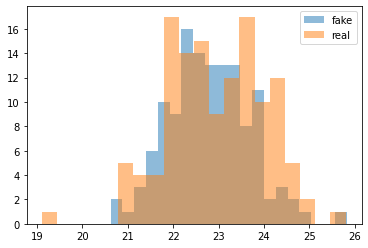

cum_dis_loss 0.2539990874230862, cum_gen_loss 0.2583466112613678


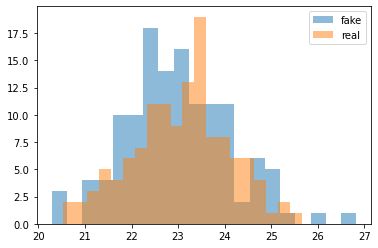

cum_dis_loss 0.25817453226447107, cum_gen_loss 0.2669504480063915


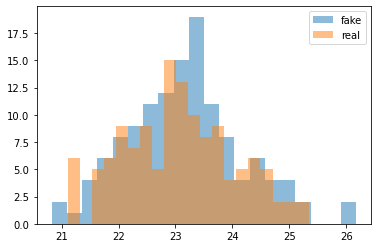

cum_dis_loss 0.24948337666690348, cum_gen_loss 0.26242256119847296


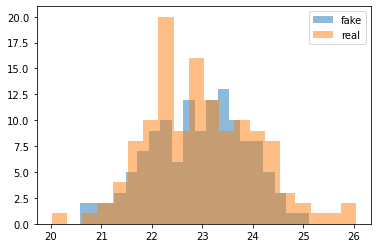

cum_dis_loss 0.24882319274544715, cum_gen_loss 0.25717211097478865


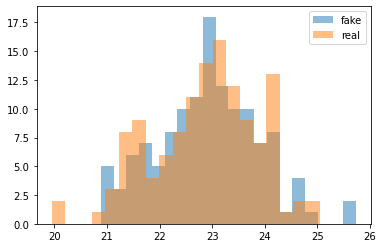

cum_dis_loss 0.2605016022920609, cum_gen_loss 0.25915751978755


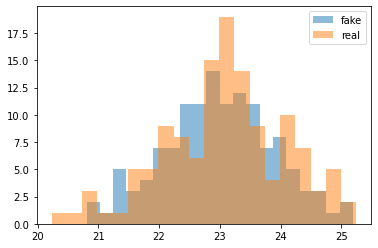

cum_dis_loss 0.2527476831972599, cum_gen_loss 0.2610695257782936


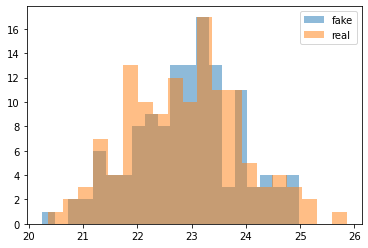

cum_dis_loss 0.2563559997677803, cum_gen_loss 0.2604192253947258


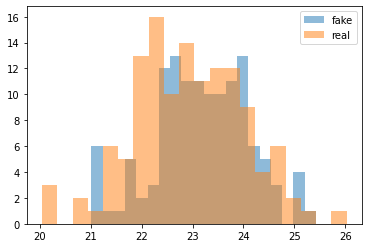

cum_dis_loss 0.260616152793169, cum_gen_loss 0.2684652219712734


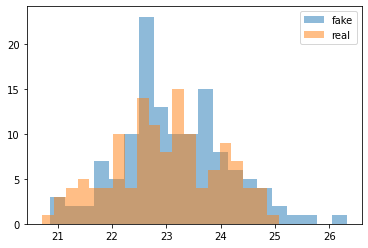

cum_dis_loss 0.2620050943940878, cum_gen_loss 0.2679490514099598


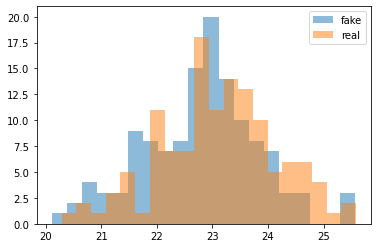

cum_dis_loss 0.2573097577691078, cum_gen_loss 0.25691759899258615


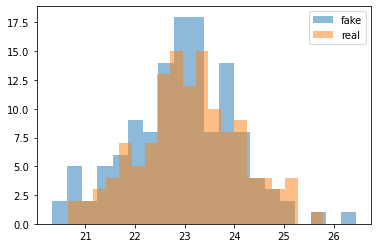

cum_dis_loss 0.24944265170395374, cum_gen_loss 0.2568415604531765


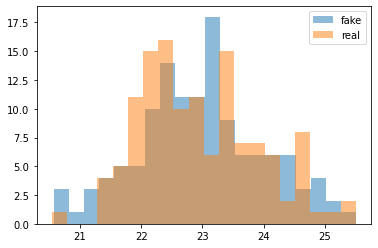

cum_dis_loss 0.26181573408842085, cum_gen_loss 0.26577340498566626


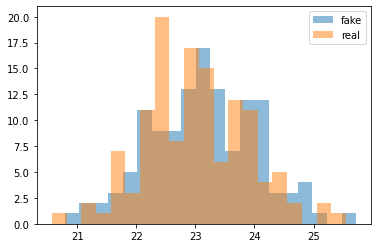

cum_dis_loss 0.2535606800466776, cum_gen_loss 0.2596920904517174


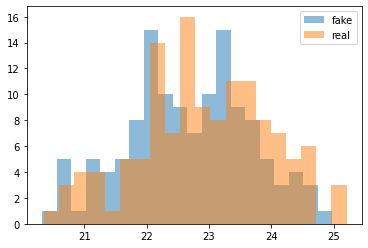

cum_dis_loss 0.25684950102865695, cum_gen_loss 0.2602433881163597


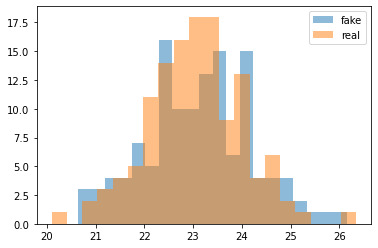

cum_dis_loss 0.2544445341527462, cum_gen_loss 0.26233050867915153


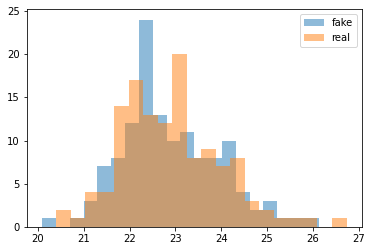

cum_dis_loss 0.2528308889865875, cum_gen_loss 0.26743360087275503


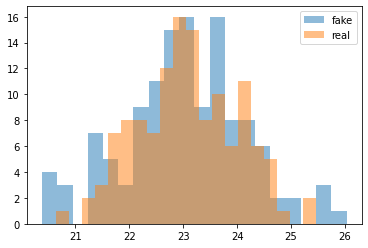

cum_dis_loss 0.25527198588848116, cum_gen_loss 0.2661619532108307


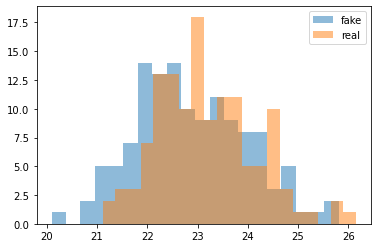

cum_dis_loss 0.2529308897405863, cum_gen_loss 0.26543975055217744


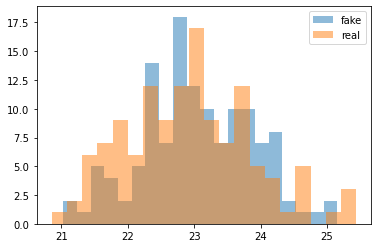

cum_dis_loss 0.2574662267714739, cum_gen_loss 0.2656775239109993


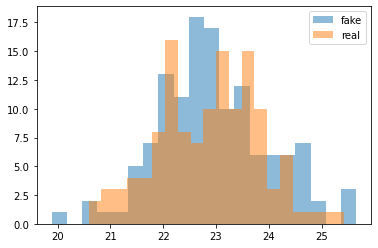

cum_dis_loss 0.2665850521326065, cum_gen_loss 0.25505293875932694


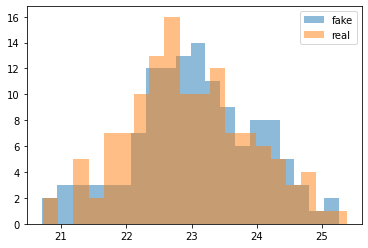

cum_dis_loss 0.2608803356289864, cum_gen_loss 0.26660809785127637


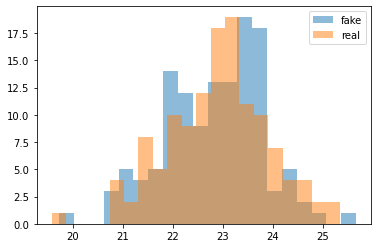

cum_dis_loss 0.2576895661652088, cum_gen_loss 0.26814544543623925


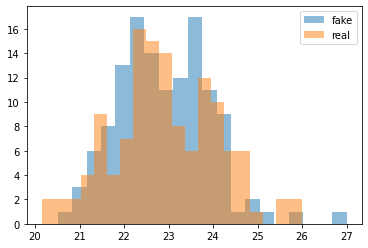

cum_dis_loss 0.2538317519426346, cum_gen_loss 0.26354162484407423


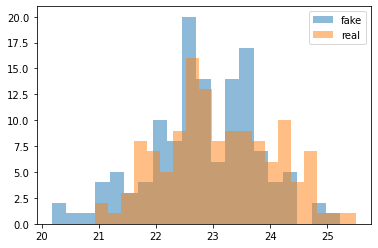

cum_dis_loss 0.25635569387674334, cum_gen_loss 0.26080151736736296


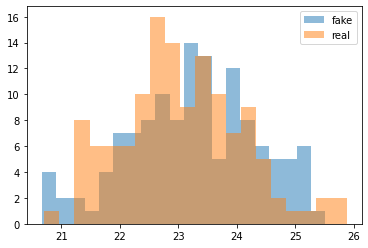

cum_dis_loss 0.254854149222374, cum_gen_loss 0.26567855790257455


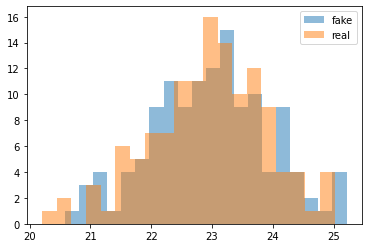

cum_dis_loss 0.2609311440587044, cum_gen_loss 0.2726732099056244


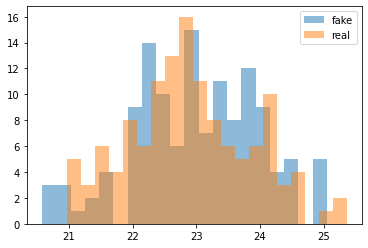

cum_dis_loss 0.2581969840377569, cum_gen_loss 0.2648567870259285


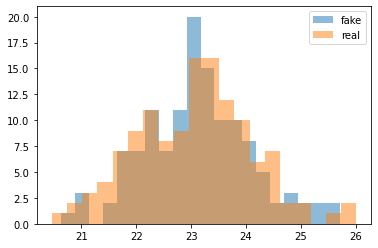

cum_dis_loss 0.2440871675312519, cum_gen_loss 0.2624719139933586


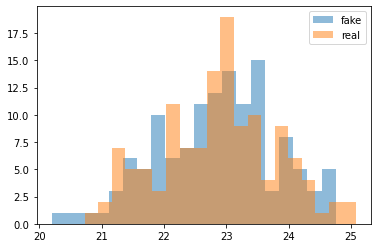

cum_dis_loss 0.25994410398602485, cum_gen_loss 0.2615586452186108


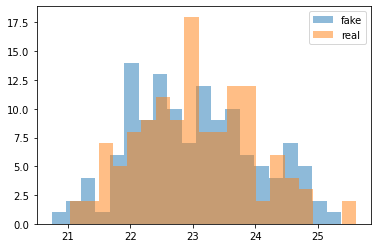

cum_dis_loss 0.25282874815165995, cum_gen_loss 0.2652948418259621


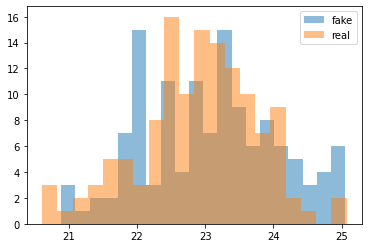

cum_dis_loss 0.2566792287826538, cum_gen_loss 0.2599921840429306


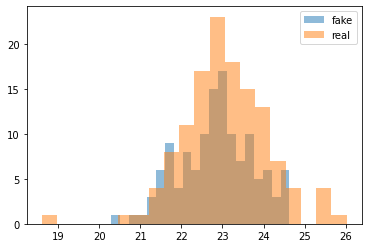

cum_dis_loss 0.2586315713375807, cum_gen_loss 0.2608459635078907


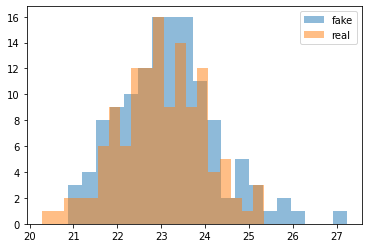

cum_dis_loss 0.25245051673054697, cum_gen_loss 0.2593902839720249


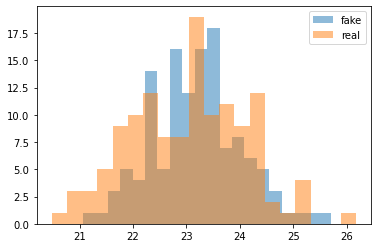

cum_dis_loss 0.25297993230819704, cum_gen_loss 0.2616010954976082


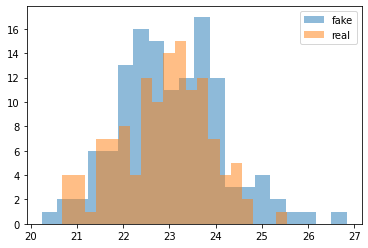

cum_dis_loss 0.2560973042547703, cum_gen_loss 0.2586973592638969


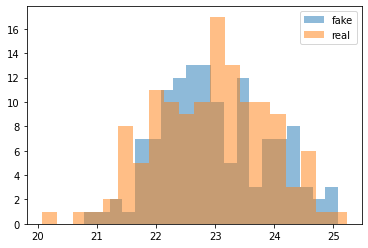

cum_dis_loss 0.2606221130490303, cum_gen_loss 0.2724072170257568


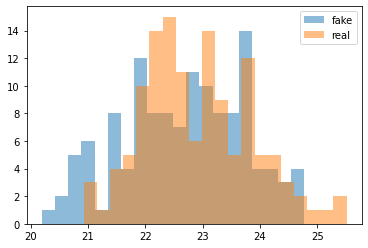

cum_dis_loss 0.2613209890127182, cum_gen_loss 0.2671180826425552


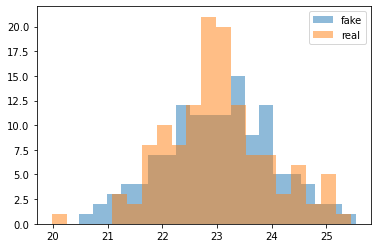

cum_dis_loss 0.2554109595716, cum_gen_loss 0.27112923756241797


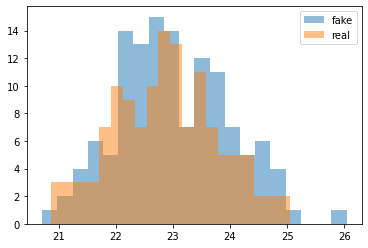

cum_dis_loss 0.25580553902685643, cum_gen_loss 0.26265138626098633


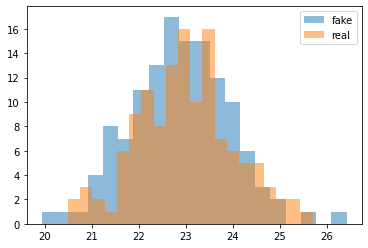

cum_dis_loss 0.25530797225236895, cum_gen_loss 0.2665583086013794


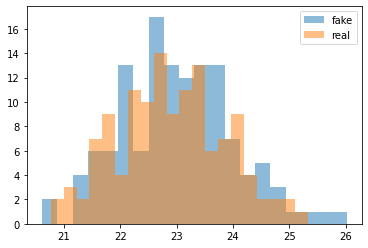

cum_dis_loss 0.2546981990635395, cum_gen_loss 0.2671965318918228


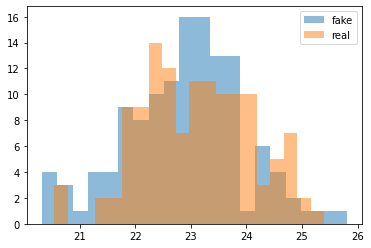

cum_dis_loss 0.2546223792731762, cum_gen_loss 0.2697777135670185


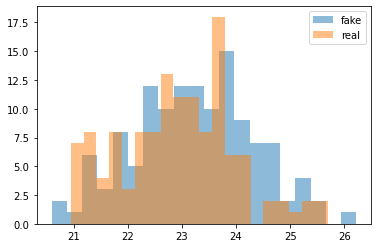

cum_dis_loss 0.2605695663690567, cum_gen_loss 0.26208089902997017


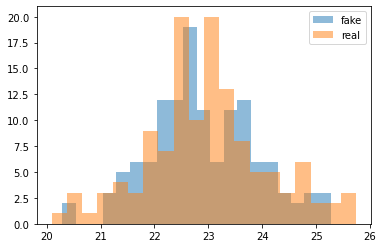

cum_dis_loss 0.25709910070896147, cum_gen_loss 0.26828635558485986


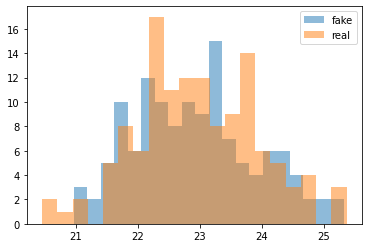

cum_dis_loss 0.2602624724805355, cum_gen_loss 0.26892197608947754


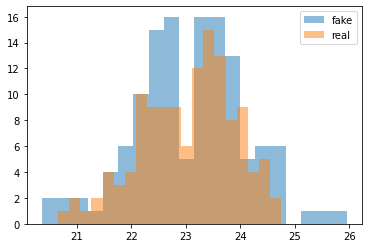

cum_dis_loss 0.26053159922361374, cum_gen_loss 0.2602224177122116


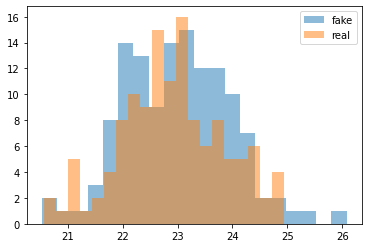

cum_dis_loss 0.2563586639463902, cum_gen_loss 0.26540452882647514


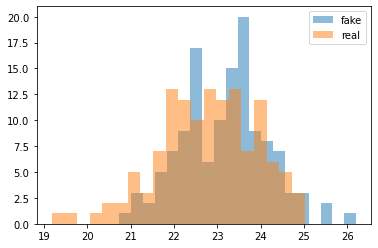

cum_dis_loss 0.25649029898643494, cum_gen_loss 0.2619259937107563


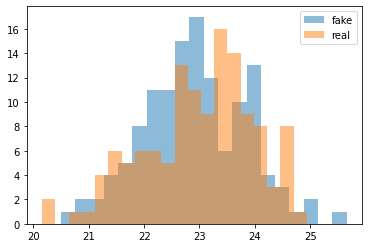

cum_dis_loss 0.25385567924380303, cum_gen_loss 0.26399428948760034


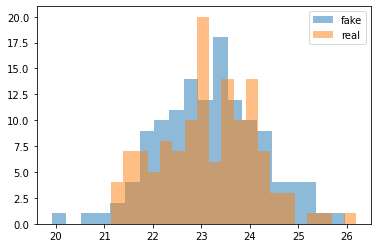

cum_dis_loss 0.25548320984840395, cum_gen_loss 0.2694207142293453


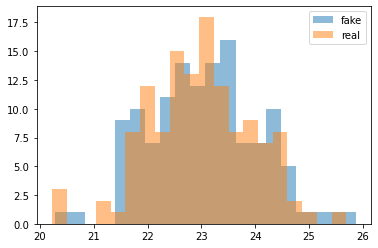

cum_dis_loss 0.26038416516780855, cum_gen_loss 0.2657965944707394


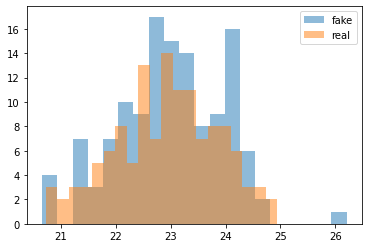

cum_dis_loss 0.25823548032343385, cum_gen_loss 0.2669480800628662


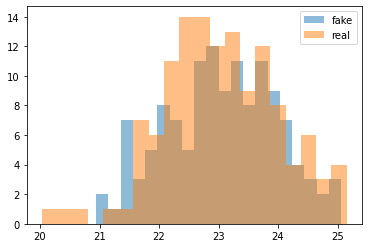

cum_dis_loss 0.25914982441067697, cum_gen_loss 0.2613407251238823


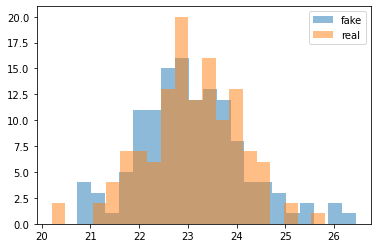

cum_dis_loss 0.25329002514481547, cum_gen_loss 0.2636688379943371


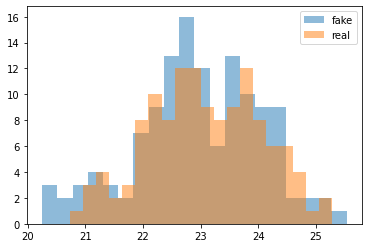

cum_dis_loss 0.2517315758913755, cum_gen_loss 0.2636401964724064


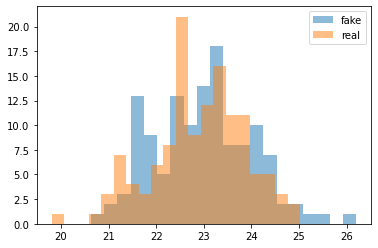

cum_dis_loss 0.2648512205630541, cum_gen_loss 0.2728833343088627


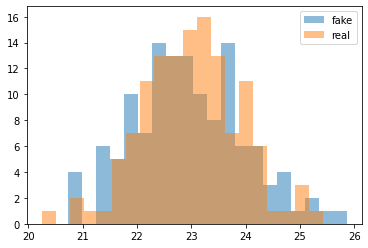

cum_dis_loss 0.2613192654848099, cum_gen_loss 0.2596755163371563


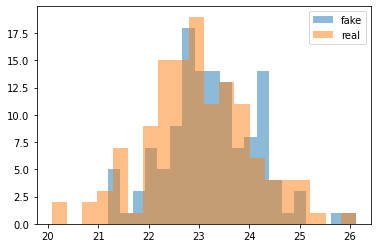

cum_dis_loss 0.2593873490691185, cum_gen_loss 0.25973000049591066


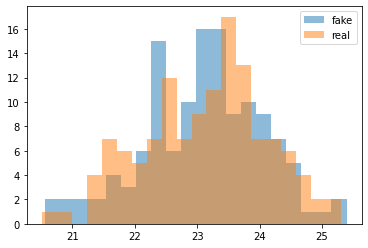

cum_dis_loss 0.25375306740403175, cum_gen_loss 0.2541986249387264


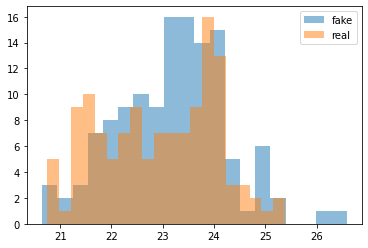

cum_dis_loss 0.2633650439977646, cum_gen_loss 0.28051456198096275


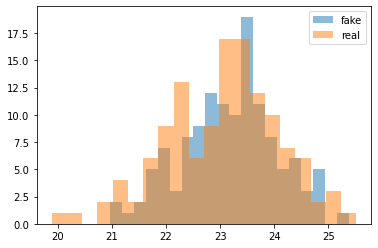

cum_dis_loss 0.2596038672924042, cum_gen_loss 0.27000788077712057


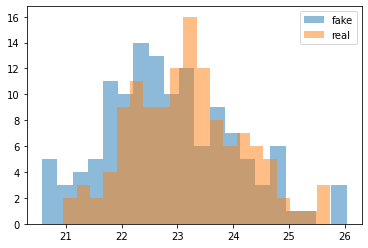

cum_dis_loss 0.26174354857206344, cum_gen_loss 0.2657198569178581


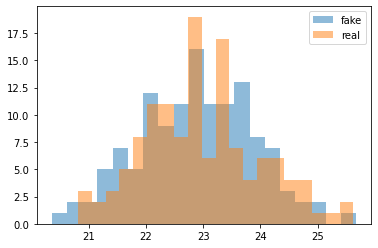

cum_dis_loss 0.25727020770311354, cum_gen_loss 0.27133286878466606


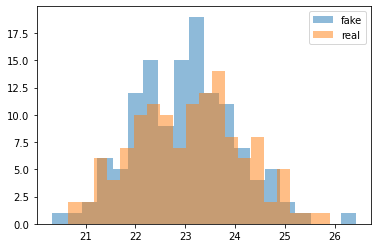

cum_dis_loss 0.2545245658457279, cum_gen_loss 0.2583396525681019


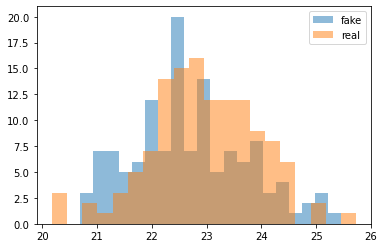

cum_dis_loss 0.25780489671230317, cum_gen_loss 0.26504247352480886


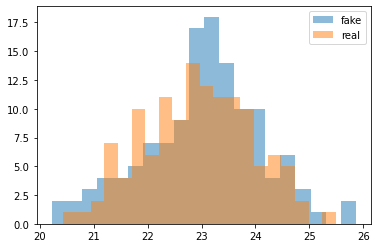

cum_dis_loss 0.253610609382391, cum_gen_loss 0.26665529400110244


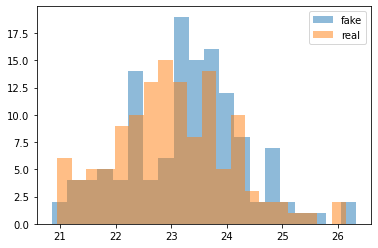

cum_dis_loss 0.2584809785783291, cum_gen_loss 0.2633734366297722


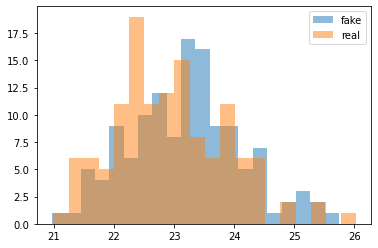

cum_dis_loss 0.26160232642292974, cum_gen_loss 0.26886660188436506


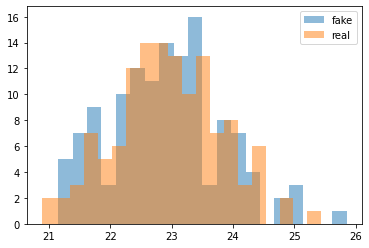

cum_dis_loss 0.25912427505850794, cum_gen_loss 0.2713476540148258


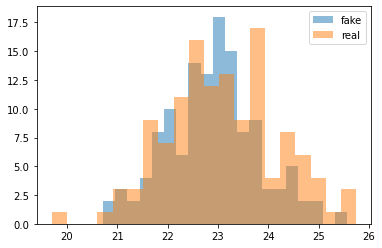

cum_dis_loss 0.2532029052823782, cum_gen_loss 0.2678303048014641


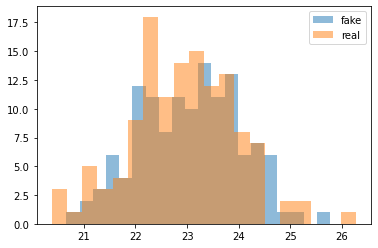

cum_dis_loss 0.25903391452133656, cum_gen_loss 0.26884973898530007


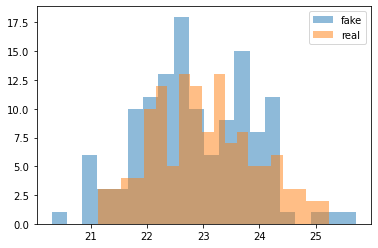

cum_dis_loss 0.2586893642246723, cum_gen_loss 0.27114308103919027


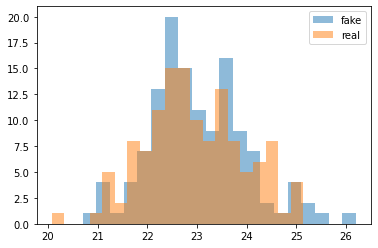

cum_dis_loss 0.25469002896547316, cum_gen_loss 0.2620951999723911


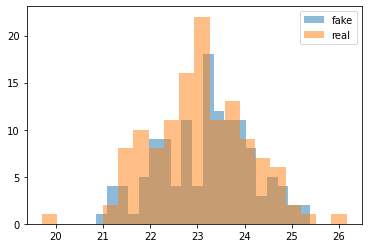

cum_dis_loss 0.2621101430952549, cum_gen_loss 0.2636238159239292


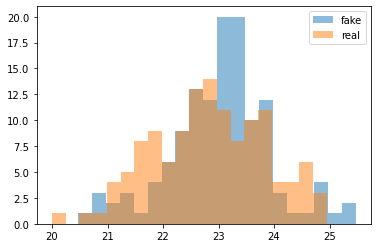

cum_dis_loss 0.25682307627797124, cum_gen_loss 0.26379024252295497


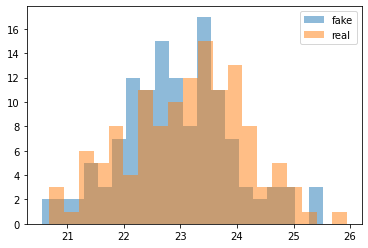

cum_dis_loss 0.2634536092579365, cum_gen_loss 0.2682830548286438


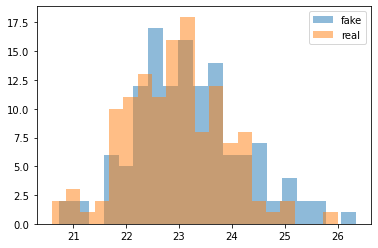

cum_dis_loss 0.2588086377978325, cum_gen_loss 0.26243426188826563


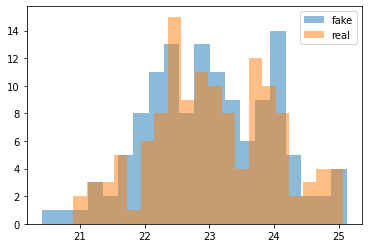

cum_dis_loss 0.26263929933309554, cum_gen_loss 0.2697008644044399


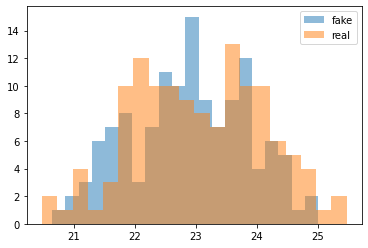

cum_dis_loss 0.26253126934170723, cum_gen_loss 0.2684370970726013


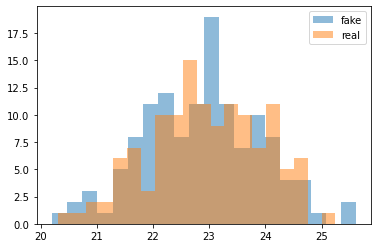

cum_dis_loss 0.2609158031642437, cum_gen_loss 0.2646635650098324


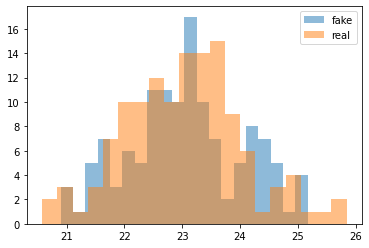

cum_dis_loss 0.25856167006492614, cum_gen_loss 0.26875028863549233


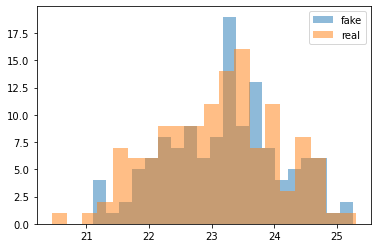

cum_dis_loss 0.25831764271855356, cum_gen_loss 0.2672434881329536


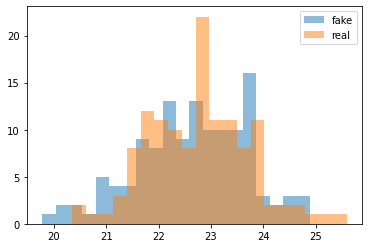

cum_dis_loss 0.2546322471052408, cum_gen_loss 0.2520842219889164


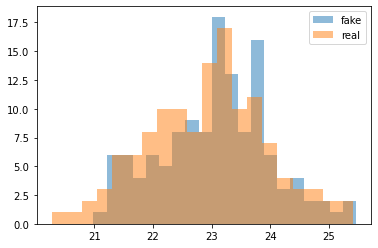

cum_dis_loss 0.2612190337181091, cum_gen_loss 0.25952903777360914


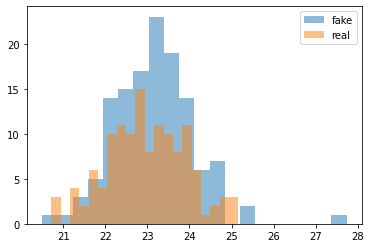

cum_dis_loss 0.2546648238897324, cum_gen_loss 0.26372514307498934


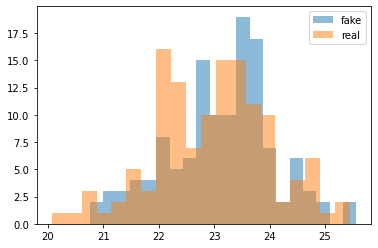

cum_dis_loss 0.25758589762449263, cum_gen_loss 0.2664440163969994


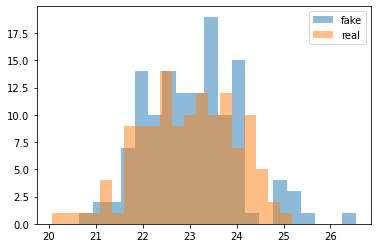

cum_dis_loss 0.260232953697443, cum_gen_loss 0.2646111916005611


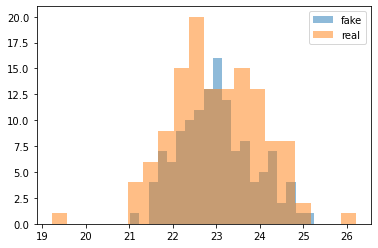

cum_dis_loss 0.256472859993577, cum_gen_loss 0.2727790795266628


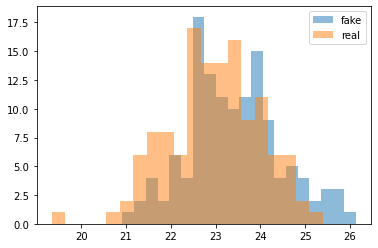

cum_dis_loss 0.26345019671320913, cum_gen_loss 0.2687679232656956


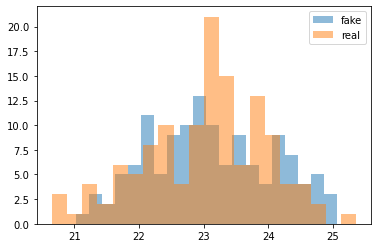

cum_dis_loss 0.26621587596833707, cum_gen_loss 0.26721267849206926


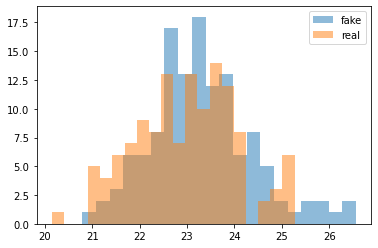

cum_dis_loss 0.25816676816344264, cum_gen_loss 0.2635237316787243


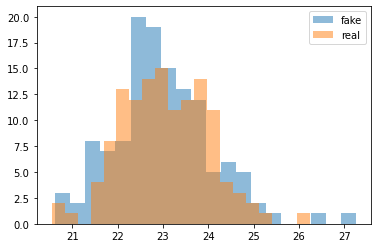

cum_dis_loss 0.25330711525678634, cum_gen_loss 0.2607132790982723


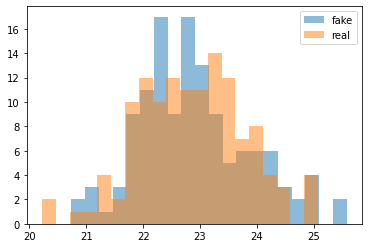

cum_dis_loss 0.26779296427965166, cum_gen_loss 0.2662194922566414


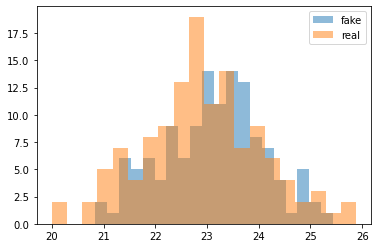

cum_dis_loss 0.25711996948719024, cum_gen_loss 0.26090012699365617


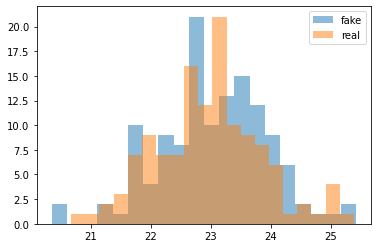

cum_dis_loss 0.26042954391241074, cum_gen_loss 0.2659157928824425


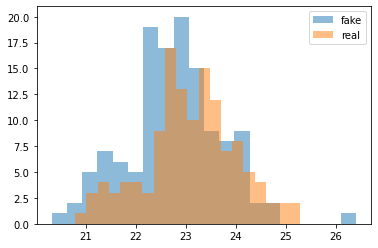

cum_dis_loss 0.2551499308347702, cum_gen_loss 0.26378804698586467


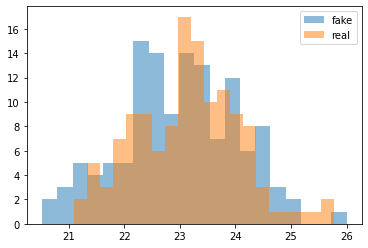

cum_dis_loss 0.26005308829247953, cum_gen_loss 0.26992375880479813


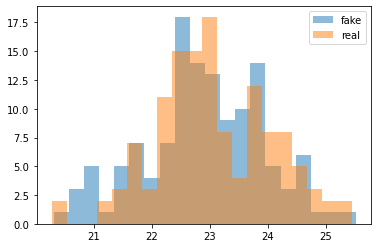

cum_dis_loss 0.2562142839729786, cum_gen_loss 0.2725804129242897


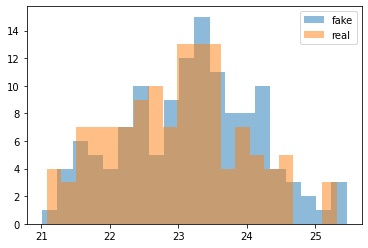

cum_dis_loss 0.2638480313122272, cum_gen_loss 0.2631626683473587


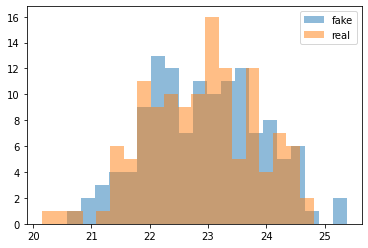

cum_dis_loss 0.2568560282886028, cum_gen_loss 0.2600690415501595


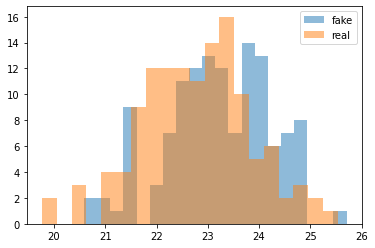

cum_dis_loss 0.25424997332692145, cum_gen_loss 0.2654105170071125


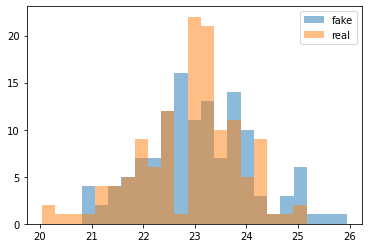

cum_dis_loss 0.26482429921627043, cum_gen_loss 0.2611080324649811


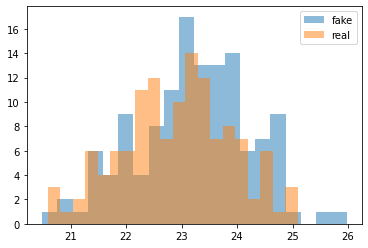

cum_dis_loss 0.2596468158066273, cum_gen_loss 0.26620434820652006


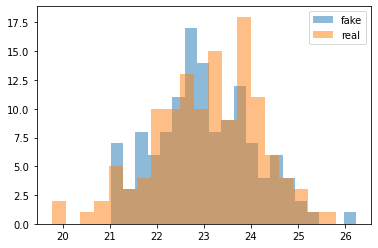

cum_dis_loss 0.25815050143003465, cum_gen_loss 0.2697270466387272


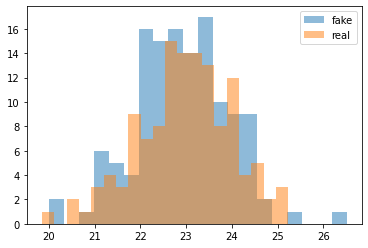

cum_dis_loss 0.25400831815600394, cum_gen_loss 0.2582154558598995


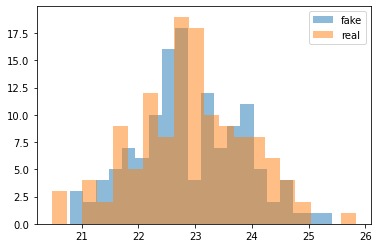

cum_dis_loss 0.2605750535428524, cum_gen_loss 0.27191755518317223


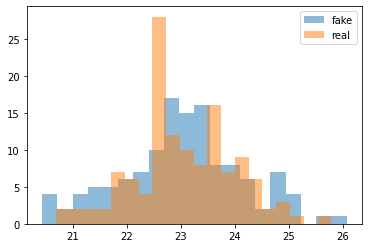

cum_dis_loss 0.2542466841936111, cum_gen_loss 0.2692188821732998


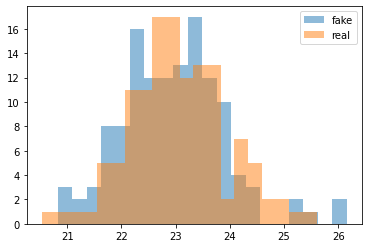

cum_dis_loss 0.2601113433241844, cum_gen_loss 0.2626912112534046


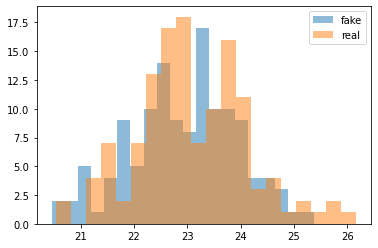

cum_dis_loss 0.26122482725977897, cum_gen_loss 0.2641181743144989


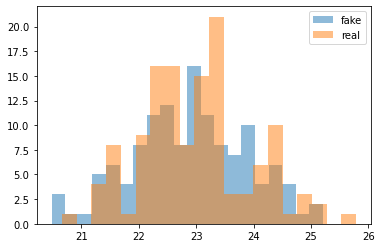

cum_dis_loss 0.25724692302942276, cum_gen_loss 0.2663025668263435


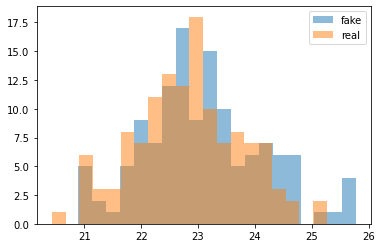

cum_dis_loss 0.25538889415562155, cum_gen_loss 0.26755757063627245


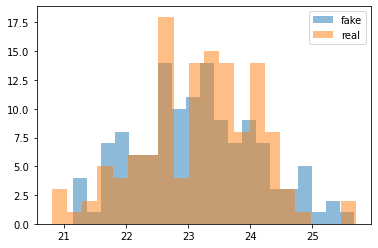

cum_dis_loss 0.2611145966798067, cum_gen_loss 0.2610767343640327


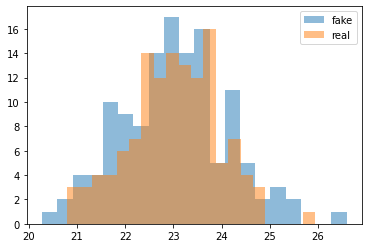

cum_dis_loss 0.26366796958446503, cum_gen_loss 0.2677263434231281


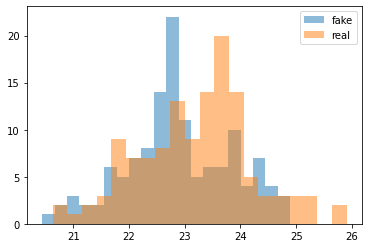

cum_dis_loss 0.26013486650586126, cum_gen_loss 0.26882433757185936


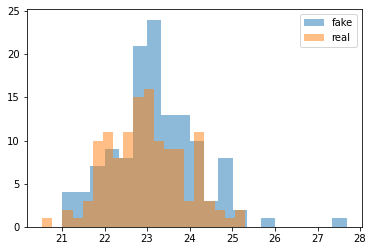

cum_dis_loss 0.2572980970144272, cum_gen_loss 0.2622405150532722


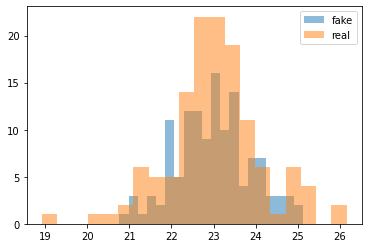

cum_dis_loss 0.2586574772745371, cum_gen_loss 0.27252477139234543


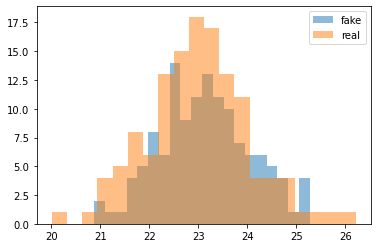

cum_dis_loss 0.2609703200608492, cum_gen_loss 0.2600967887043953


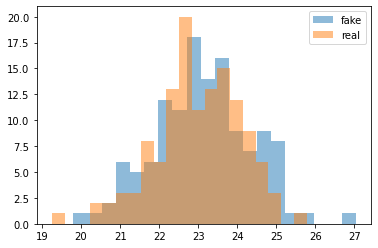

cum_dis_loss 0.25799587830901144, cum_gen_loss 0.26698533847928047


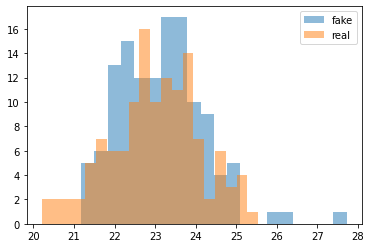

cum_dis_loss 0.26034454263746737, cum_gen_loss 0.2731944204866886


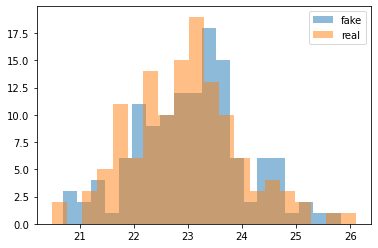

cum_dis_loss 0.2596429044306278, cum_gen_loss 0.2618641670048237


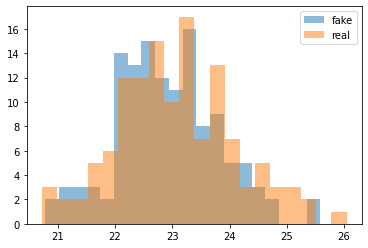

cum_dis_loss 0.25812488704919817, cum_gen_loss 0.26157894283533095


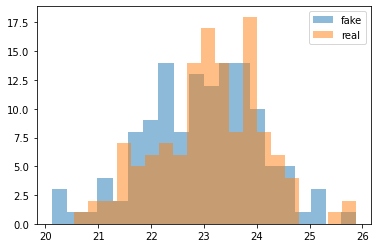

cum_dis_loss 0.2572288437783718, cum_gen_loss 0.2641635073721409


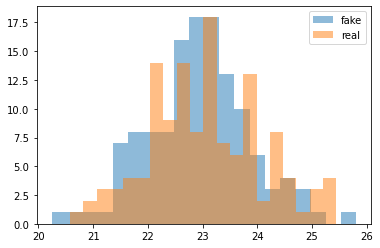

cum_dis_loss 0.26204559016227724, cum_gen_loss 0.2611211532354355


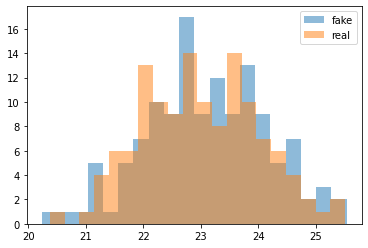

cum_dis_loss 0.25990653659403323, cum_gen_loss 0.26865209370851517


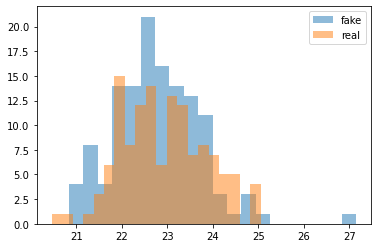

cum_dis_loss 0.25963699309527877, cum_gen_loss 0.2734150594472885


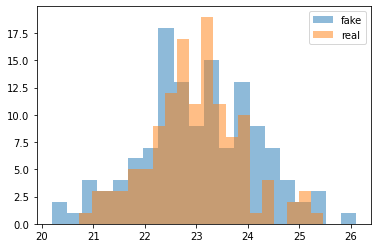

cum_dis_loss 0.26347290247678756, cum_gen_loss 0.2667308203876019


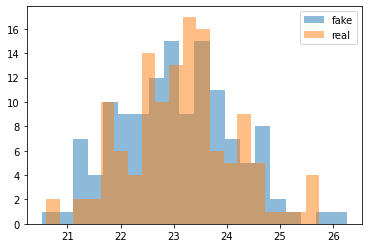

cum_dis_loss 0.25604564079642295, cum_gen_loss 0.27589011788368223


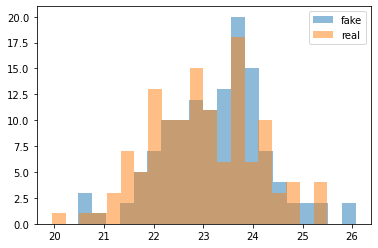

cum_dis_loss 0.25735256016254426, cum_gen_loss 0.26950711503624913


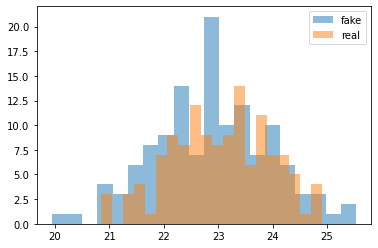

cum_dis_loss 0.267724063873291, cum_gen_loss 0.2701664827764034


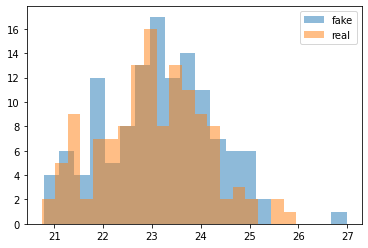

cum_dis_loss 0.2596960897743702, cum_gen_loss 0.26487750992178916


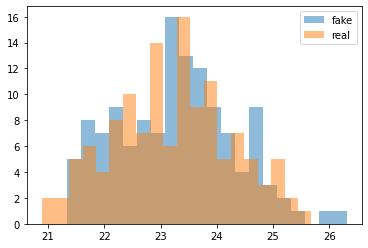

cum_dis_loss 0.2643465191721916, cum_gen_loss 0.2773016281425953


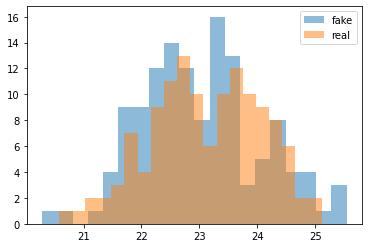

cum_dis_loss 0.2646472228765488, cum_gen_loss 0.267815200984478


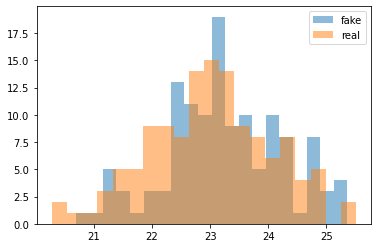

cum_dis_loss 0.26718532271683215, cum_gen_loss 0.2812876796722412


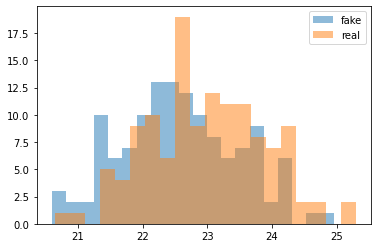

cum_dis_loss 0.26795086032152177, cum_gen_loss 0.26989345729351044


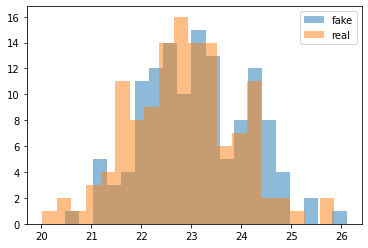

cum_dis_loss 0.26020071731507777, cum_gen_loss 0.26619138300418854


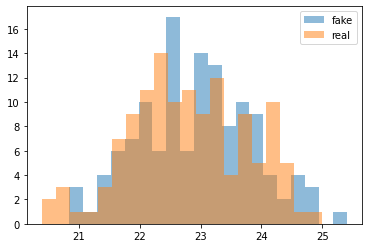

cum_dis_loss 0.2631307157278061, cum_gen_loss 0.2731224751472473


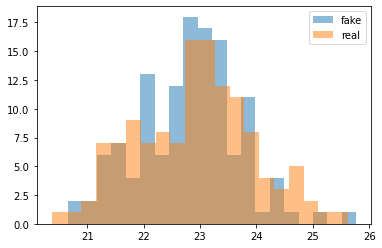

cum_dis_loss 0.2658178213387728, cum_gen_loss 0.27108019337058065


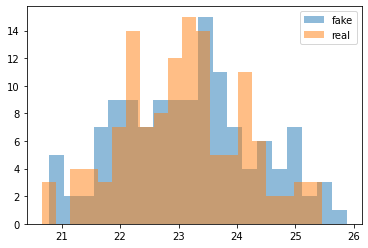

cum_dis_loss 0.2576595097184181, cum_gen_loss 0.2722098916769028


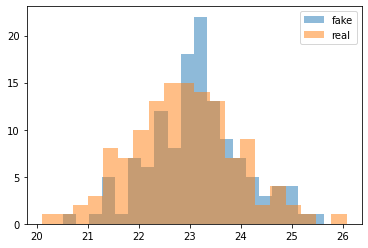

cum_dis_loss 0.2587597392052412, cum_gen_loss 0.2678807426989078


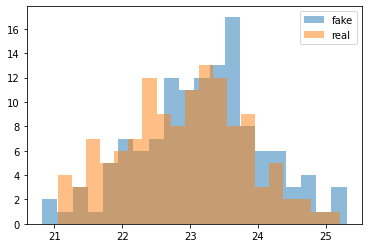

cum_dis_loss 0.2543327984958887, cum_gen_loss 0.26547778978943826


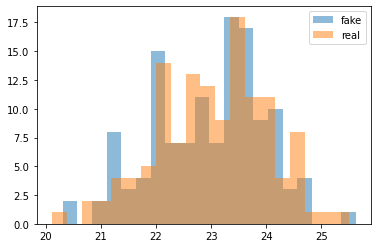

cum_dis_loss 0.26308273646235464, cum_gen_loss 0.262808196246624


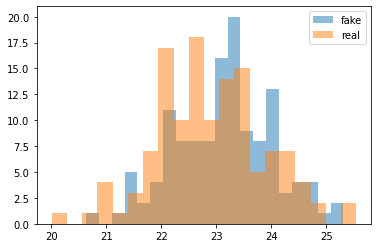

cum_dis_loss 0.25871994833648204, cum_gen_loss 0.2644286887347698


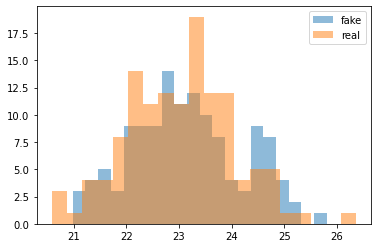

cum_dis_loss 0.266929138302803, cum_gen_loss 0.26826235532760623


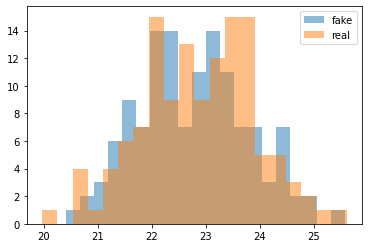

cum_dis_loss 0.2584636095762253, cum_gen_loss 0.2673310440778732


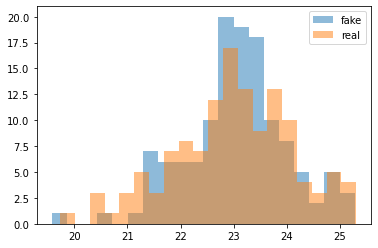

cum_dis_loss 0.2645391039699316, cum_gen_loss 0.2770140504837036


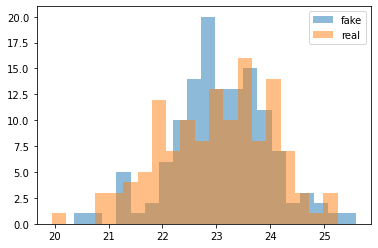

cum_dis_loss 0.25916508156061174, cum_gen_loss 0.2675538791716099


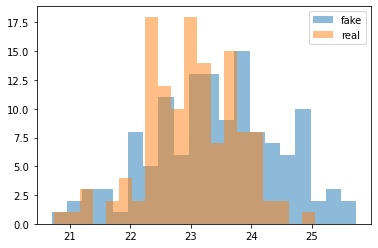

cum_dis_loss 0.26099000169336795, cum_gen_loss 0.27556226462125777


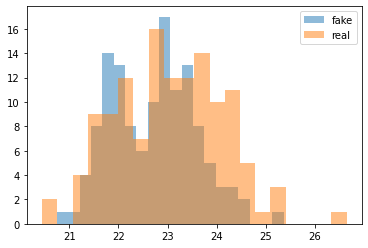

cum_dis_loss 0.26415292620658876, cum_gen_loss 0.26448819488286973


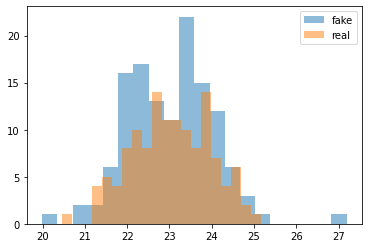

cum_dis_loss 0.2617379164993763, cum_gen_loss 0.26783759877085683


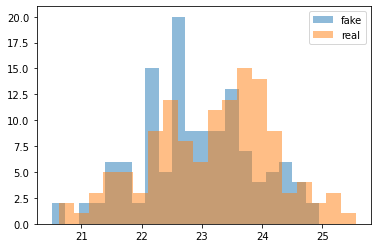

cum_dis_loss 0.26109551173448564, cum_gen_loss 0.2688944135606289


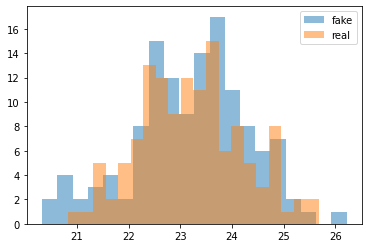

cum_dis_loss 0.262293686747551, cum_gen_loss 0.27330135777592657


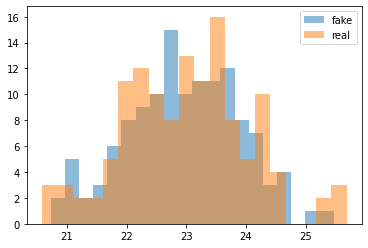

cum_dis_loss 0.2667434638738632, cum_gen_loss 0.27022074729204176


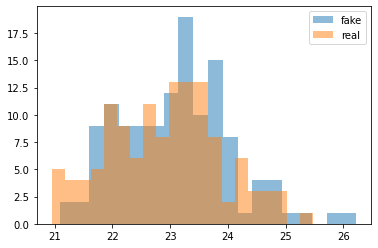

cum_dis_loss 0.2639048624932766, cum_gen_loss 0.26529447838664055


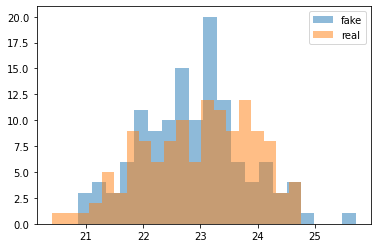

cum_dis_loss 0.25921986070275305, cum_gen_loss 0.26946971014142035


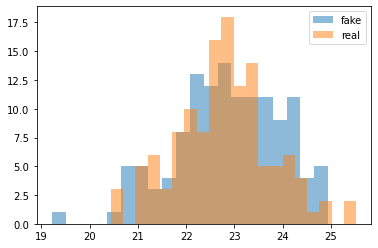

cum_dis_loss 0.2618477215915918, cum_gen_loss 0.2658703438937664


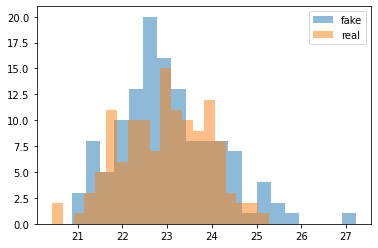

cum_dis_loss 0.2596398184299469, cum_gen_loss 0.2565956634283066


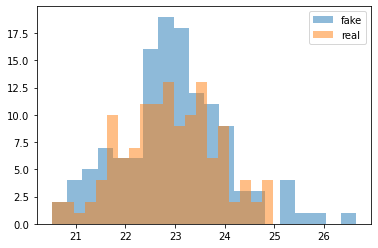

cum_dis_loss 0.26069224640727046, cum_gen_loss 0.27201020166277884


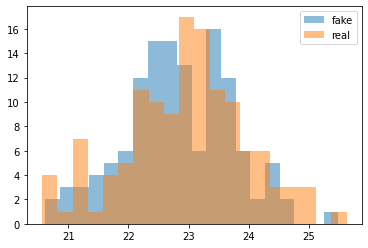

cum_dis_loss 0.25986472959816453, cum_gen_loss 0.26846235170960425


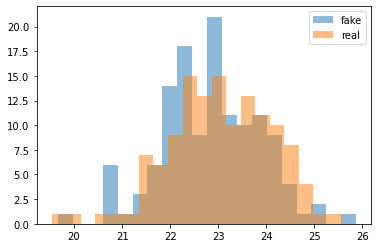

cum_dis_loss 0.2581440809369087, cum_gen_loss 0.25923384323716164


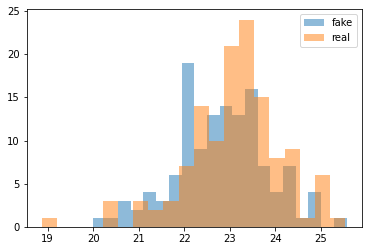

cum_dis_loss 0.2589957015812397, cum_gen_loss 0.2664829879999161


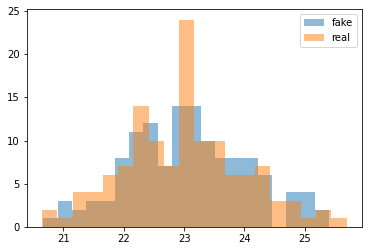

cum_dis_loss 0.260147465094924, cum_gen_loss 0.26530721724033357


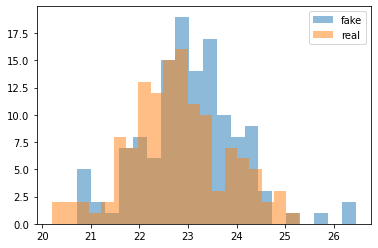

cum_dis_loss 0.2650339321196079, cum_gen_loss 0.2829673951864243


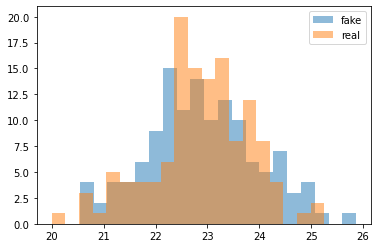

cum_dis_loss 0.26328572577238085, cum_gen_loss 0.2707615022361278


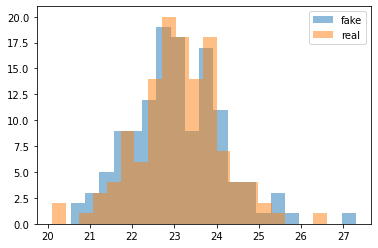

cum_dis_loss 0.25879267913103104, cum_gen_loss 0.2677061416208744


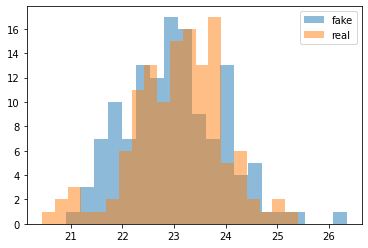

cum_dis_loss 0.2570588530153036, cum_gen_loss 0.2662817005813122


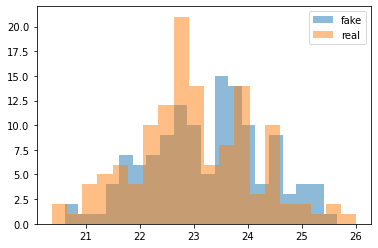

cum_dis_loss 0.2660711744725704, cum_gen_loss 0.2757606260478497


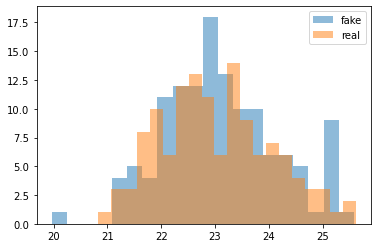

cum_dis_loss 0.26410516518354415, cum_gen_loss 0.2674964521825314


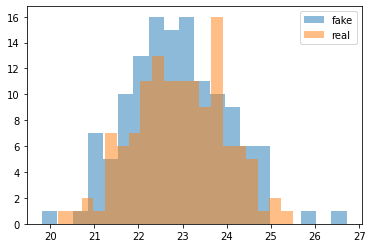

cum_dis_loss 0.2621865125596523, cum_gen_loss 0.2708183120191097


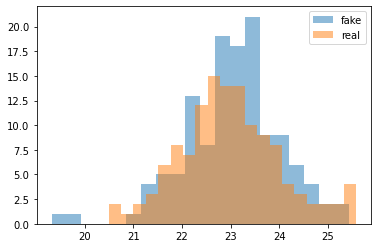

cum_dis_loss 0.2596067109704018, cum_gen_loss 0.2638963668048382


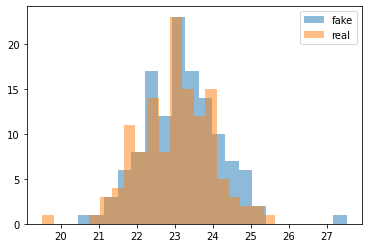

cum_dis_loss 0.25851191592216494, cum_gen_loss 0.2656129892170429


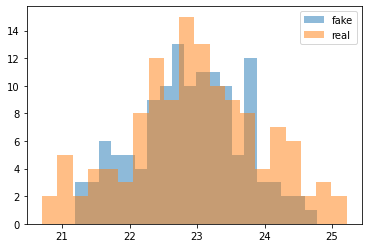

cum_dis_loss 0.25621709087491035, cum_gen_loss 0.2632765097916126


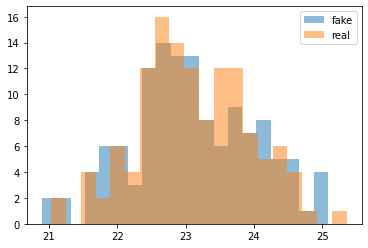

cum_dis_loss 0.2643660005033016, cum_gen_loss 0.2658009596168995


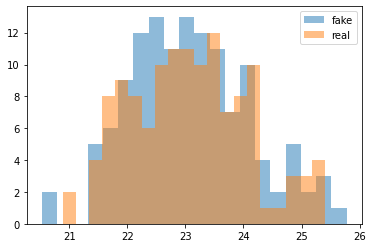

cum_dis_loss 0.25740404081344603, cum_gen_loss 0.26817450538277626


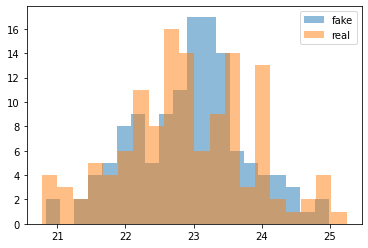

cum_dis_loss 0.26823856818675995, cum_gen_loss 0.2760573396086693


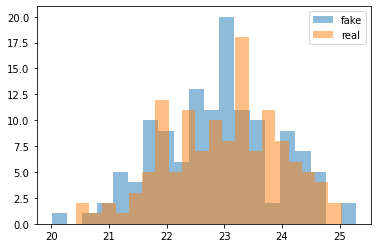

cum_dis_loss 0.26180552223324777, cum_gen_loss 0.2688943548500538


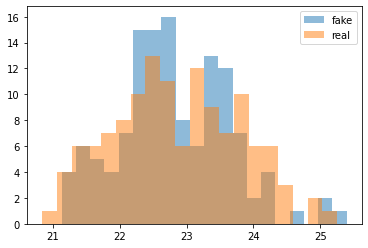

cum_dis_loss 0.2661310654580593, cum_gen_loss 0.2734625582396984


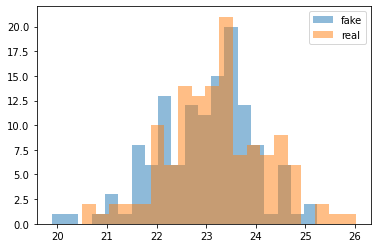

cum_dis_loss 0.25659818524122235, cum_gen_loss 0.27154524981975553


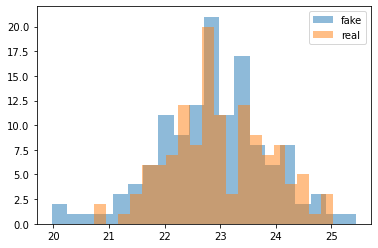

cum_dis_loss 0.2658295350968838, cum_gen_loss 0.2708459559082985


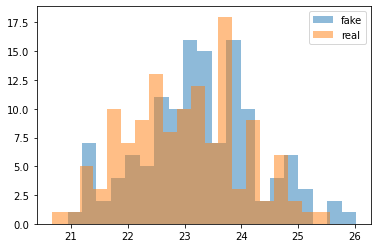

cum_dis_loss 0.26038714334368707, cum_gen_loss 0.2645351766049862


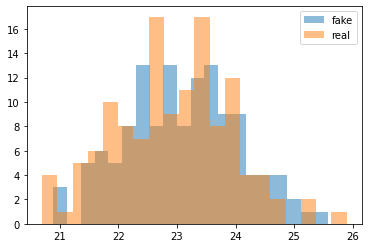

cum_dis_loss 0.2647004051506519, cum_gen_loss 0.2731653727591038


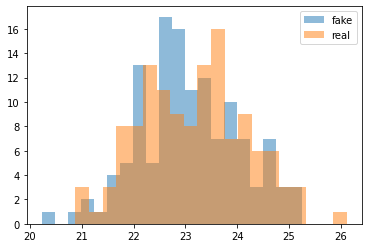

cum_dis_loss 0.26358215983211997, cum_gen_loss 0.2682815857231617


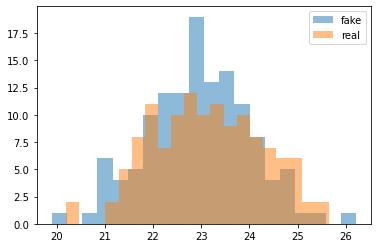

cum_dis_loss 0.2653054514527321, cum_gen_loss 0.26061968550086023


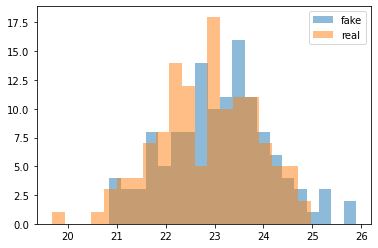

cum_dis_loss 0.26961810068786146, cum_gen_loss 0.27344207882881166


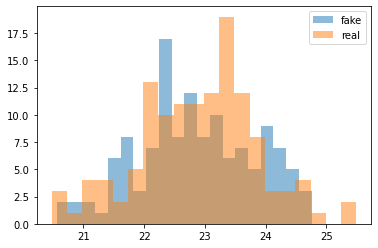

cum_dis_loss 0.2638846632540226, cum_gen_loss 0.27161402627825737


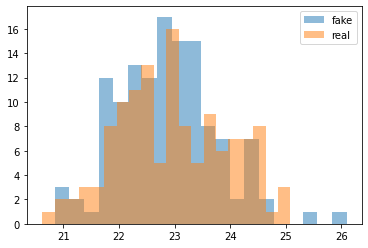

cum_dis_loss 0.26645900794863703, cum_gen_loss 0.2763974088430405


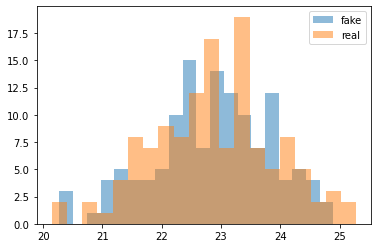

cum_dis_loss 0.2643623250424862, cum_gen_loss 0.2633094467222691


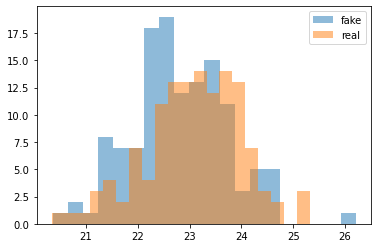

cum_dis_loss 0.2566369650065899, cum_gen_loss 0.2720077259838581


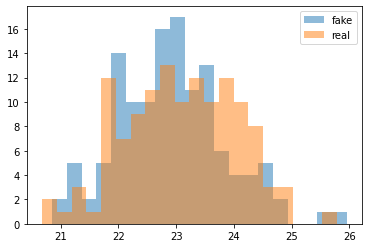

cum_dis_loss 0.26535714042186737, cum_gen_loss 0.26756586074829103


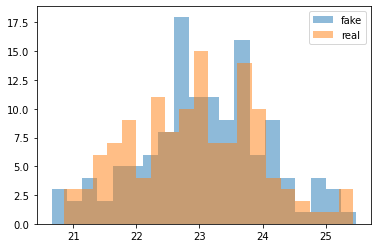

cum_dis_loss 0.25782529583573344, cum_gen_loss 0.2692083334922791


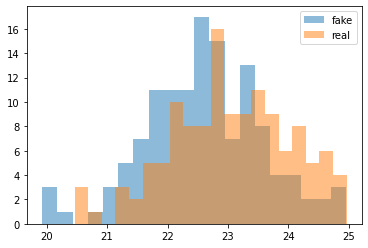

cum_dis_loss 0.2713578716814518, cum_gen_loss 0.2694228795170784


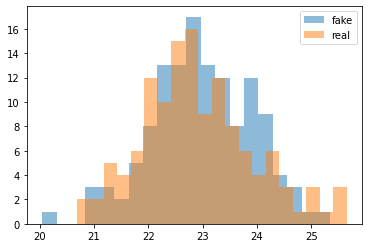

cum_dis_loss 0.25786656299233435, cum_gen_loss 0.26961721777915953


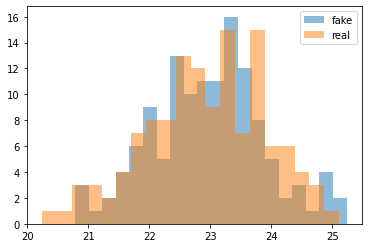

cum_dis_loss 0.2695905944108963, cum_gen_loss 0.2649849773943424


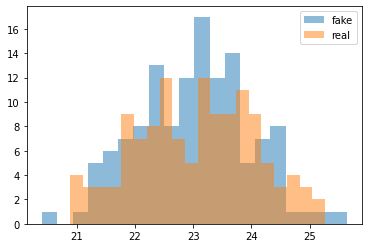

cum_dis_loss 0.2609708086848259, cum_gen_loss 0.26832356318831446


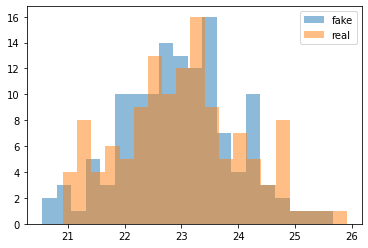

cum_dis_loss 0.25807466764748094, cum_gen_loss 0.2629439006745815


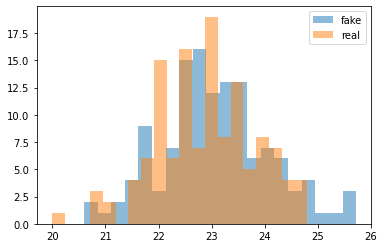

cum_dis_loss 0.2587875699698925, cum_gen_loss 0.27256561115384104


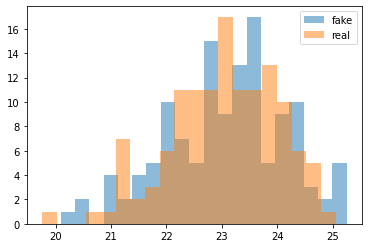

cum_dis_loss 0.2625286749005318, cum_gen_loss 0.2672589546442032


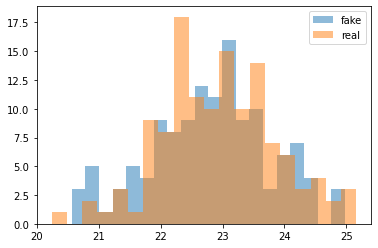

cum_dis_loss 0.26639776039123536, cum_gen_loss 0.27131150603294374


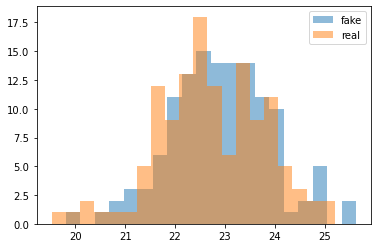

cum_dis_loss 0.25985985481739043, cum_gen_loss 0.268196053057909


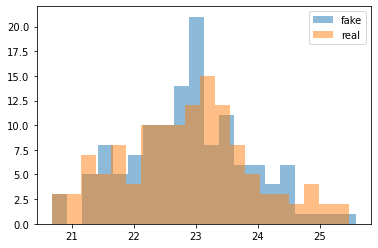

cum_dis_loss 0.26603048369288446, cum_gen_loss 0.26669653236866


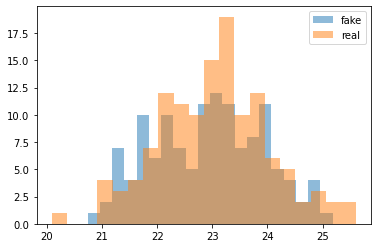

cum_dis_loss 0.2710104752182961, cum_gen_loss 0.27740856513381007


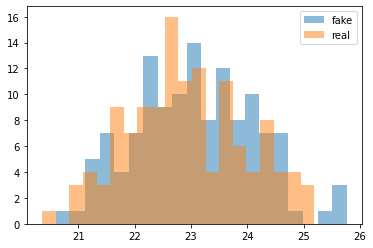

cum_dis_loss 0.26357978308200836, cum_gen_loss 0.26946720883250236


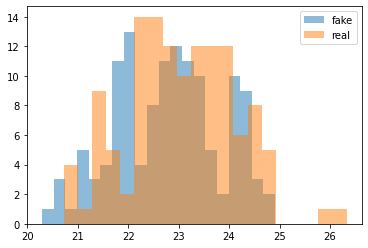

cum_dis_loss 0.26451013758778574, cum_gen_loss 0.26435066521167755


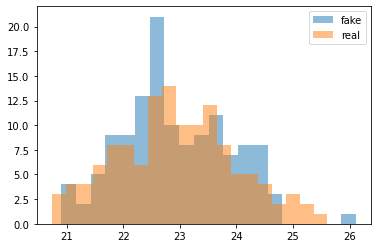

cum_dis_loss 0.2637352338731289, cum_gen_loss 0.2671809007227421


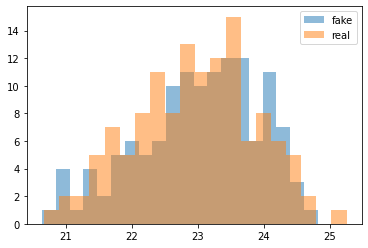

cum_dis_loss 0.26711556831002237, cum_gen_loss 0.2753500260412693


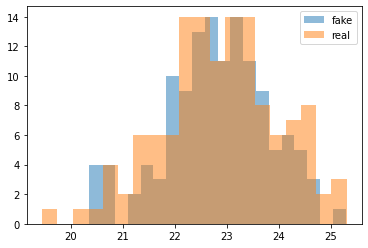

cum_dis_loss 0.2639067656248808, cum_gen_loss 0.2657909482717514


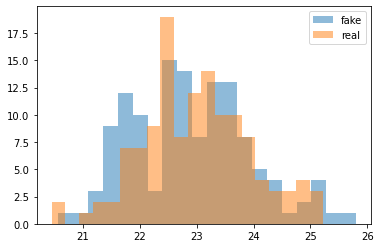

cum_dis_loss 0.26962545901536944, cum_gen_loss 0.2708629855513573


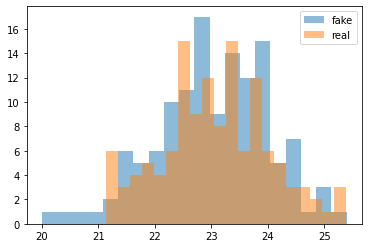

cum_dis_loss 0.2648654360473156, cum_gen_loss 0.27104422971606257


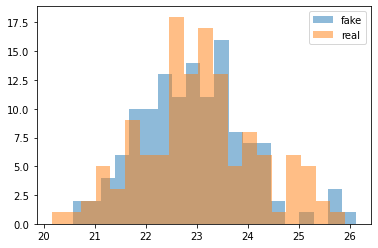

cum_dis_loss 0.256821918874979, cum_gen_loss 0.26349291428923605


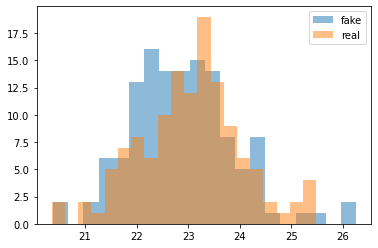

cum_dis_loss 0.2619070388972759, cum_gen_loss 0.26842685326933863


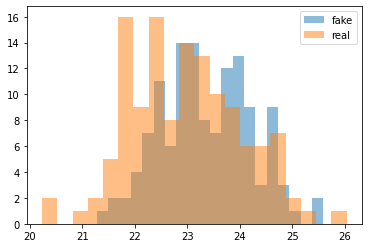

cum_dis_loss 0.2698301686346531, cum_gen_loss 0.2678523875772953


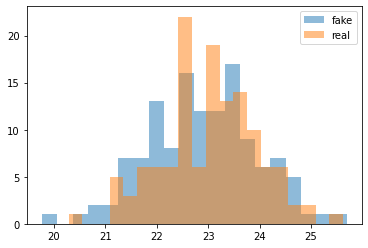

cum_dis_loss 0.2639401570111513, cum_gen_loss 0.27241376399993894


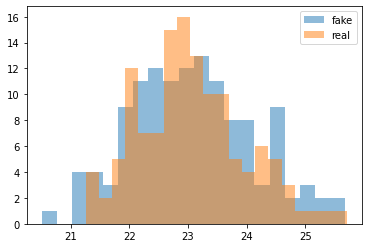

cum_dis_loss 0.26583748596906664, cum_gen_loss 0.26416478499770163


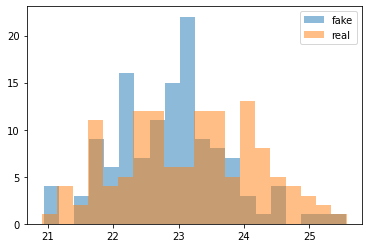

cum_dis_loss 0.2633528508245945, cum_gen_loss 0.27000053465366364


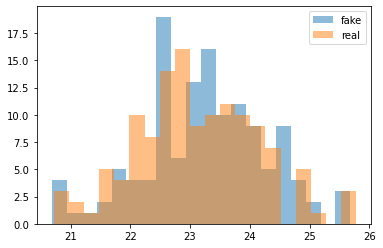

cum_dis_loss 0.2584168367087841, cum_gen_loss 0.2695702047646046


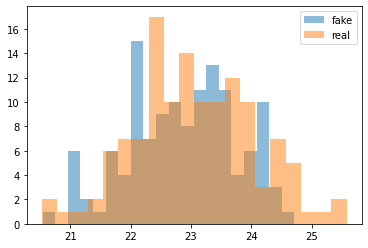

cum_dis_loss 0.26805870938301085, cum_gen_loss 0.278773375749588


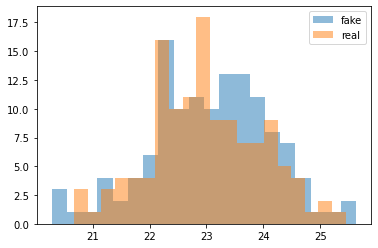

cum_dis_loss 0.26640530917048455, cum_gen_loss 0.268225671350956


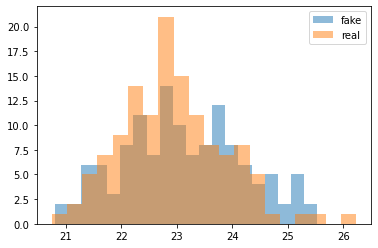

cum_dis_loss 0.26275358733534815, cum_gen_loss 0.26348264306783675


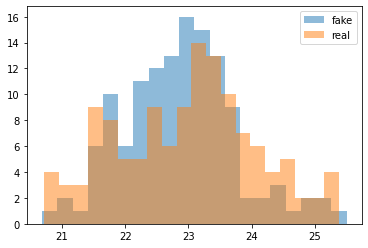

cum_dis_loss 0.2696709334254265, cum_gen_loss 0.2776762108504772


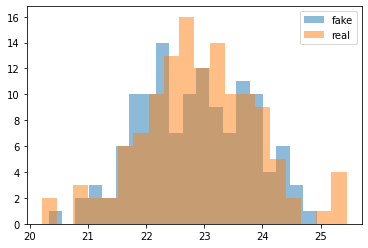

cum_dis_loss 0.263222418487072, cum_gen_loss 0.27385968059301374


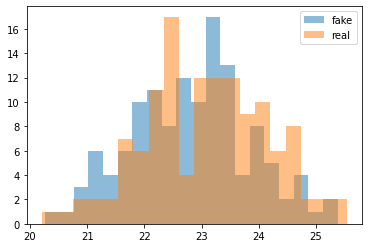

cum_dis_loss 0.26435333532094957, cum_gen_loss 0.25648063853383063


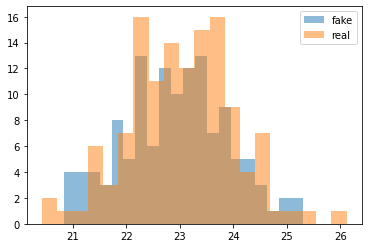

cum_dis_loss 0.2619856779426336, cum_gen_loss 0.26973937422037125


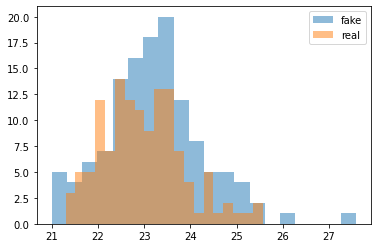

cum_dis_loss 0.2643842508494854, cum_gen_loss 0.27127919033169745


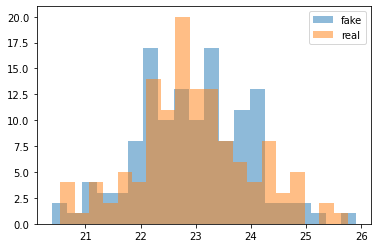

cum_dis_loss 0.2602202278971672, cum_gen_loss 0.2708569374680519


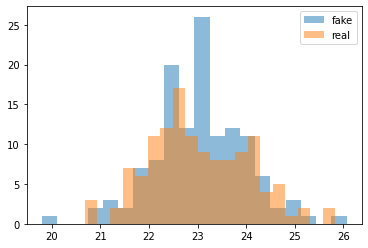

cum_dis_loss 0.2600095181018114, cum_gen_loss 0.26777407243847845


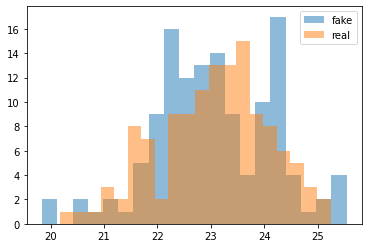

cum_dis_loss 0.2620714729428291, cum_gen_loss 0.2693208134174347


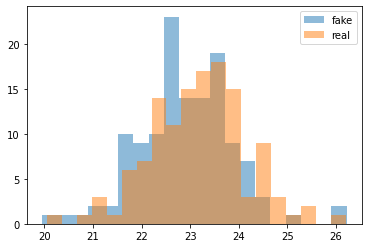

cum_dis_loss 0.2620729119479656, cum_gen_loss 0.2681826813519001


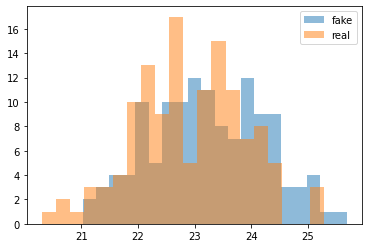

cum_dis_loss 0.26405263084173203, cum_gen_loss 0.26817203357815744


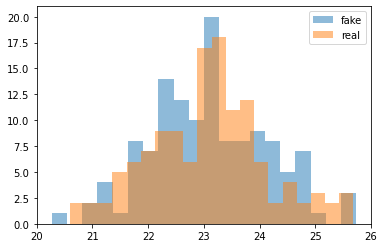

cum_dis_loss 0.26695566830039025, cum_gen_loss 0.26703536450862886


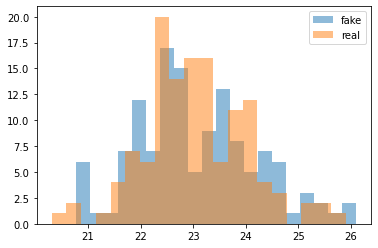

cum_dis_loss 0.26251853838562966, cum_gen_loss 0.2692279116809368


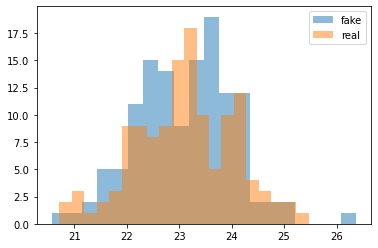

cum_dis_loss 0.2609679252207279, cum_gen_loss 0.2670009882748127


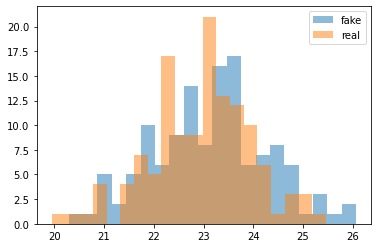

cum_dis_loss 0.2603531338274479, cum_gen_loss 0.26613809943199157


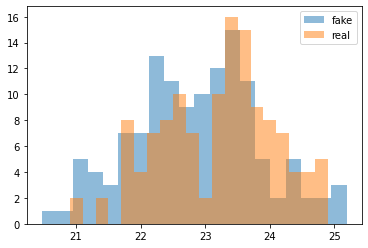

cum_dis_loss 0.26017982144653795, cum_gen_loss 0.26938246205449107


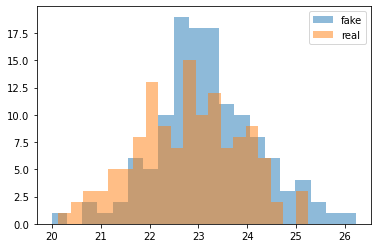

cum_dis_loss 0.26396141251921657, cum_gen_loss 0.2707611636817455


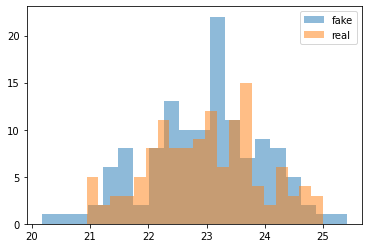

cum_dis_loss 0.27141944590210915, cum_gen_loss 0.2793577376008034


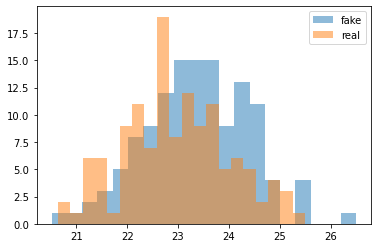

cum_dis_loss 0.2619999041259289, cum_gen_loss 0.27085670724511146


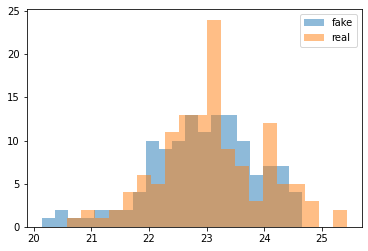

cum_dis_loss 0.2704345628619194, cum_gen_loss 0.2700268422067165


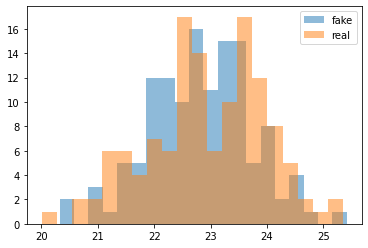

cum_dis_loss 0.2576164608001709, cum_gen_loss 0.2695726352930069


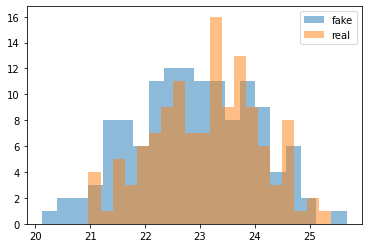

cum_dis_loss 0.25981784442067146, cum_gen_loss 0.2629637639224529


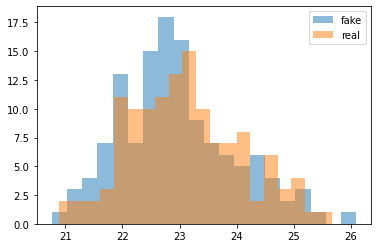

cum_dis_loss 0.26391688230633736, cum_gen_loss 0.2696945156157017


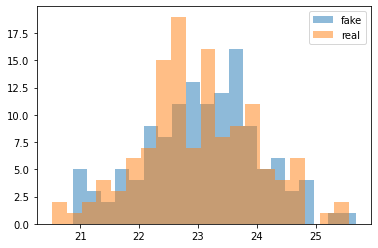

cum_dis_loss 0.2630465205311775, cum_gen_loss 0.26304583132267


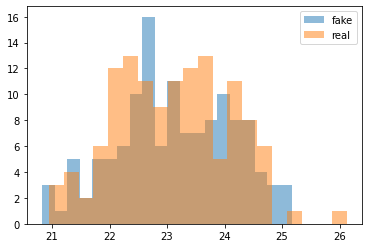

cum_dis_loss 0.26109224450588225, cum_gen_loss 0.270789754986763


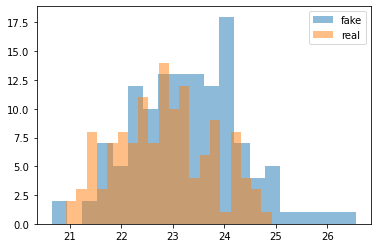

cum_dis_loss 0.2659068208485842, cum_gen_loss 0.27374752119183543


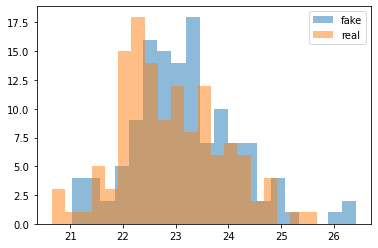

cum_dis_loss 0.2683036241531372, cum_gen_loss 0.2732090395689011


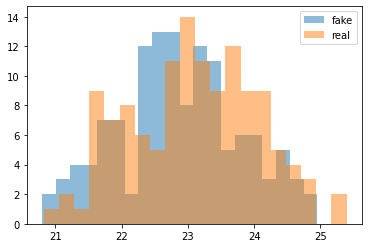

cum_dis_loss 0.2626912165284157, cum_gen_loss 0.2661113400757313


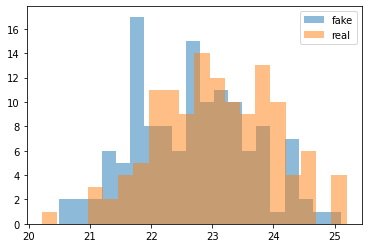

cum_dis_loss 0.27306547048687935, cum_gen_loss 0.2673876541852951


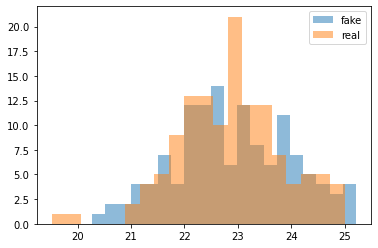

cum_dis_loss 0.2661193735450506, cum_gen_loss 0.2674341881275177


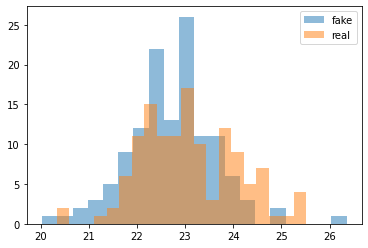

cum_dis_loss 0.26333538866043094, cum_gen_loss 0.26623458877205847


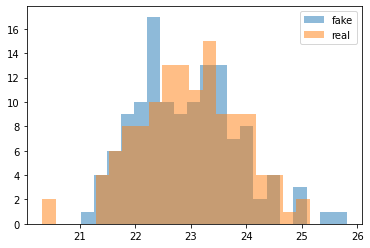

cum_dis_loss 0.26401533231139185, cum_gen_loss 0.2708445554971695


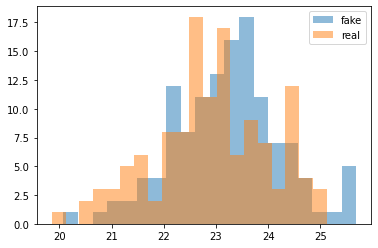

cum_dis_loss 0.263952631637454, cum_gen_loss 0.26652120471000673


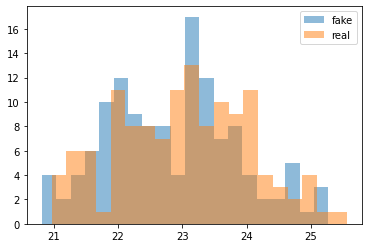

cum_dis_loss 0.26798301592469215, cum_gen_loss 0.26990899682044983


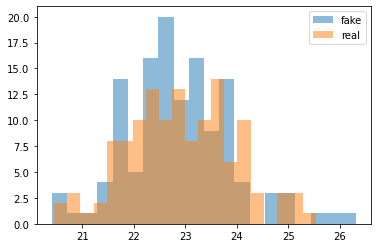

cum_dis_loss 0.2690421598553657, cum_gen_loss 0.2791874019801617


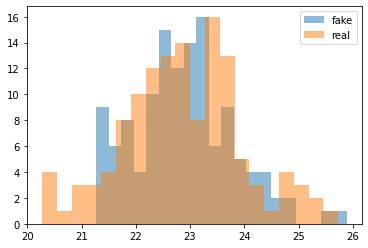

cum_dis_loss 0.26490581426024434, cum_gen_loss 0.268819235265255


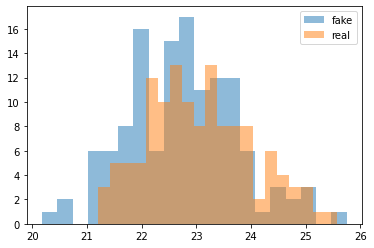

cum_dis_loss 0.2657400129586458, cum_gen_loss 0.2710846339166164


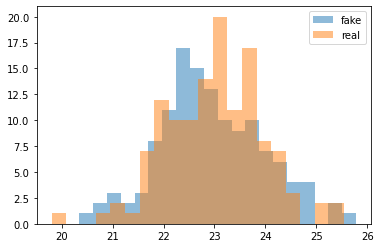

cum_dis_loss 0.2689927351474762, cum_gen_loss 0.2689167204499245


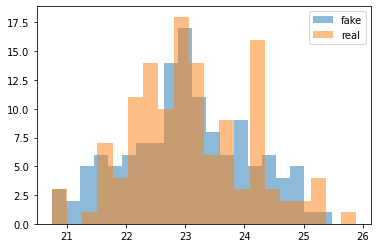

cum_dis_loss 0.26383589941263197, cum_gen_loss 0.2706678296625614


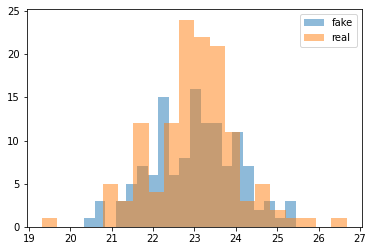

cum_dis_loss 0.2600518704354763, cum_gen_loss 0.2742137223482132


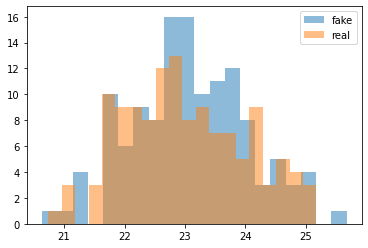

cum_dis_loss 0.2668088515996933, cum_gen_loss 0.2722610431909561


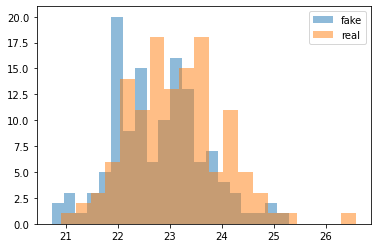

cum_dis_loss 0.2646733106672764, cum_gen_loss 0.27696414291858673


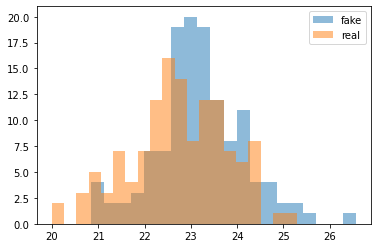

cum_dis_loss 0.26165014323592184, cum_gen_loss 0.2718454188108444


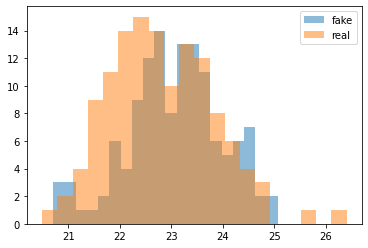

cum_dis_loss 0.26696435451507566, cum_gen_loss 0.2677490858733654


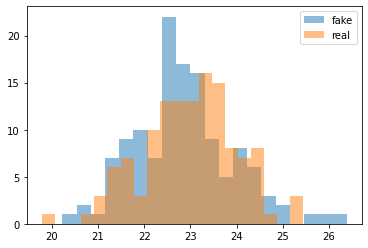

cum_dis_loss 0.26302963846921923, cum_gen_loss 0.2598658674955368


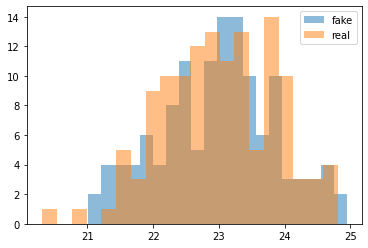

cum_dis_loss 0.26067878487706186, cum_gen_loss 0.2664871656894684


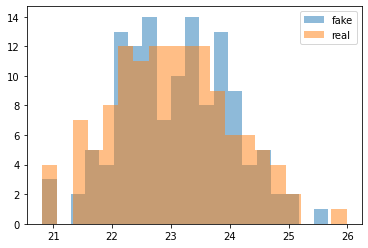

cum_dis_loss 0.2622581566274166, cum_gen_loss 0.2611680491268635


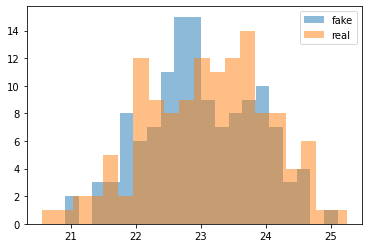

cum_dis_loss 0.26558071094751357, cum_gen_loss 0.2726770901679993


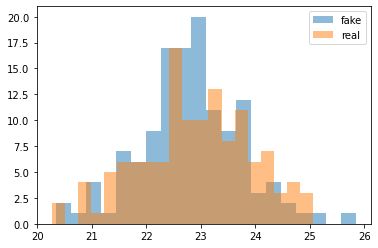

cum_dis_loss 0.25826488891243937, cum_gen_loss 0.26690908521413803


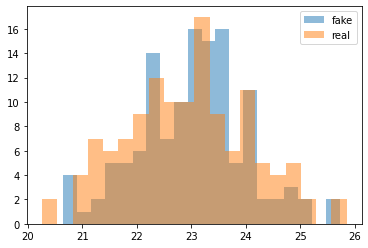

cum_dis_loss 0.2698219161629677, cum_gen_loss 0.27160045444965364


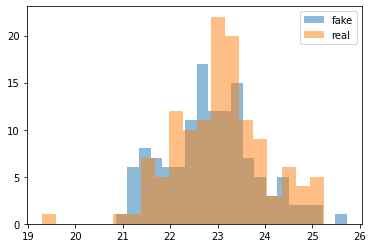

cum_dis_loss 0.2600218799114227, cum_gen_loss 0.26544003874063493


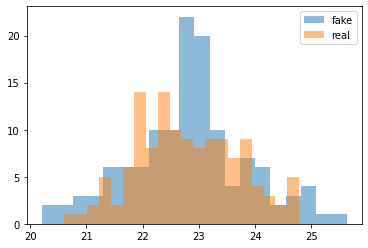

cum_dis_loss 0.2611252086162567, cum_gen_loss 0.2662410090863705


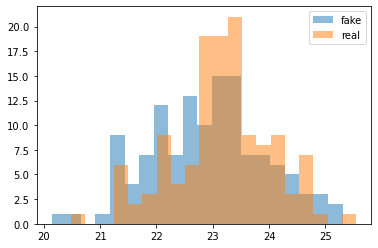

cum_dis_loss 0.2698549957573414, cum_gen_loss 0.27713059112429617


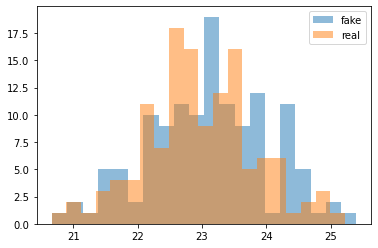

cum_dis_loss 0.26871797451376916, cum_gen_loss 0.26605348989367483


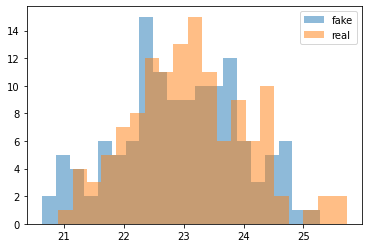

cum_dis_loss 0.26114381223917005, cum_gen_loss 0.26601805225014685


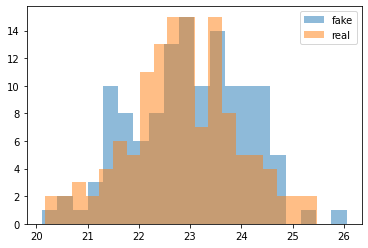

cum_dis_loss 0.269326133698225, cum_gen_loss 0.2711972737312317


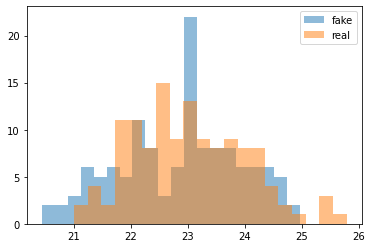

cum_dis_loss 0.2642026827633381, cum_gen_loss 0.27371772691607477


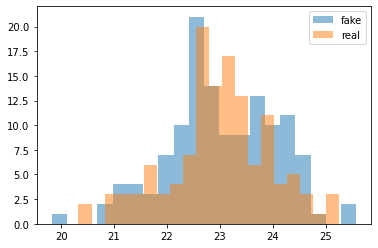

cum_dis_loss 0.2624972126185894, cum_gen_loss 0.26664589658379556


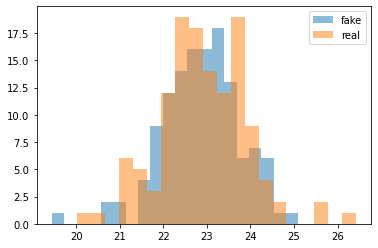

cum_dis_loss 0.2676200706362724, cum_gen_loss 0.27990067571401595


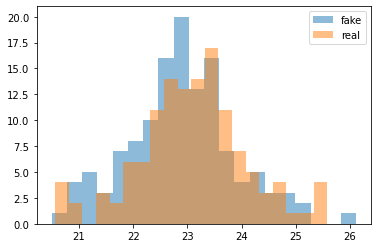

cum_dis_loss 0.26310434117913245, cum_gen_loss 0.26975287944078447


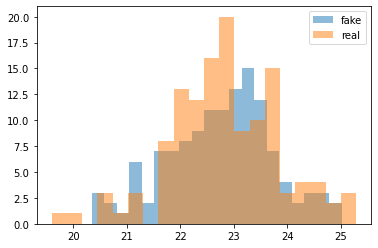

cum_dis_loss 0.26923930084705355, cum_gen_loss 0.27265695586800576


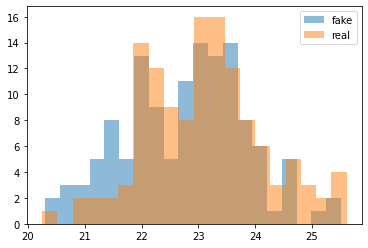

cum_dis_loss 0.2706781763732433, cum_gen_loss 0.2742603787779808


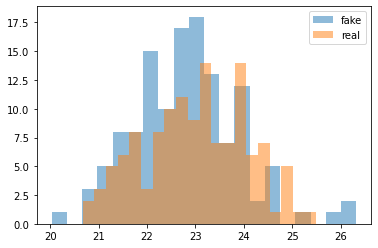

cum_dis_loss 0.2622202549278736, cum_gen_loss 0.2655343483388424


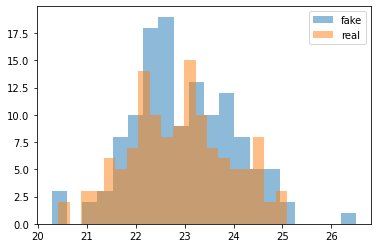

cum_dis_loss 0.273168287307024, cum_gen_loss 0.2765169520676136


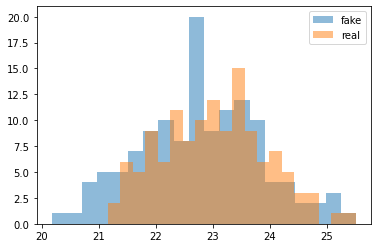

cum_dis_loss 0.27390475130081177, cum_gen_loss 0.2862899321317673


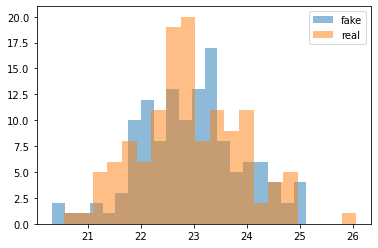

cum_dis_loss 0.26395031651854517, cum_gen_loss 0.26867490738630295


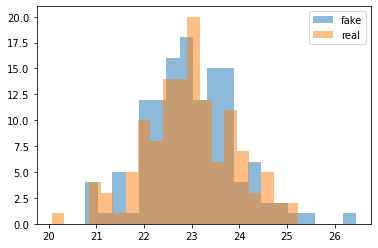

cum_dis_loss 0.2636923266351223, cum_gen_loss 0.2742903582751751


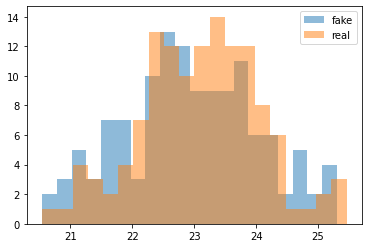

cum_dis_loss 0.2698811809122562, cum_gen_loss 0.2660737097263336


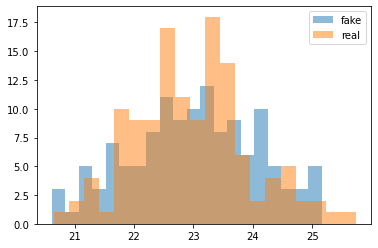

cum_dis_loss 0.26761417683959005, cum_gen_loss 0.26623629957437517


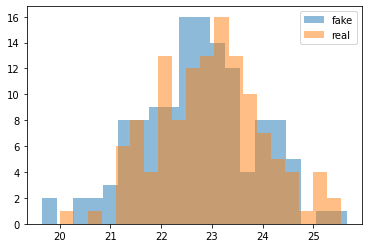

cum_dis_loss 0.27049469527602193, cum_gen_loss 0.2730903755128384


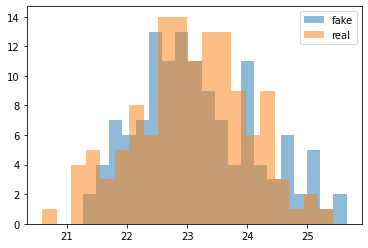

cum_dis_loss 0.2649583494067192, cum_gen_loss 0.26937669813632964


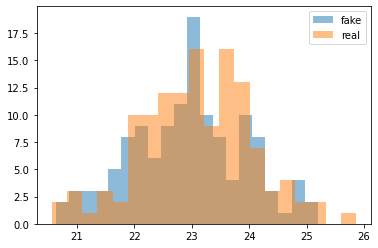

cum_dis_loss 0.25993092101812365, cum_gen_loss 0.26225032418966293


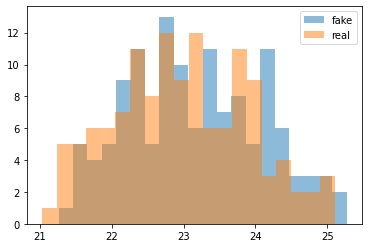

cum_dis_loss 0.26892415404319764, cum_gen_loss 0.2670724496245384


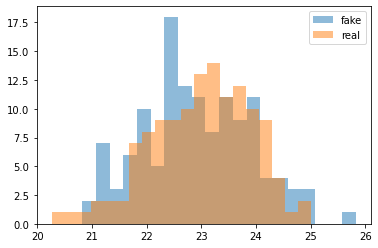

cum_dis_loss 0.26680165418982504, cum_gen_loss 0.2707818329334259


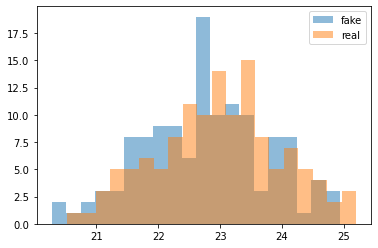

cum_dis_loss 0.2668709461987019, cum_gen_loss 0.26840131148695945


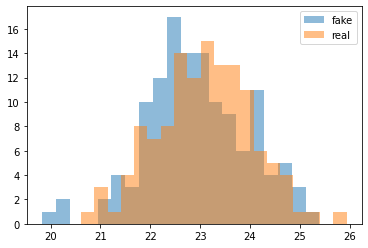

cum_dis_loss 0.2669046505391598, cum_gen_loss 0.27193633288145064


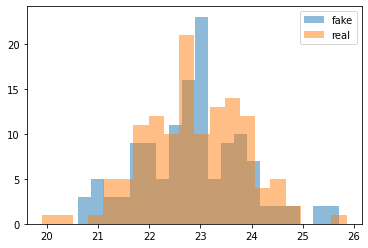

cum_dis_loss 0.2661690495312214, cum_gen_loss 0.27142377495765685


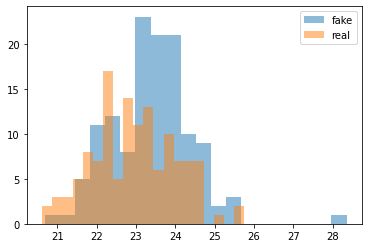

cum_dis_loss 0.2703915933072567, cum_gen_loss 0.26910912215709687


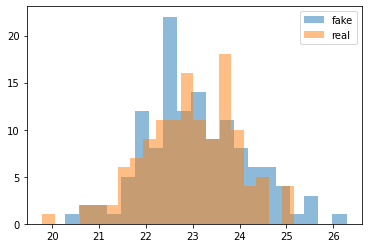

cum_dis_loss 0.2658176109939814, cum_gen_loss 0.2690635448694229


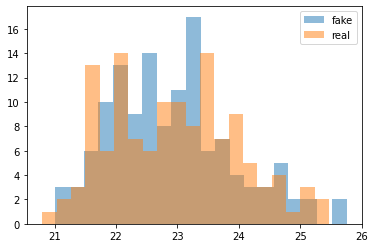

cum_dis_loss 0.2567292885482311, cum_gen_loss 0.2713612343370915


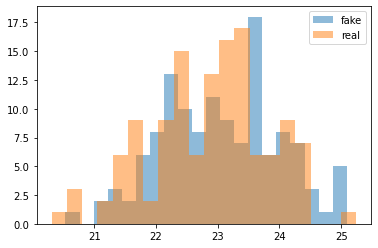

cum_dis_loss 0.268047392308712, cum_gen_loss 0.2694691100716591


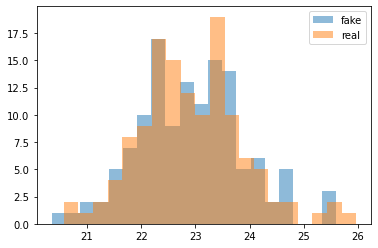

cum_dis_loss 0.26165810573101045, cum_gen_loss 0.2654826487600803


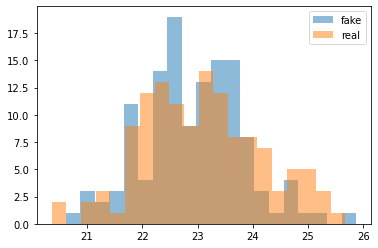

cum_dis_loss 0.26772620978951456, cum_gen_loss 0.26671979621052744


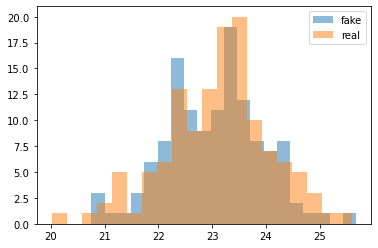

cum_dis_loss 0.26669943317770956, cum_gen_loss 0.26418730437755583


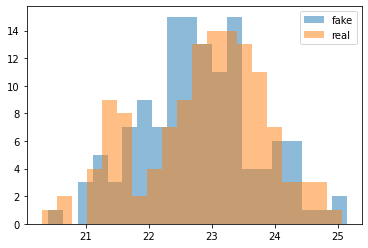

cum_dis_loss 0.2672054016888142, cum_gen_loss 0.2768762914836407


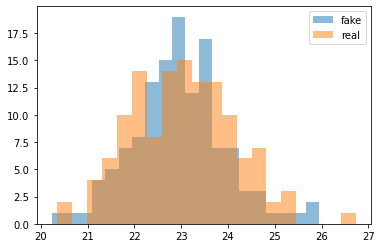

cum_dis_loss 0.2669417842626572, cum_gen_loss 0.27279628947377205


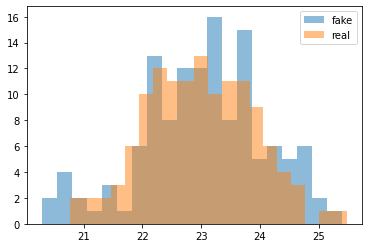

cum_dis_loss 0.26413370689749716, cum_gen_loss 0.26899972558021545


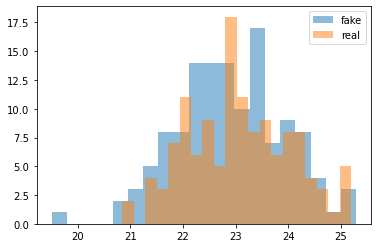

cum_dis_loss 0.2642343848645687, cum_gen_loss 0.2776307253539562


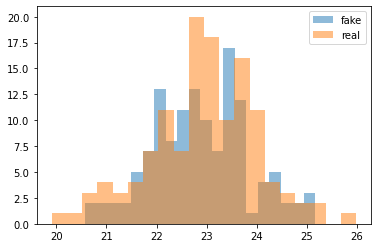

cum_dis_loss 0.2643258636593819, cum_gen_loss 0.2777222077548504


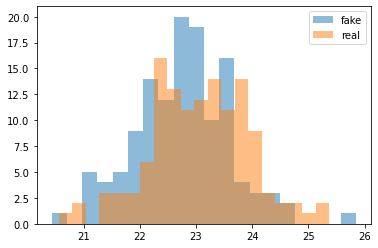

cum_dis_loss 0.26635869085788727, cum_gen_loss 0.2738992114365101


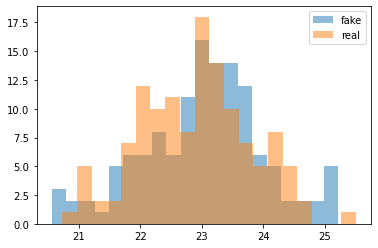

cum_dis_loss 0.2658938629925251, cum_gen_loss 0.27573809802532195


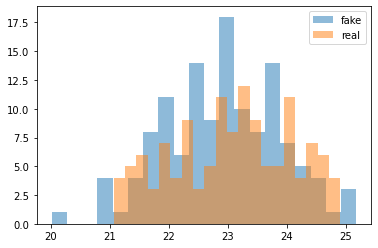

cum_dis_loss 0.26633096396923067, cum_gen_loss 0.2708889350295067


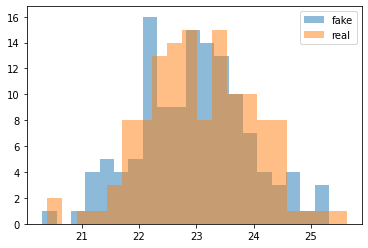

cum_dis_loss 0.2668709593564272, cum_gen_loss 0.26756474152207377


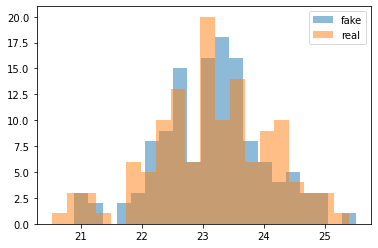

cum_dis_loss 0.2646857473552227, cum_gen_loss 0.27195036560297015


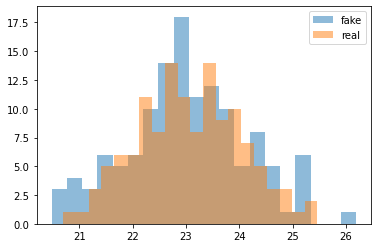

cum_dis_loss 0.26964353835582733, cum_gen_loss 0.2745024374127388


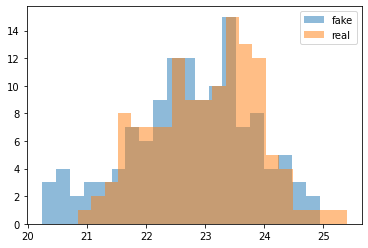

cum_dis_loss 0.2651699135005474, cum_gen_loss 0.27821376129984854


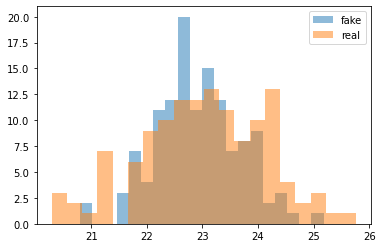

cum_dis_loss 0.2663081402331591, cum_gen_loss 0.27247564420104026


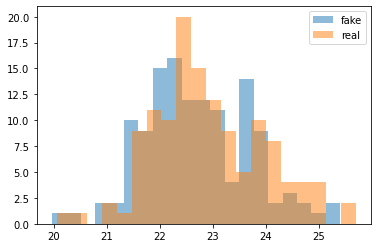

cum_dis_loss 0.26539715637266637, cum_gen_loss 0.27130732968449595


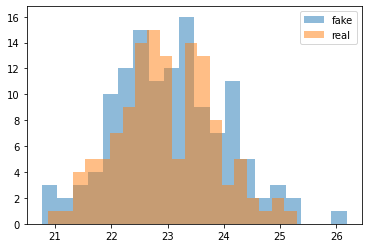

cum_dis_loss 0.2600989489853382, cum_gen_loss 0.269076761752367


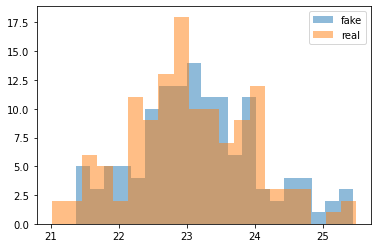

cum_dis_loss 0.2683543019294739, cum_gen_loss 0.26948620438575743


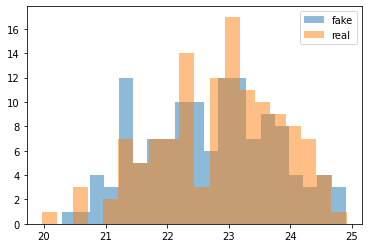

cum_dis_loss 0.26944897323846817, cum_gen_loss 0.2743314988911152


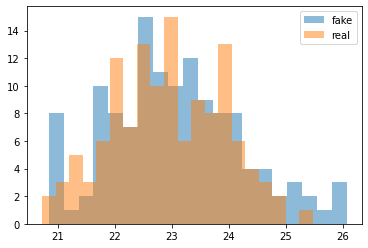

cum_dis_loss 0.2692200939059258, cum_gen_loss 0.27154729038476944


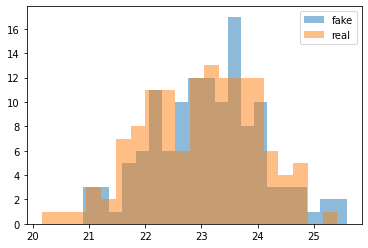

cum_dis_loss 0.26967358016967774, cum_gen_loss 0.2703646391630173


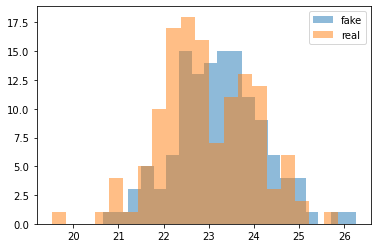

cum_dis_loss 0.26592553466558455, cum_gen_loss 0.2779796099662781


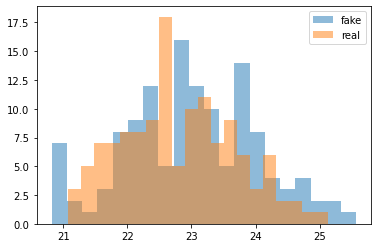

cum_dis_loss 0.2731262608766556, cum_gen_loss 0.26468908458948137


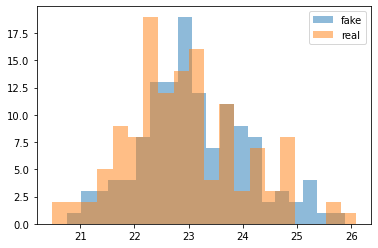

cum_dis_loss 0.26452124562859536, cum_gen_loss 0.2749067158997059


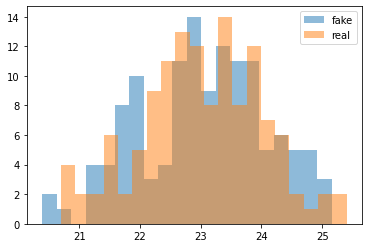

cum_dis_loss 0.2652626705169678, cum_gen_loss 0.272684857994318


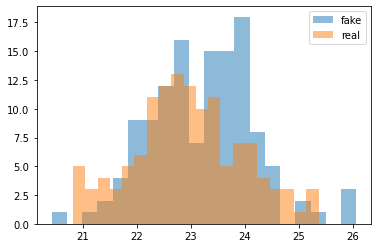

cum_dis_loss 0.26697980135679245, cum_gen_loss 0.2752887178957462


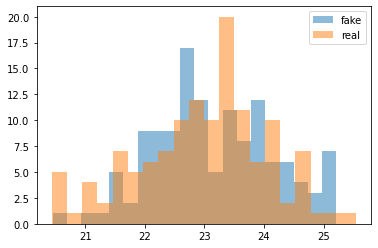

cum_dis_loss 0.26741738441586493, cum_gen_loss 0.2712004940211773


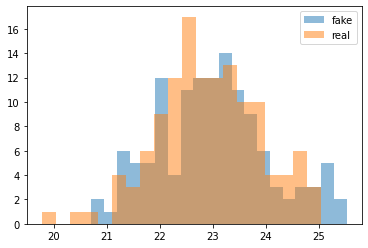

cum_dis_loss 0.26556622731685636, cum_gen_loss 0.26718106493353844


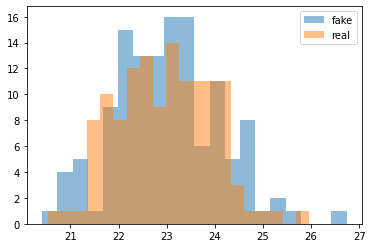

cum_dis_loss 0.2673291452229023, cum_gen_loss 0.2718022626638412


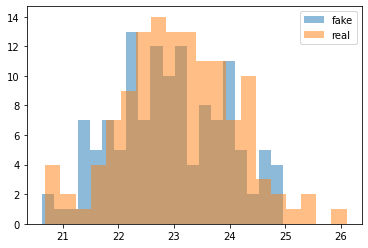

cum_dis_loss 0.265277014285326, cum_gen_loss 0.2735058753192425


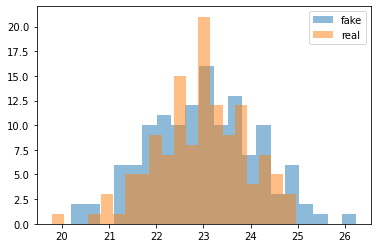

cum_dis_loss 0.2621973369717598, cum_gen_loss 0.26739474684000014


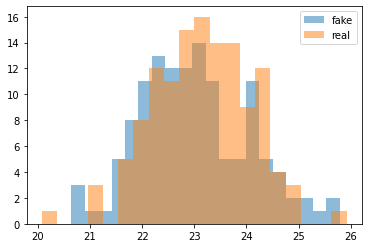

cum_dis_loss 0.26314790251851083, cum_gen_loss 0.26488152652978897


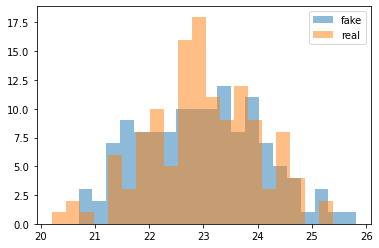

cum_dis_loss 0.269154518827796, cum_gen_loss 0.2721952782571316


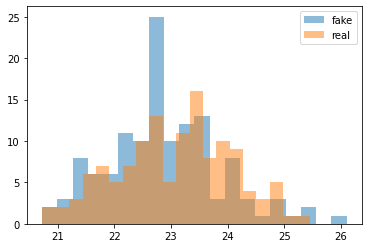

cum_dis_loss 0.26432180097699165, cum_gen_loss 0.27395406275987627


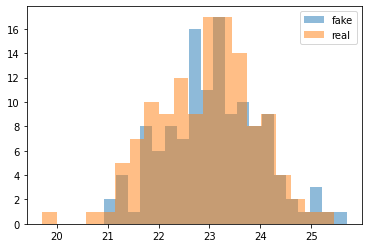

cum_dis_loss 0.27055592933297157, cum_gen_loss 0.2745510657131672


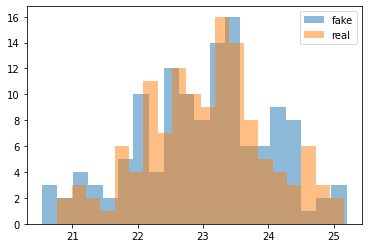

cum_dis_loss 0.2680362762361765, cum_gen_loss 0.2736173701286316


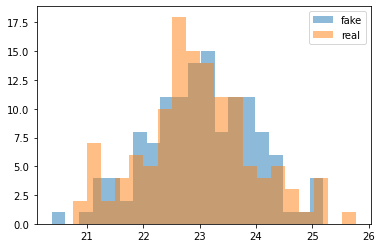

cum_dis_loss 0.26483187395334246, cum_gen_loss 0.2723433031141758


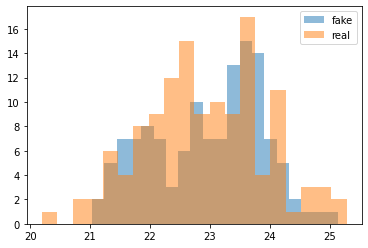

cum_dis_loss 0.2640961538553238, cum_gen_loss 0.27279039338231087


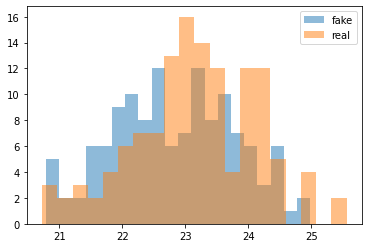

cum_dis_loss 0.2734239964187145, cum_gen_loss 0.2698776811361313


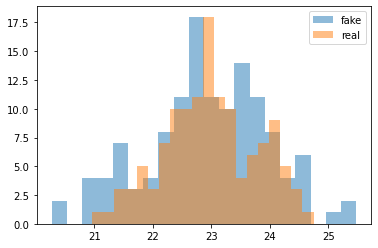

cum_dis_loss 0.2654671995043755, cum_gen_loss 0.2743775384128094


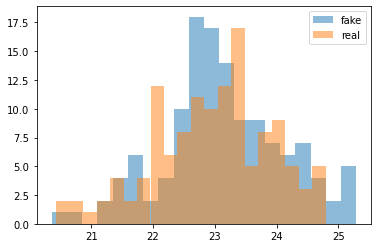

cum_dis_loss 0.2674959155023098, cum_gen_loss 0.26959428057074547


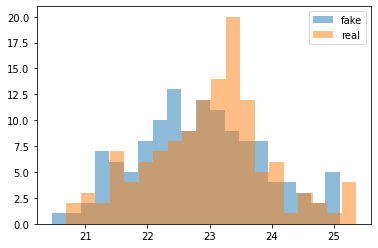

cum_dis_loss 0.26963110694289205, cum_gen_loss 0.2684107519686222


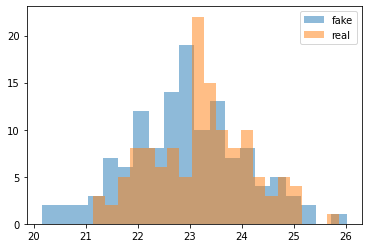

cum_dis_loss 0.26405937963724135, cum_gen_loss 0.2626481707394123


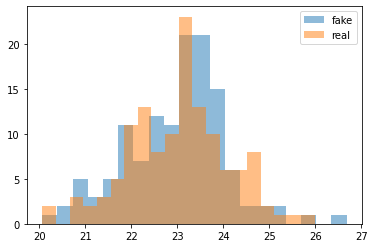

cum_dis_loss 0.26721452543139457, cum_gen_loss 0.2745610648393631


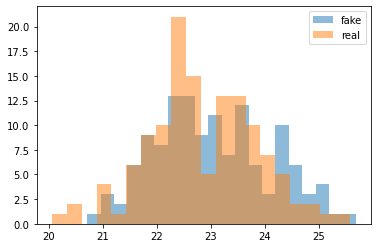

cum_dis_loss 0.2671000763773918, cum_gen_loss 0.27152890771627425


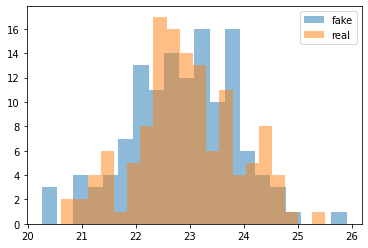

cum_dis_loss 0.26591641673445704, cum_gen_loss 0.2655748392641544


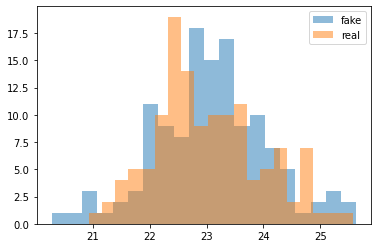

cum_dis_loss 0.26164704164862634, cum_gen_loss 0.275018522888422


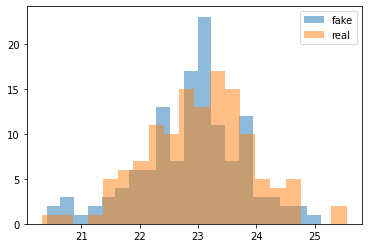

cum_dis_loss 0.26884280544519423, cum_gen_loss 0.27508719712495805


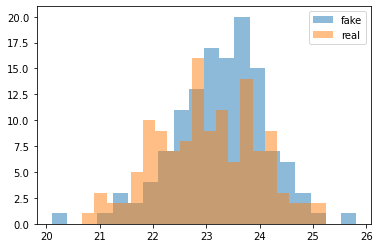

cum_dis_loss 0.2702538837492466, cum_gen_loss 0.2764274570345879


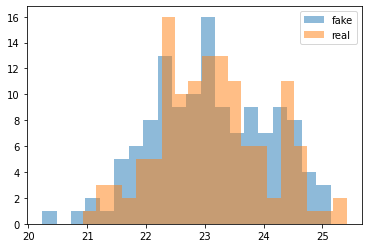

cum_dis_loss 0.2601133984178305, cum_gen_loss 0.26509744212031366


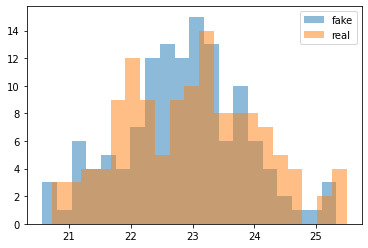

cum_dis_loss 0.26952507919073104, cum_gen_loss 0.2744571968913078


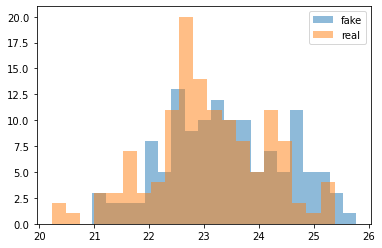

cum_dis_loss 0.2709190877974033, cum_gen_loss 0.26881710842251777


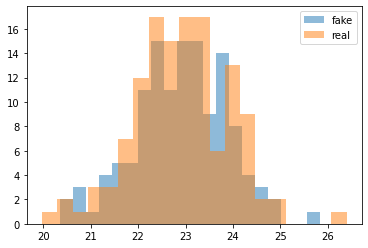

cum_dis_loss 0.2662053595781326, cum_gen_loss 0.26837427005171777


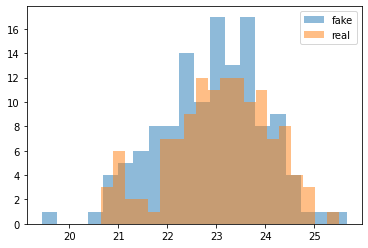

cum_dis_loss 0.2630561957657337, cum_gen_loss 0.2716857643425465


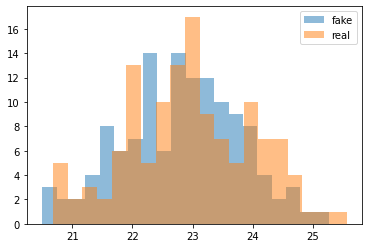

cum_dis_loss 0.27524408933520317, cum_gen_loss 0.27996317341923715


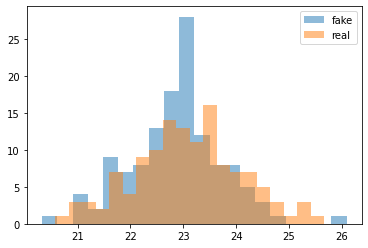

cum_dis_loss 0.2671086841523647, cum_gen_loss 0.26169155701994895


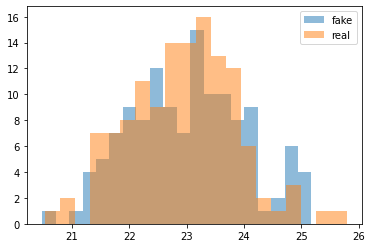

cum_dis_loss 0.26634200727939605, cum_gen_loss 0.26258822619915007


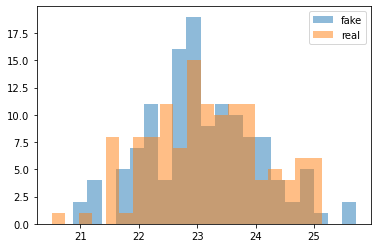

cum_dis_loss 0.26370949409902095, cum_gen_loss 0.27391733318567274


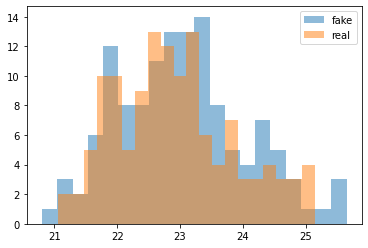

cum_dis_loss 0.2689399468898773, cum_gen_loss 0.2776218397915363


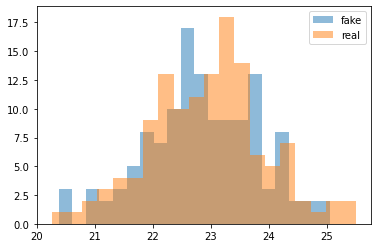

cum_dis_loss 0.26622613006830215, cum_gen_loss 0.2686501494050026


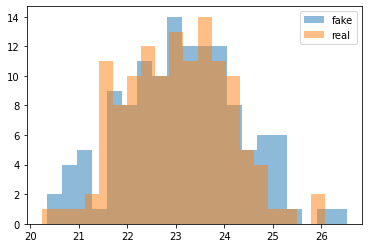

cum_dis_loss 0.2638002428710461, cum_gen_loss 0.2726639291644096


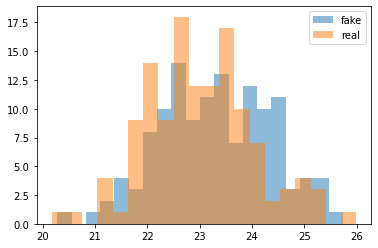

cum_dis_loss 0.26659050700068476, cum_gen_loss 0.2746161894500256


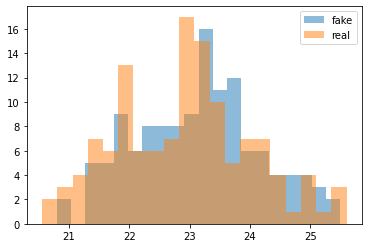

cum_dis_loss 0.2691570128798485, cum_gen_loss 0.26820780634880065


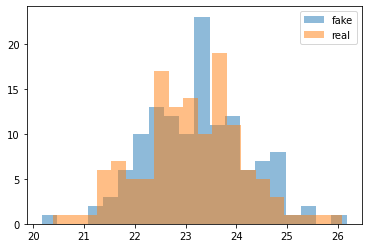

cum_dis_loss 0.26952583876252173, cum_gen_loss 0.2768818102777004


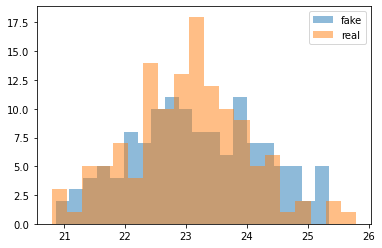

cum_dis_loss 0.27115787971019745, cum_gen_loss 0.2679870440065861


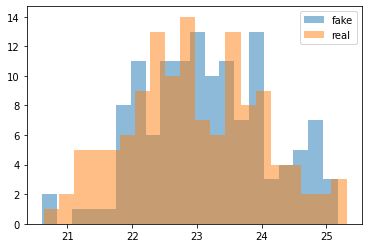

cum_dis_loss 0.2659906658679247, cum_gen_loss 0.26815040439367294


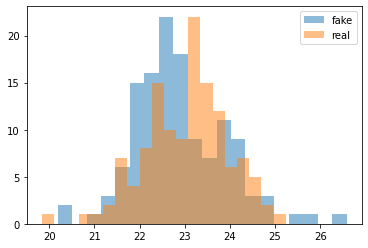

cum_dis_loss 0.271635621547699, cum_gen_loss 0.26826181903481483


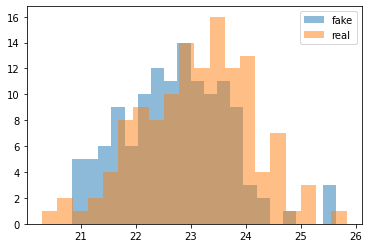

cum_dis_loss 0.2711932473182678, cum_gen_loss 0.2773486940562725


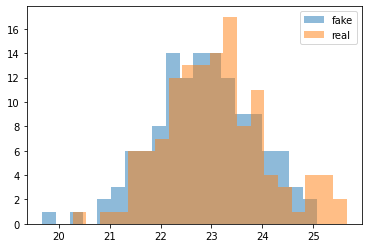

cum_dis_loss 0.26766004392504694, cum_gen_loss 0.2672967264056206


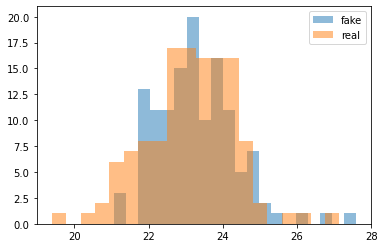

cum_dis_loss 0.2670617156624794, cum_gen_loss 0.27417594969272613


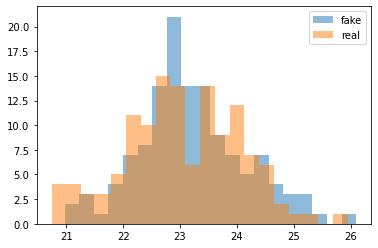

cum_dis_loss 0.2764198091328144, cum_gen_loss 0.27953446328639986


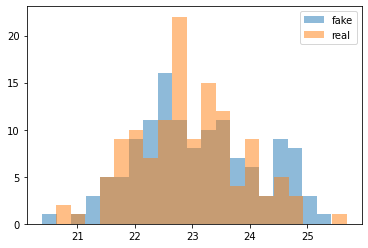

cum_dis_loss 0.26874193105101585, cum_gen_loss 0.268025032132864


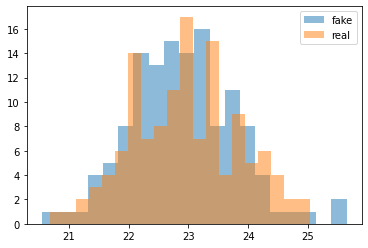

cum_dis_loss 0.2665718649327755, cum_gen_loss 0.2718099443614483


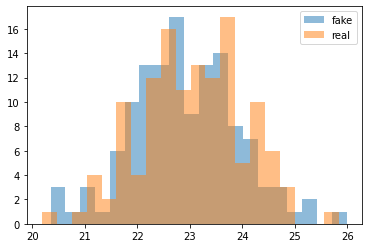

cum_dis_loss 0.26522689494490626, cum_gen_loss 0.2706582695245743


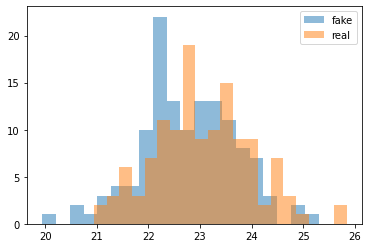

cum_dis_loss 0.2688353239297867, cum_gen_loss 0.2710517284274101


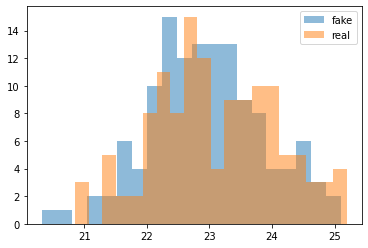

cum_dis_loss 0.2657898157835007, cum_gen_loss 0.26542809143662455


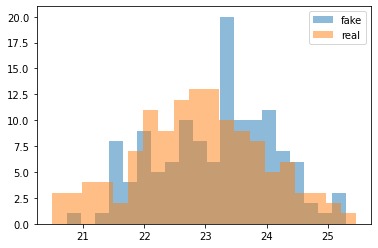

cum_dis_loss 0.26519236354529857, cum_gen_loss 0.27252312138676643


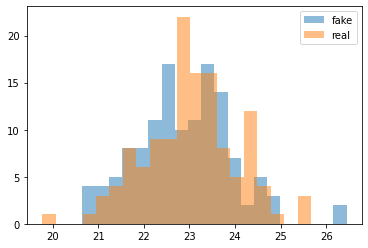

cum_dis_loss 0.26404795601964, cum_gen_loss 0.27507612109184265


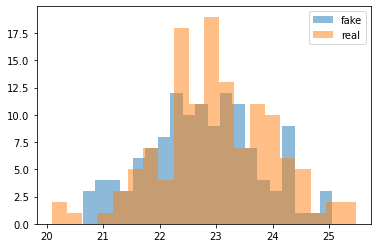

cum_dis_loss 0.2724290778934956, cum_gen_loss 0.27362535044550895


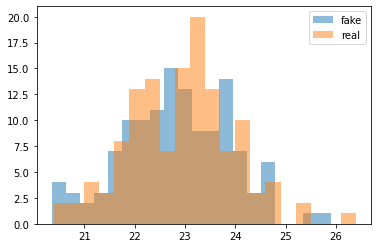

cum_dis_loss 0.2704059065282345, cum_gen_loss 0.2734950102865696


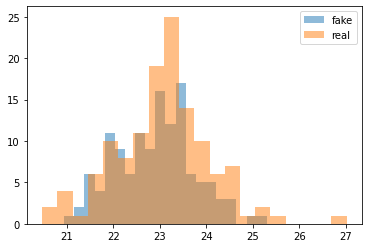

cum_dis_loss 0.26741936430335045, cum_gen_loss 0.27933220490813254


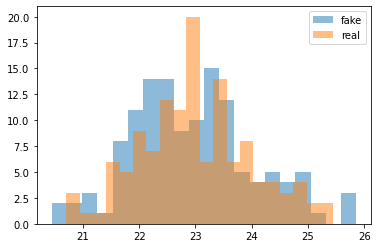

cum_dis_loss 0.2706029174029827, cum_gen_loss 0.26493497416377065


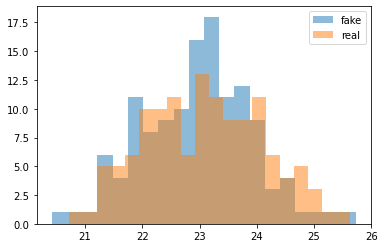

cum_dis_loss 0.27050235801935196, cum_gen_loss 0.27689728751778603


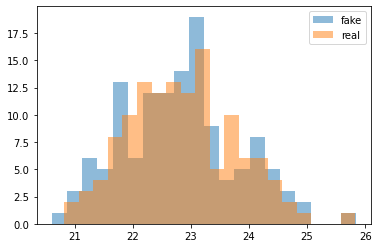

cum_dis_loss 0.2663403743207455, cum_gen_loss 0.28346566393971445


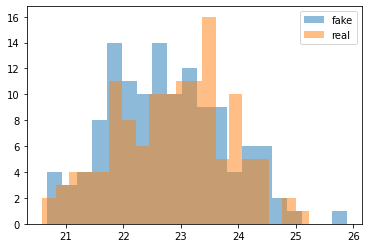

cum_dis_loss 0.2677361666858196, cum_gen_loss 0.273866336196661


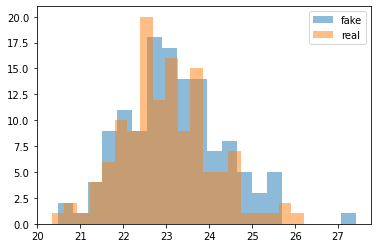

cum_dis_loss 0.2661454290449619, cum_gen_loss 0.27367945268750193


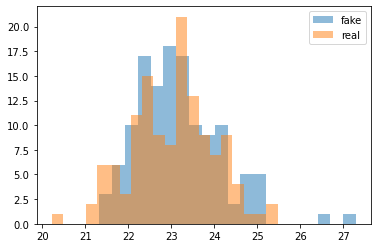

cum_dis_loss 0.26535804304480554, cum_gen_loss 0.2670218361914158


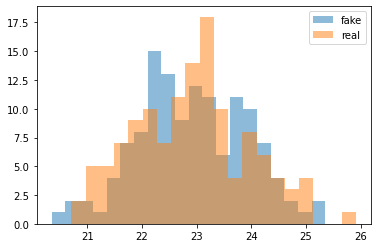

cum_dis_loss 0.26537944115698336, cum_gen_loss 0.27274628072977064


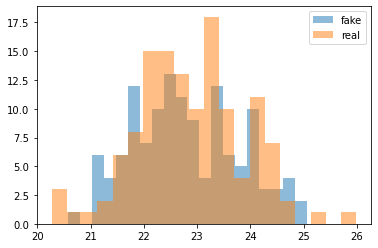

cum_dis_loss 0.27105689942836764, cum_gen_loss 0.27427244156599045


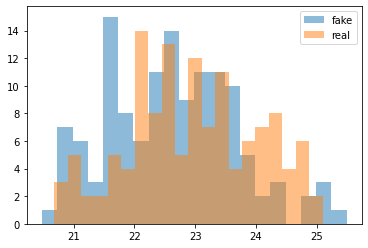

cum_dis_loss 0.26282885307073595, cum_gen_loss 0.2674751326441765


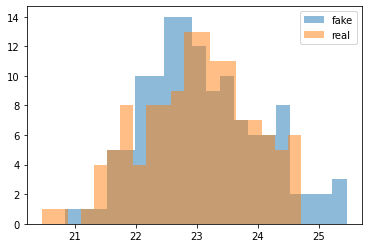

cum_dis_loss 0.2726441161930561, cum_gen_loss 0.27564531356096267


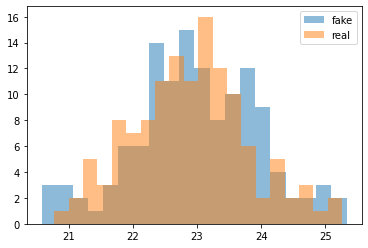

cum_dis_loss 0.2683573480844498, cum_gen_loss 0.26772071450948715


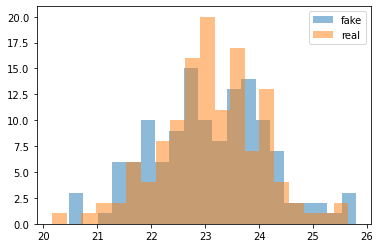

cum_dis_loss 0.27084208822250366, cum_gen_loss 0.27569963574409484


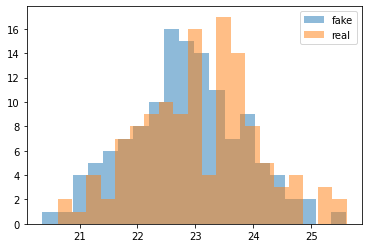

cum_dis_loss 0.2694338580071926, cum_gen_loss 0.26871413484215734


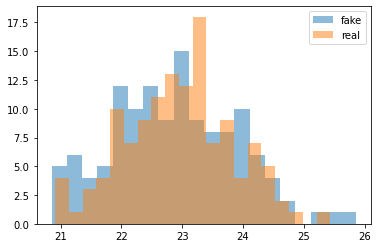

cum_dis_loss 0.2698012599647045, cum_gen_loss 0.26890848264098166


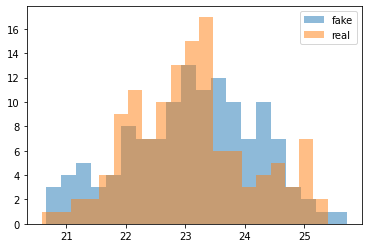

cum_dis_loss 0.27146504998207094, cum_gen_loss 0.27480024948716164


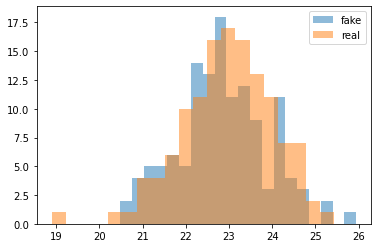

cum_dis_loss 0.2680506418645382, cum_gen_loss 0.27080625474452974


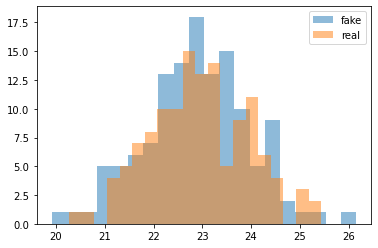

cum_dis_loss 0.26807594338059426, cum_gen_loss 0.27662585854530336


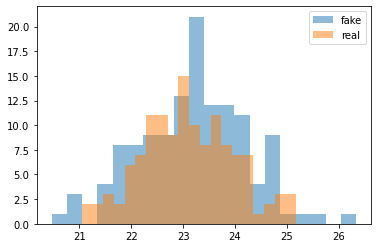

cum_dis_loss 0.2677051764726639, cum_gen_loss 0.2801580087840557


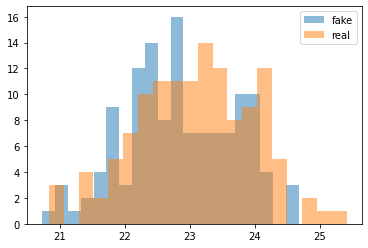

cum_dis_loss 0.2641941867470741, cum_gen_loss 0.2745315021276474


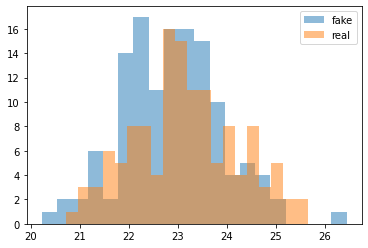

cum_dis_loss 0.2767427468895912, cum_gen_loss 0.28169082313776017


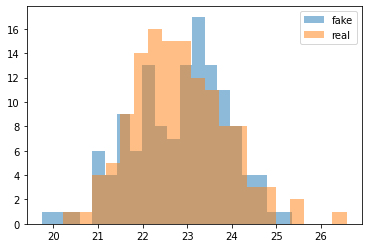

cum_dis_loss 0.26466003274917604, cum_gen_loss 0.26964799538254736


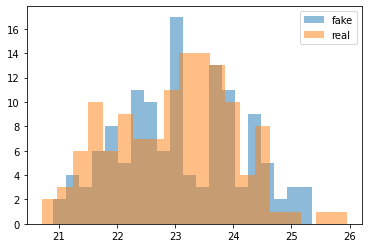

cum_dis_loss 0.2632104481458664, cum_gen_loss 0.2676642958819866


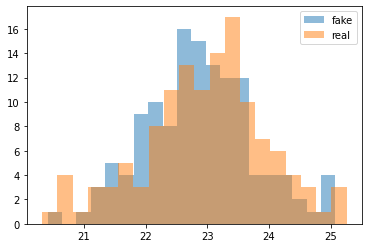

cum_dis_loss 0.2667576769590378, cum_gen_loss 0.2727609296143055


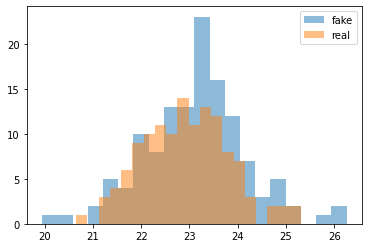

cum_dis_loss 0.2701863549947739, cum_gen_loss 0.27367174103856085


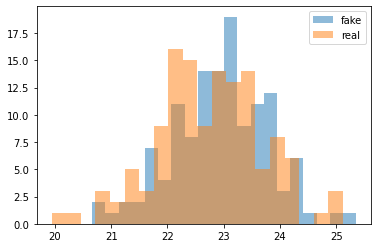

cum_dis_loss 0.27185653913021085, cum_gen_loss 0.265866309851408


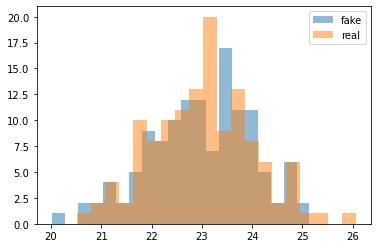

cum_dis_loss 0.26922510436177255, cum_gen_loss 0.26835050314664843


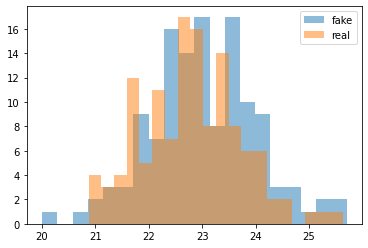

cum_dis_loss 0.26504179859161375, cum_gen_loss 0.26468739435076716


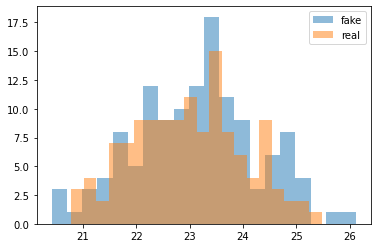

cum_dis_loss 0.2692625607252121, cum_gen_loss 0.26496368169784545


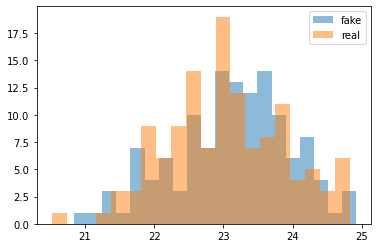

cum_dis_loss 0.2687562358677387, cum_gen_loss 0.27399671509861945


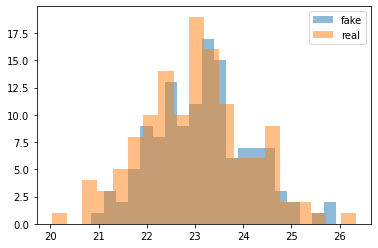

cum_dis_loss 0.26983667385578153, cum_gen_loss 0.27221793606877326


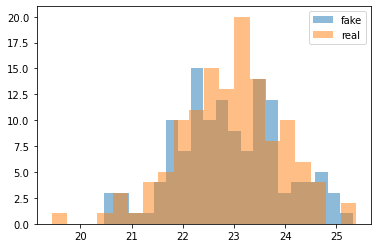

cum_dis_loss 0.2671381504237652, cum_gen_loss 0.27280986443161964


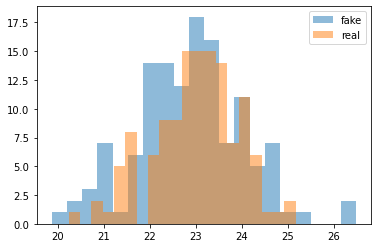

cum_dis_loss 0.2658619962632656, cum_gen_loss 0.27187885880470275


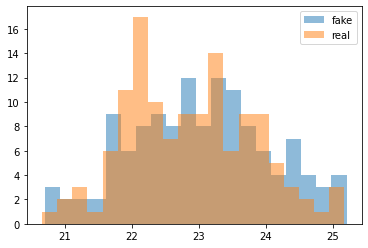

cum_dis_loss 0.2677638794183731, cum_gen_loss 0.27219539269804954


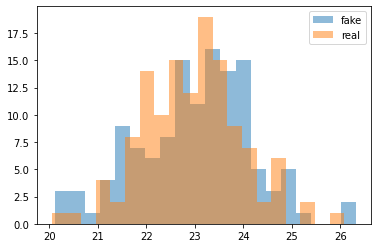

cum_dis_loss 0.2662053223848343, cum_gen_loss 0.2723836821317673


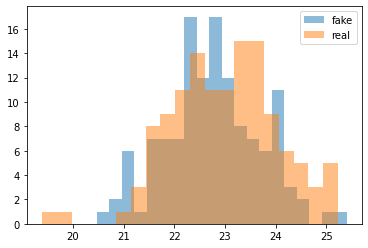

cum_dis_loss 0.2670798408389091, cum_gen_loss 0.2765654458105564


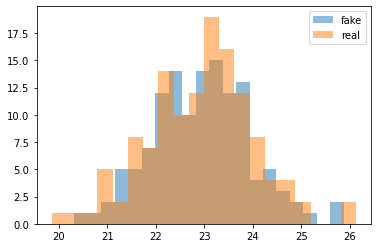

cum_dis_loss 0.267146724909544, cum_gen_loss 0.2723454250395298


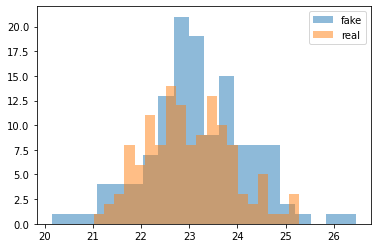

cum_dis_loss 0.2709787582159042, cum_gen_loss 0.2737447687983513


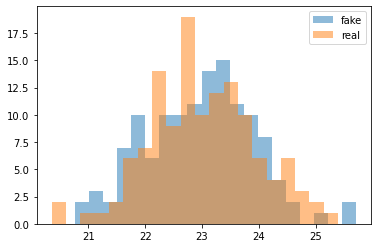

cum_dis_loss 0.2692251565158367, cum_gen_loss 0.2797133085131645


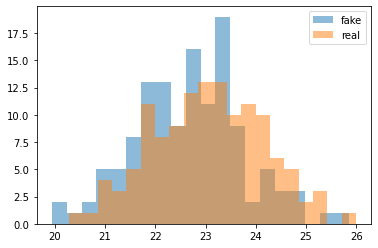

cum_dis_loss 0.2735751896202564, cum_gen_loss 0.2743295335769653


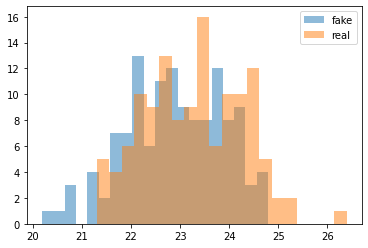

cum_dis_loss 0.265460506260395, cum_gen_loss 0.26719594329595564


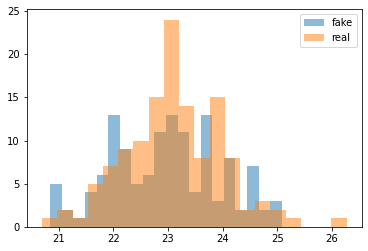

cum_dis_loss 0.26836855719983577, cum_gen_loss 0.268372872620821


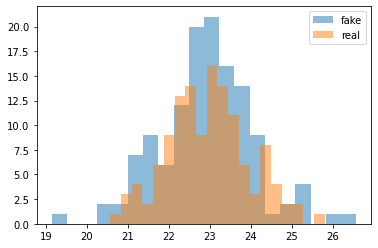

cum_dis_loss 0.2651572742164135, cum_gen_loss 0.27157342866063117


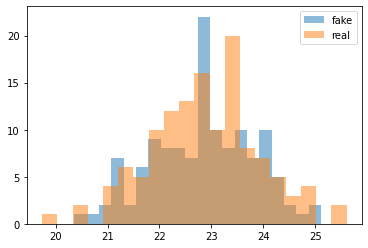

cum_dis_loss 0.26966570496559145, cum_gen_loss 0.2743289847671986


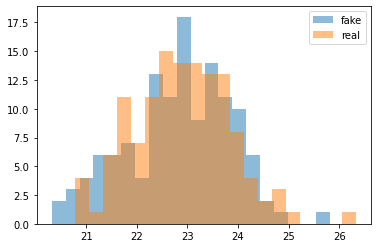

cum_dis_loss 0.2653991121053696, cum_gen_loss 0.27000492259860037


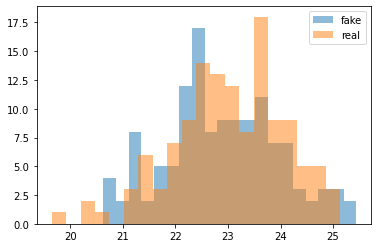

cum_dis_loss 0.26639017471671106, cum_gen_loss 0.2754384370148182


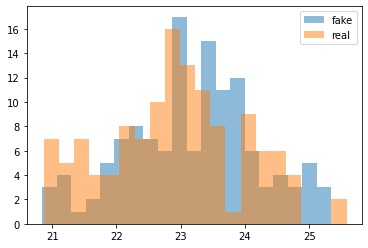

cum_dis_loss 0.2666097632050514, cum_gen_loss 0.2676534868776798


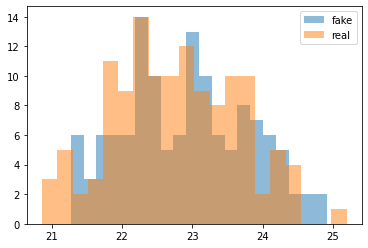

cum_dis_loss 0.26924029383063314, cum_gen_loss 0.27120828002691266


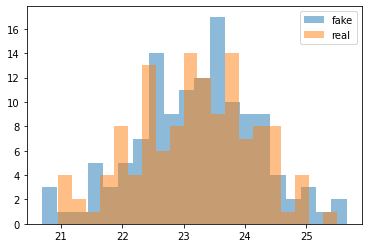

cum_dis_loss 0.2689178626537323, cum_gen_loss 0.27419687047600744


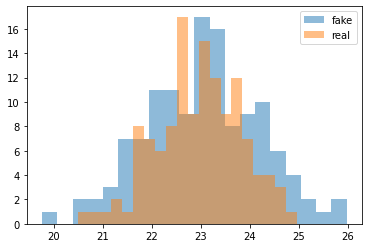

cum_dis_loss 0.269534442782402, cum_gen_loss 0.28199555456638337


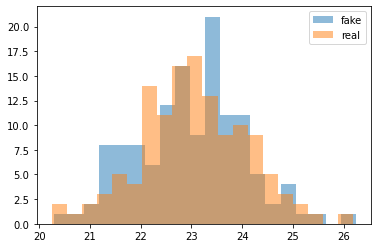

cum_dis_loss 0.26939395049214365, cum_gen_loss 0.26714745685458186


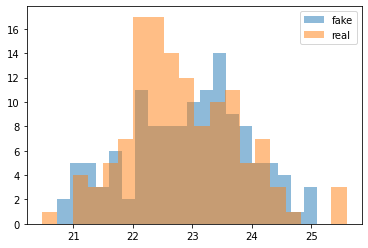

cum_dis_loss 0.26993394711613655, cum_gen_loss 0.2782694971561432


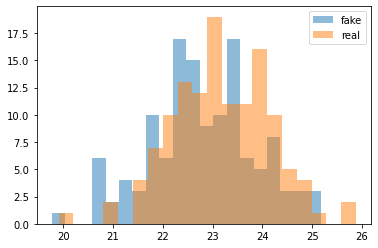

cum_dis_loss 0.27191329592466357, cum_gen_loss 0.2641605478525162


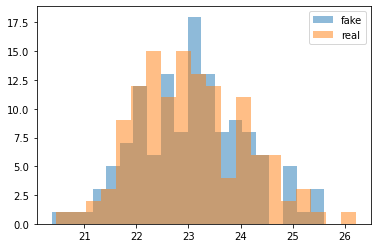

cum_dis_loss 0.2663354099094868, cum_gen_loss 0.26999558821320535


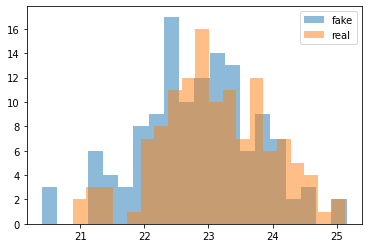

cum_dis_loss 0.2659260841906071, cum_gen_loss 0.26968433916568757


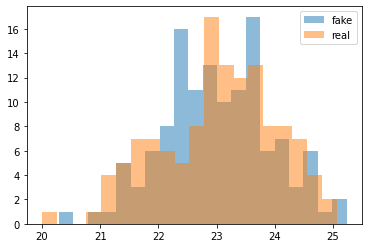

cum_dis_loss 0.26918607333302497, cum_gen_loss 0.27417524456977843


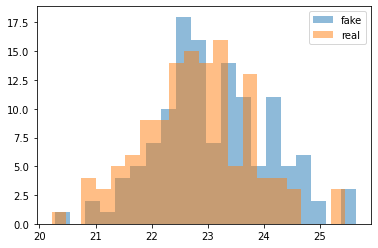

cum_dis_loss 0.26918675397336483, cum_gen_loss 0.2717916722595692


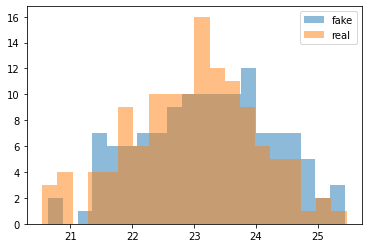

cum_dis_loss 0.28211353680491447, cum_gen_loss 0.28258183002471926


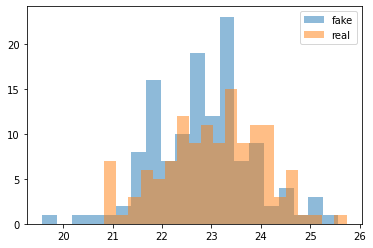

cum_dis_loss 0.2668604611158371, cum_gen_loss 0.27527587905526163


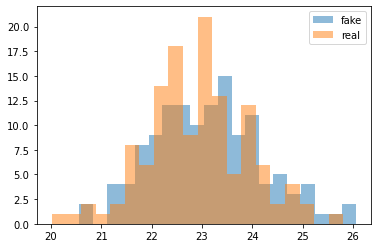

cum_dis_loss 0.2698711983859539, cum_gen_loss 0.28319923132658004


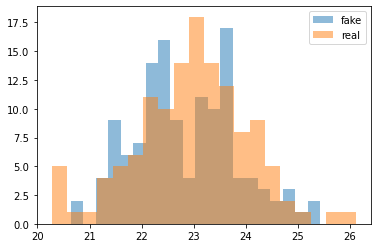

cum_dis_loss 0.2716584425866604, cum_gen_loss 0.27173120573163034


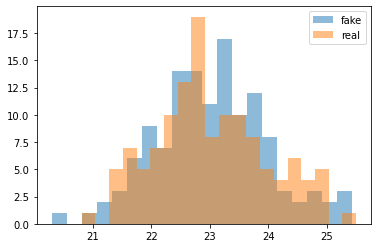

cum_dis_loss 0.2664889482855797, cum_gen_loss 0.2679317644238472


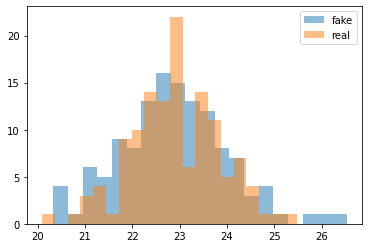

cum_dis_loss 0.26474941210448744, cum_gen_loss 0.26905899107456205


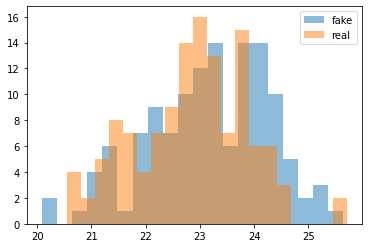

cum_dis_loss 0.2684837917983532, cum_gen_loss 0.2705091385543346


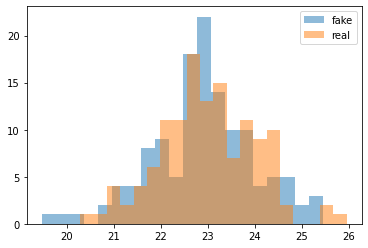

cum_dis_loss 0.2718301683664322, cum_gen_loss 0.28219168379902837


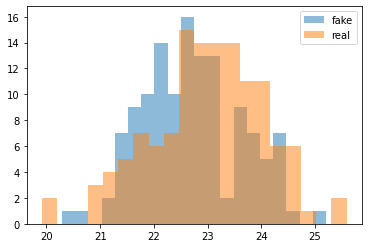

cum_dis_loss 0.2771468381881714, cum_gen_loss 0.28416439309716224


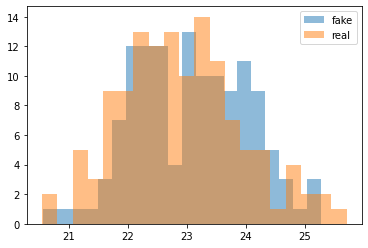

cum_dis_loss 0.27829034331440927, cum_gen_loss 0.27392321690917015


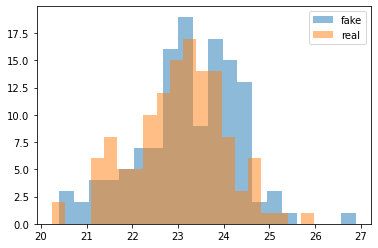

cum_dis_loss 0.27208678886294363, cum_gen_loss 0.2712613387405872


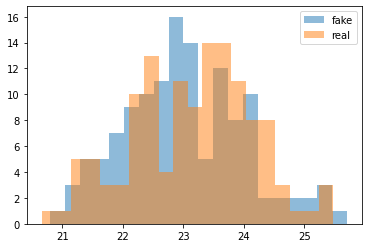

cum_dis_loss 0.2679534395635128, cum_gen_loss 0.27777747362852095


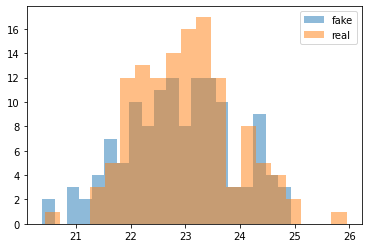

cum_dis_loss 0.2726269888281822, cum_gen_loss 0.27528338745236397


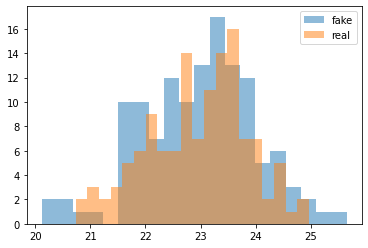

cum_dis_loss 0.2714357166290283, cum_gen_loss 0.26863144531846045


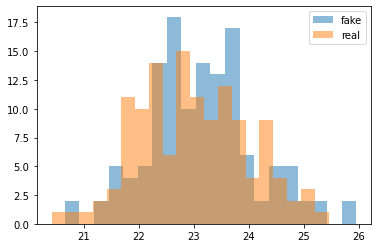

cum_dis_loss 0.26508707335591314, cum_gen_loss 0.2687321962416172


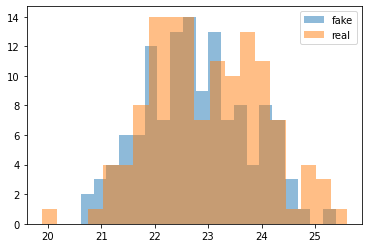

cum_dis_loss 0.26835685724020003, cum_gen_loss 0.27169706344604494


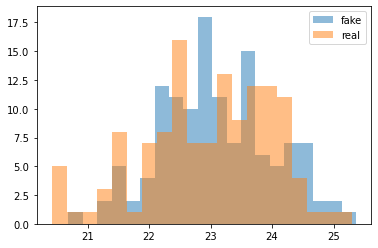

cum_dis_loss 0.2712526133954525, cum_gen_loss 0.27270607978105543


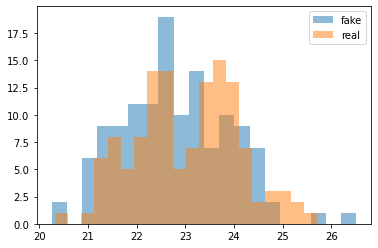

cum_dis_loss 0.27278034207224844, cum_gen_loss 0.27346389800310134


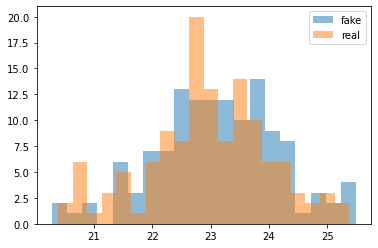

cum_dis_loss 0.2752948627471924, cum_gen_loss 0.282294198423624


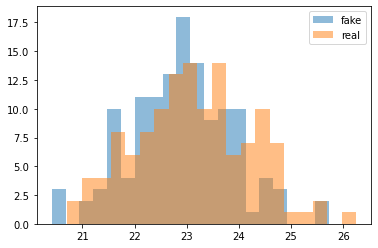

cum_dis_loss 0.267096912831068, cum_gen_loss 0.2719598980247974


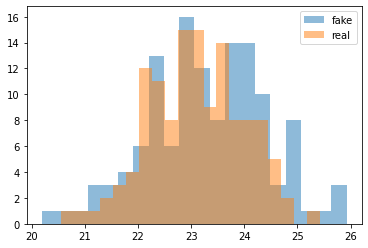

cum_dis_loss 0.27216643303632737, cum_gen_loss 0.26832628533244135


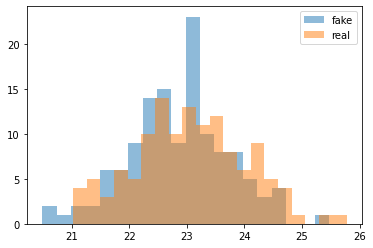

cum_dis_loss 0.2749644549787045, cum_gen_loss 0.2752147804200649


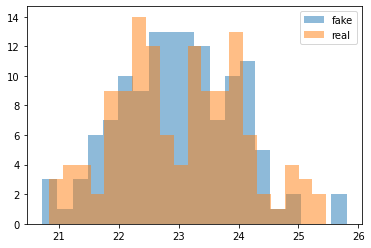

cum_dis_loss 0.2709340506494045, cum_gen_loss 0.27686729669570925


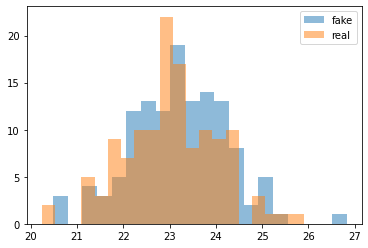

cum_dis_loss 0.26826689153909683, cum_gen_loss 0.2731275759637356


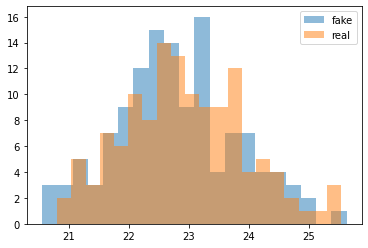

cum_dis_loss 0.27310931092500684, cum_gen_loss 0.2699543617665768


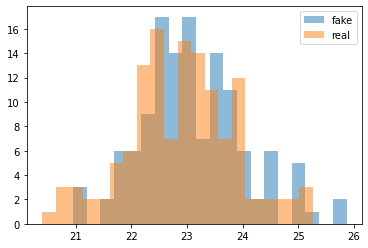

cum_dis_loss 0.2718822011947632, cum_gen_loss 0.2746970197558403


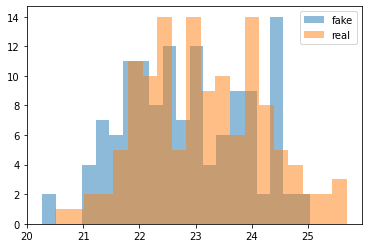

cum_dis_loss 0.2717006752192974, cum_gen_loss 0.27553882881999014


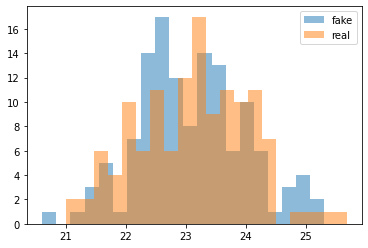

cum_dis_loss 0.26871255484223366, cum_gen_loss 0.2690053915977478


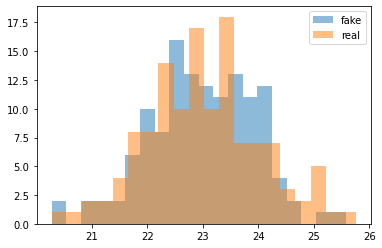

cum_dis_loss 0.26910358130931855, cum_gen_loss 0.27385994881391523


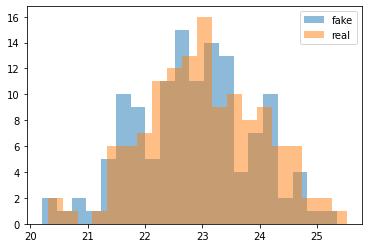

cum_dis_loss 0.26881537392735483, cum_gen_loss 0.269476358294487


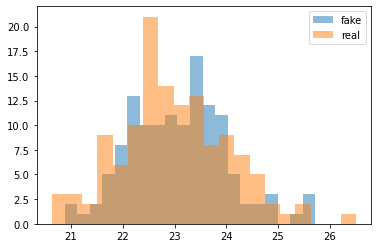

cum_dis_loss 0.2657518515586853, cum_gen_loss 0.26899137526750566


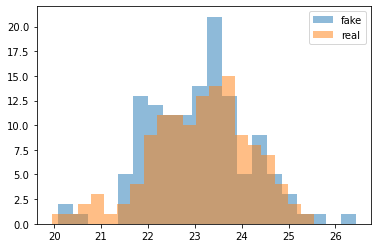

cum_dis_loss 0.2681306501328945, cum_gen_loss 0.27808355063199997


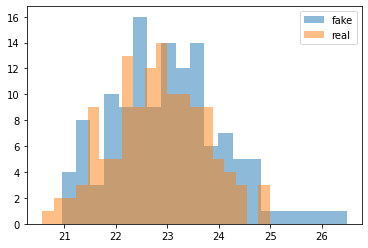

cum_dis_loss 0.2692094365358353, cum_gen_loss 0.2790572154521942


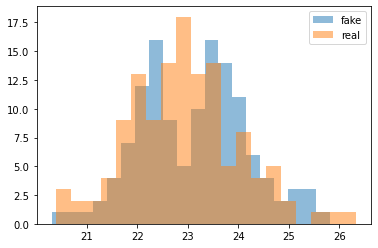

cum_dis_loss 0.26832719537615773, cum_gen_loss 0.2713093487918377


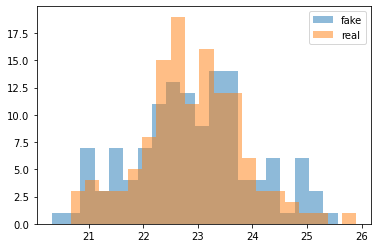

cum_dis_loss 0.271517509162426, cum_gen_loss 0.2801906080543995


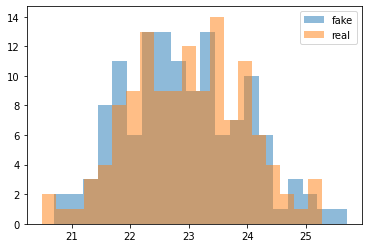

cum_dis_loss 0.2715461366176605, cum_gen_loss 0.27206045165658


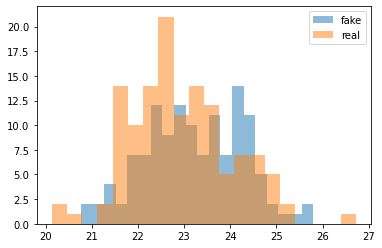

cum_dis_loss 0.26562006771564484, cum_gen_loss 0.27006458401679995


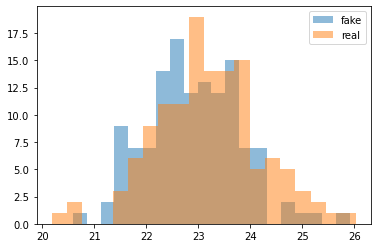

cum_dis_loss 0.26913245329260826, cum_gen_loss 0.26493594482541083


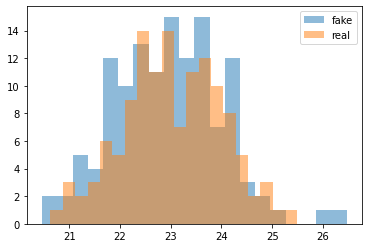

cum_dis_loss 0.27564849469065666, cum_gen_loss 0.2753606215119362


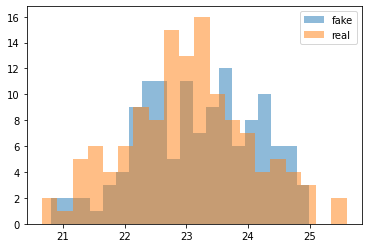

cum_dis_loss 0.2813348894715309, cum_gen_loss 0.2824085509777069


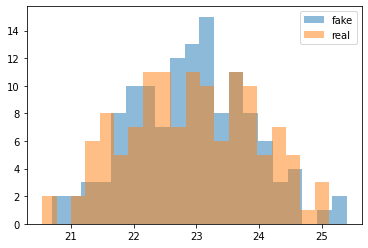

cum_dis_loss 0.2675634543597698, cum_gen_loss 0.27362808868288996


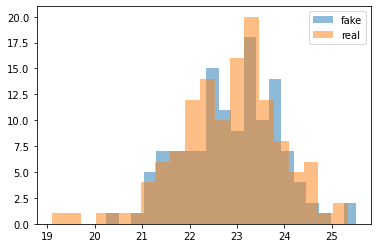

cum_dis_loss 0.27943388161063193, cum_gen_loss 0.28443473652005197


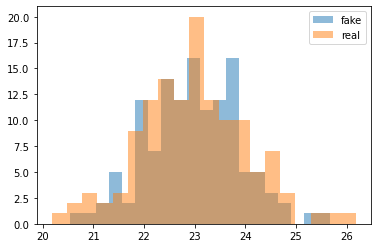

cum_dis_loss 0.27030427849292754, cum_gen_loss 0.27946032136678695


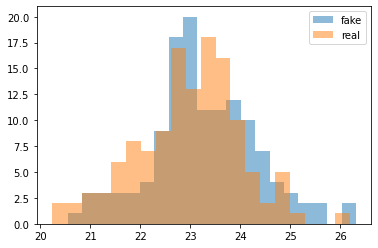

cum_dis_loss 0.26702196323871613, cum_gen_loss 0.26969262570142744


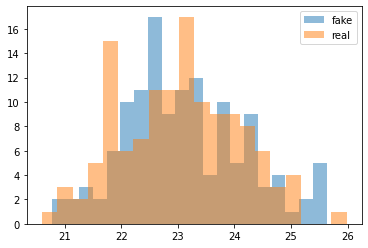

cum_dis_loss 0.2836903290450573, cum_gen_loss 0.2848149174451828


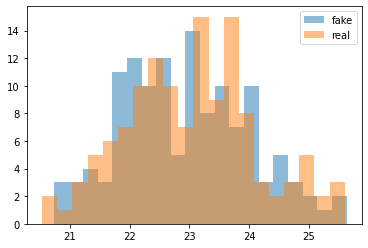

cum_dis_loss 0.27035958909988406, cum_gen_loss 0.2699494901299477


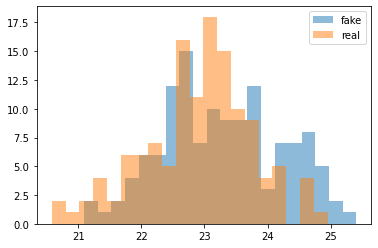

cum_dis_loss 0.27548504874110225, cum_gen_loss 0.2785424539446831


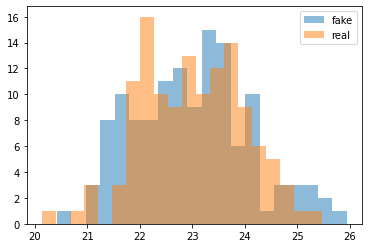

cum_dis_loss 0.2691162748038769, cum_gen_loss 0.27958741545677185


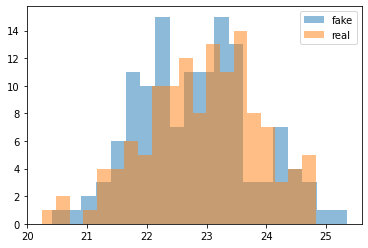

cum_dis_loss 0.2660042813569307, cum_gen_loss 0.27073347076773646


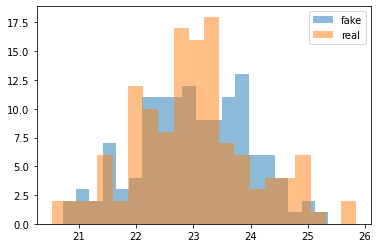

cum_dis_loss 0.27534463289380073, cum_gen_loss 0.2733613088726997


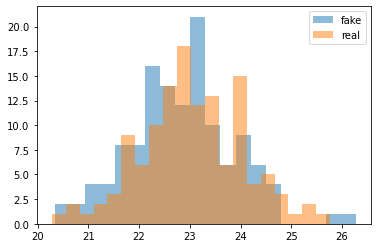

cum_dis_loss 0.2689861842095852, cum_gen_loss 0.2689706763625145


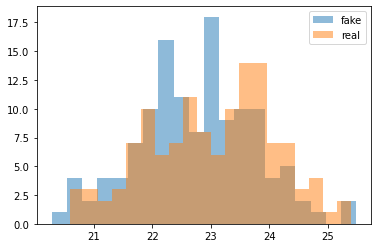

cum_dis_loss 0.2667267727553844, cum_gen_loss 0.27046068012714386


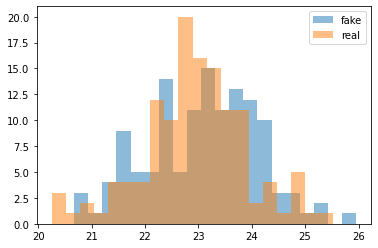

cum_dis_loss 0.2703356917202473, cum_gen_loss 0.2747920303046703


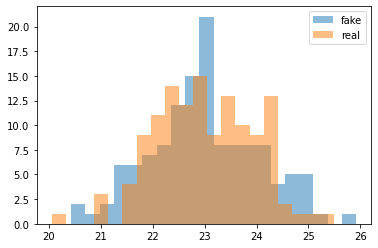

cum_dis_loss 0.26928340032696724, cum_gen_loss 0.26581945553421976


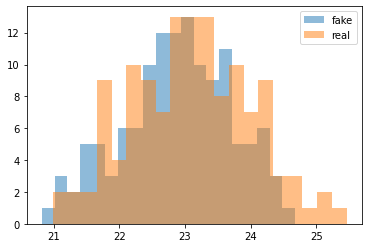

cum_dis_loss 0.2740718124508858, cum_gen_loss 0.27289453223347665


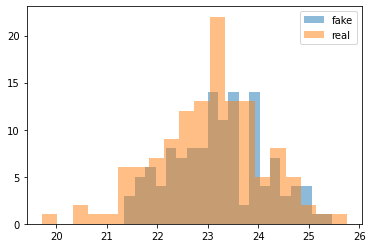

cum_dis_loss 0.27259556606411933, cum_gen_loss 0.2820489192008972


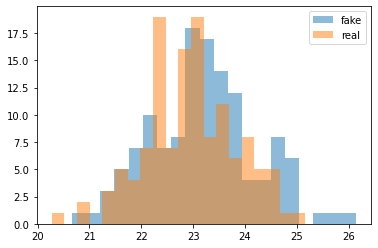

cum_dis_loss 0.2812590727210045, cum_gen_loss 0.28758807718753815


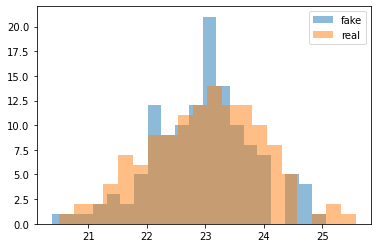

cum_dis_loss 0.26647142285108566, cum_gen_loss 0.27138458624482154


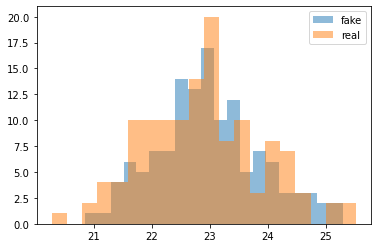

cum_dis_loss 0.26828771096467974, cum_gen_loss 0.2694157911837101


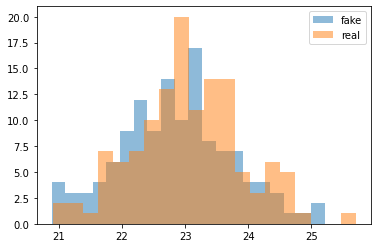

cum_dis_loss 0.2683191532343626, cum_gen_loss 0.26762429386377334


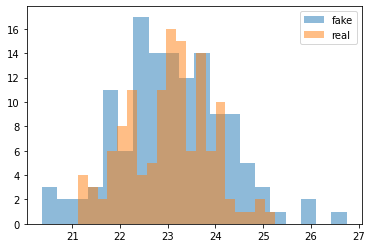

cum_dis_loss 0.26968034128844737, cum_gen_loss 0.2737729434669018


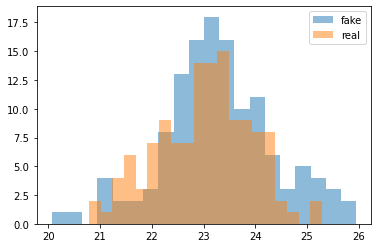

cum_dis_loss 0.2686889267265797, cum_gen_loss 0.2688692760467529


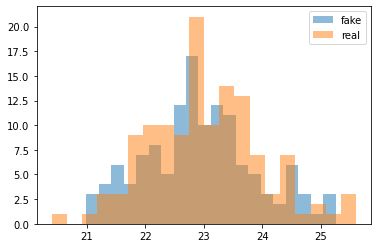

cum_dis_loss 0.2679741711318493, cum_gen_loss 0.27110246241092684


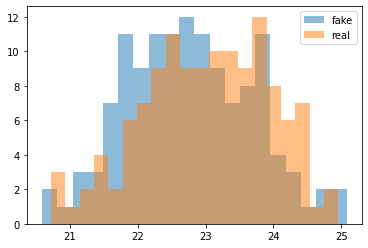

cum_dis_loss 0.27291781932115555, cum_gen_loss 0.27318826124072076


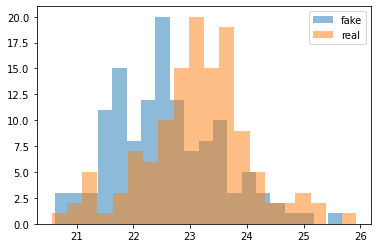

cum_dis_loss 0.2761814641058445, cum_gen_loss 0.2741338813304901


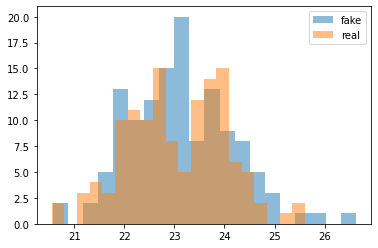

cum_dis_loss 0.26865602588653564, cum_gen_loss 0.27279587134718897


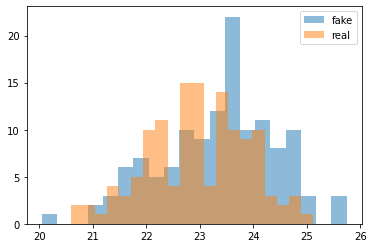

cum_dis_loss 0.2707776379287243, cum_gen_loss 0.2786367340385914


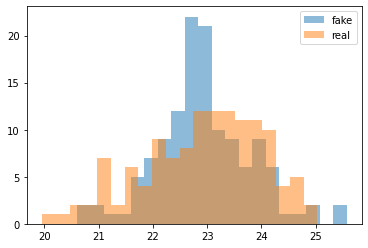

cum_dis_loss 0.27131847485899924, cum_gen_loss 0.27341033667325976


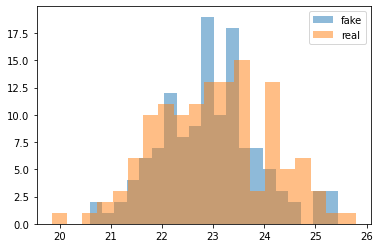

cum_dis_loss 0.2723299222886562, cum_gen_loss 0.27119011953473093


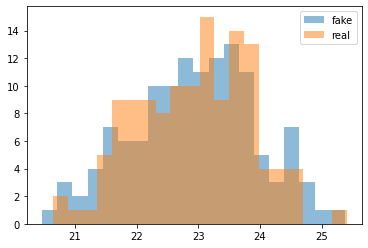

cum_dis_loss 0.27637657102942464, cum_gen_loss 0.2789105376601219


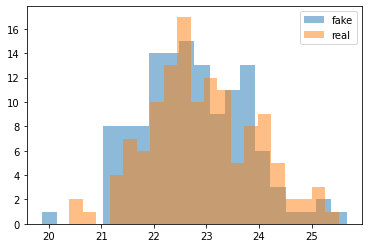

cum_dis_loss 0.2801922317743301, cum_gen_loss 0.2811174815893173


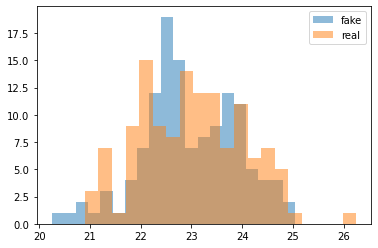

cum_dis_loss 0.27010355406999587, cum_gen_loss 0.2723721368610859


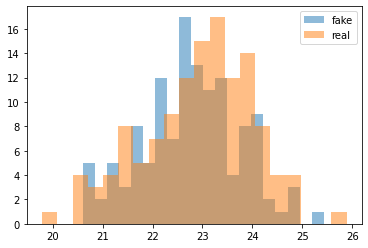

cum_dis_loss 0.26687155693769454, cum_gen_loss 0.27543063506484033


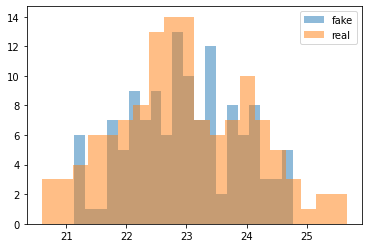

cum_dis_loss 0.27024243807792664, cum_gen_loss 0.27103975087404253


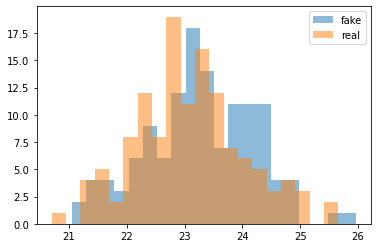

cum_dis_loss 0.27312367337942123, cum_gen_loss 0.2789859712123871


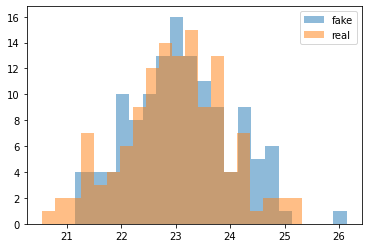

cum_dis_loss 0.27045853811502457, cum_gen_loss 0.273782110363245


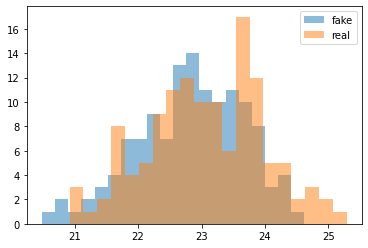

cum_dis_loss 0.2696268571615219, cum_gen_loss 0.27156205669045447


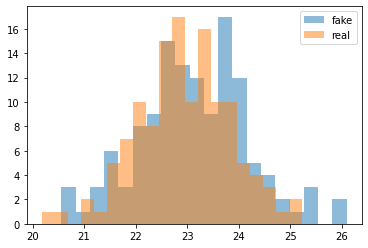

cum_dis_loss 0.26882894879579544, cum_gen_loss 0.2713431388139725


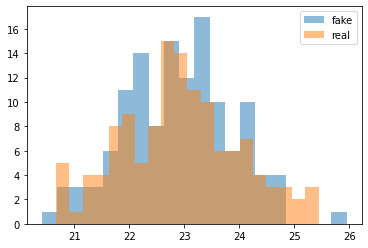

cum_dis_loss 0.26614080733060835, cum_gen_loss 0.2683686922490597


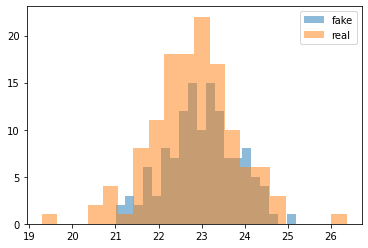

cum_dis_loss 0.2653887502849102, cum_gen_loss 0.2746986073255539


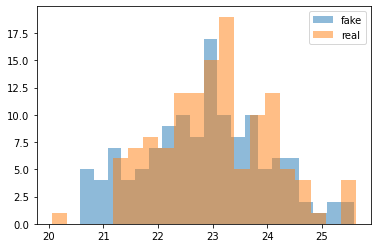

cum_dis_loss 0.27235683454573156, cum_gen_loss 0.2771287213265896


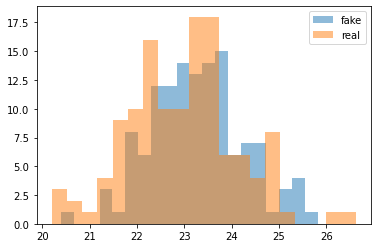

cum_dis_loss 0.27214896509051323, cum_gen_loss 0.2724038352072239


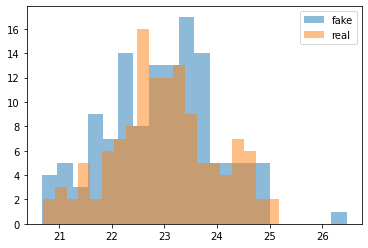

cum_dis_loss 0.2765454209148884, cum_gen_loss 0.2737837368249893


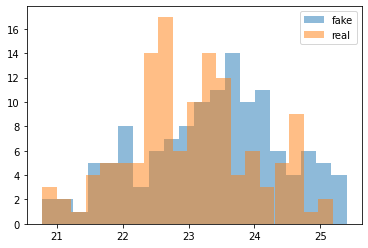

cum_dis_loss 0.26940366593003273, cum_gen_loss 0.27531982585787773


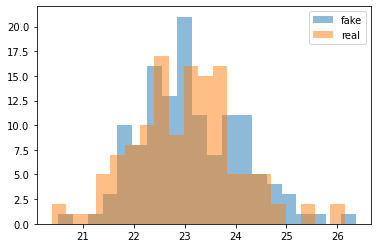

cum_dis_loss 0.27666915601491926, cum_gen_loss 0.2793720731139183


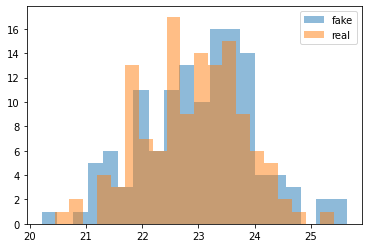

cum_dis_loss 0.274573746830225, cum_gen_loss 0.2761878100037575


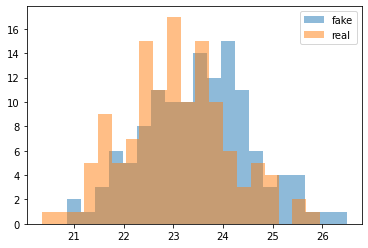

cum_dis_loss 0.2686524935364723, cum_gen_loss 0.27306169033050537


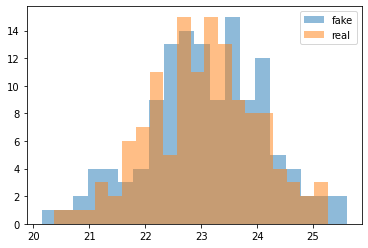

cum_dis_loss 0.2714087369441986, cum_gen_loss 0.2694817024469376


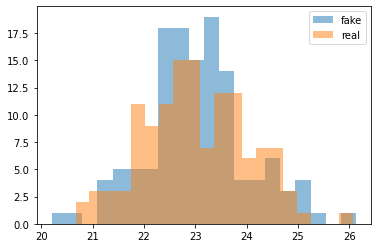

cum_dis_loss 0.26861281472444537, cum_gen_loss 0.2670894727110863


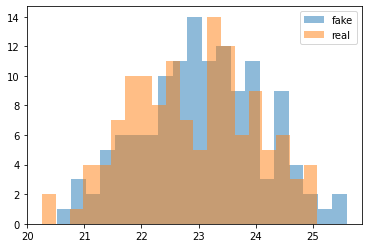

cum_dis_loss 0.2671798519641161, cum_gen_loss 0.2728911045193672


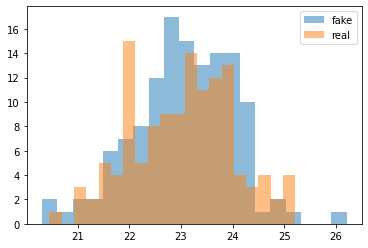

cum_dis_loss 0.27309502628445625, cum_gen_loss 0.27986031398177147


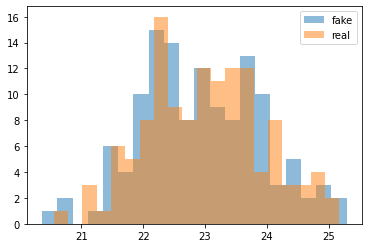

cum_dis_loss 0.2704790343940258, cum_gen_loss 0.26969525709748265


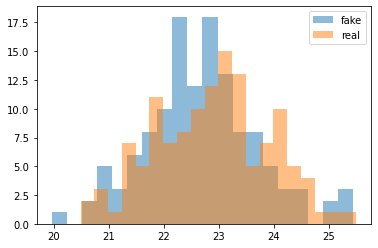

cum_dis_loss 0.27212126848101614, cum_gen_loss 0.2810606816411018


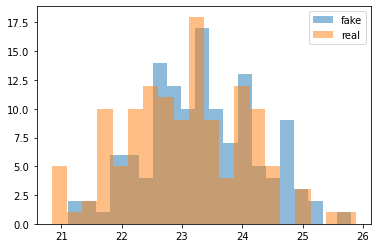

cum_dis_loss 0.2683124737739563, cum_gen_loss 0.2709364269673824


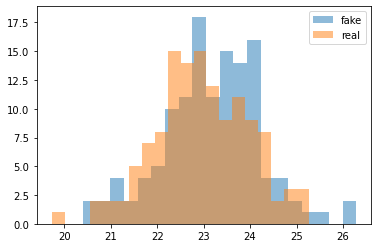

cum_dis_loss 0.269014066696167, cum_gen_loss 0.2693755768239498


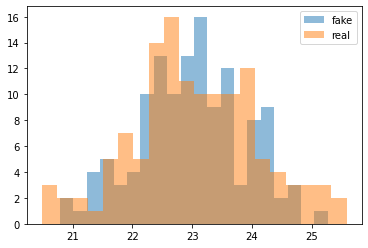

cum_dis_loss 0.2709357279241085, cum_gen_loss 0.2760288833081722


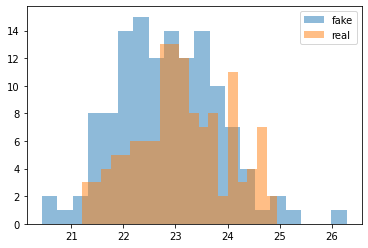

cum_dis_loss 0.2670958966910839, cum_gen_loss 0.2713242085278034


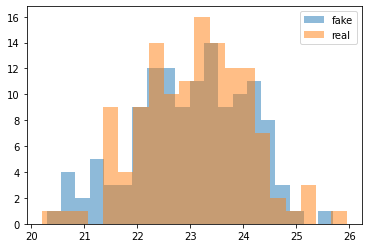

cum_dis_loss 0.2680343432724476, cum_gen_loss 0.2630139401555061


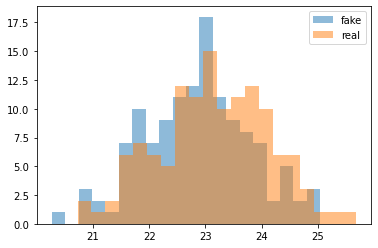

cum_dis_loss 0.26816910976171493, cum_gen_loss 0.27245510667562484


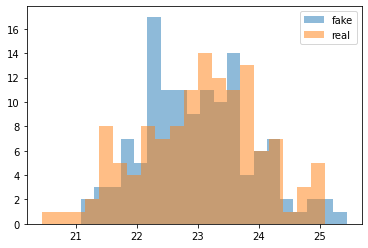

cum_dis_loss 0.2676240834891796, cum_gen_loss 0.2670398461818695


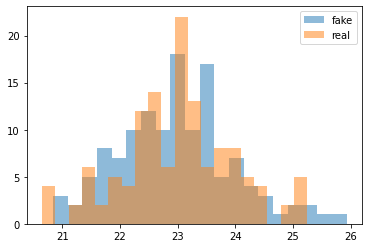

cum_dis_loss 0.2721779330074787, cum_gen_loss 0.2689481757581234


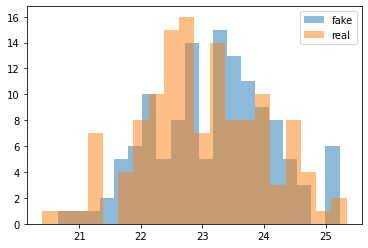

cum_dis_loss 0.27082272359728815, cum_gen_loss 0.2745583061873913


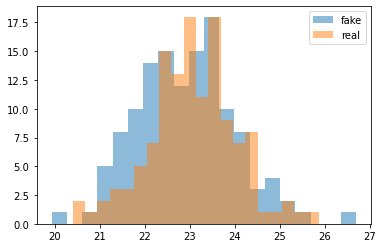

cum_dis_loss 0.2704610706269741, cum_gen_loss 0.27200164064764976


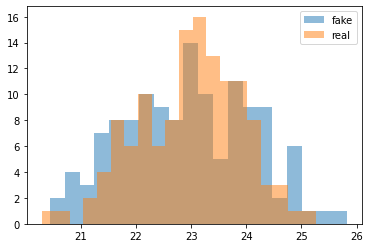

cum_dis_loss 0.2704574617445469, cum_gen_loss 0.2787688234448433


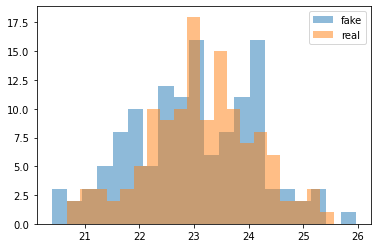

cum_dis_loss 0.2761270388364792, cum_gen_loss 0.2759737804532051


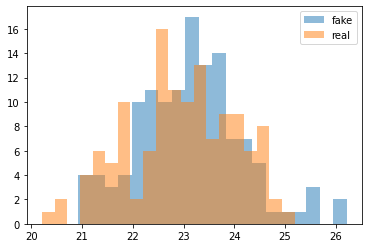

cum_dis_loss 0.27062297135591507, cum_gen_loss 0.2725656938552856


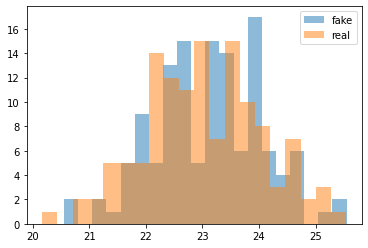

cum_dis_loss 0.2709908276498318, cum_gen_loss 0.2769224390387535


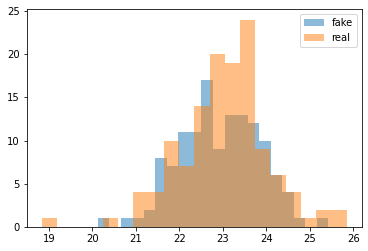

cum_dis_loss 0.2675649594962597, cum_gen_loss 0.27263703554868696


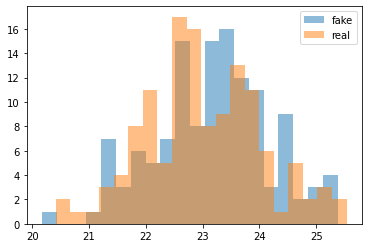

cum_dis_loss 0.26779795280098917, cum_gen_loss 0.2690544259548187


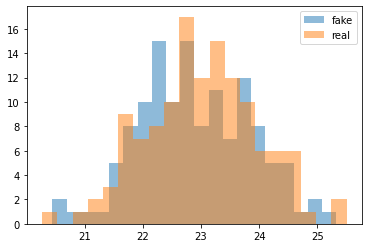

cum_dis_loss 0.2689331665635109, cum_gen_loss 0.28235909938812254


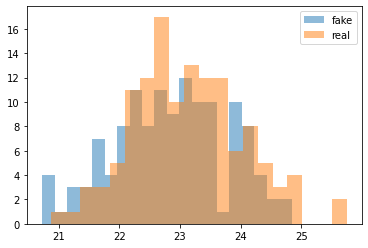

cum_dis_loss 0.27038539895415303, cum_gen_loss 0.2744603545963764


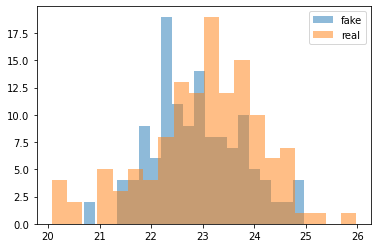

cum_dis_loss 0.2699887385368347, cum_gen_loss 0.26897425055503843


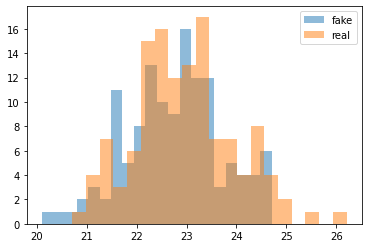

cum_dis_loss 0.2682964402139187, cum_gen_loss 0.2729160822927952


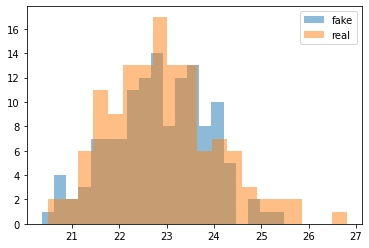

cum_dis_loss 0.2724025942087173, cum_gen_loss 0.27675924271345137


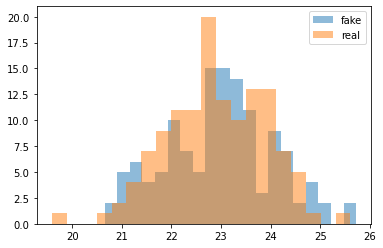

cum_dis_loss 0.2683630895614624, cum_gen_loss 0.2689982733130455


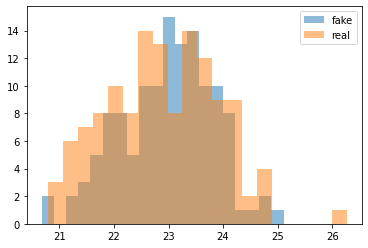

cum_dis_loss 0.273232102394104, cum_gen_loss 0.273439132720232


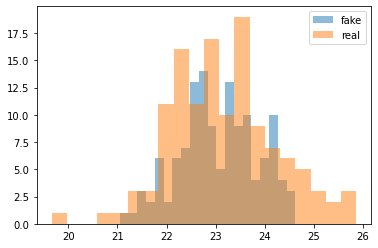

cum_dis_loss 0.27856040808558463, cum_gen_loss 0.2790400606393814


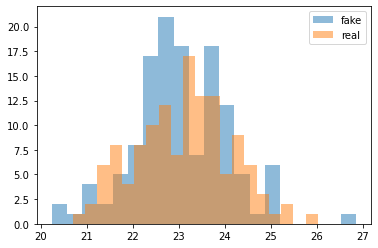

cum_dis_loss 0.26877074897289277, cum_gen_loss 0.2761304186284542


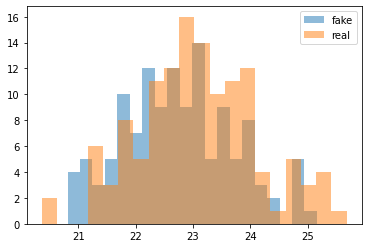

cum_dis_loss 0.2763273492157459, cum_gen_loss 0.27578113675117494


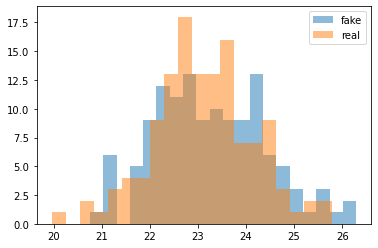

cum_dis_loss 0.26923684594035147, cum_gen_loss 0.26958691626787185


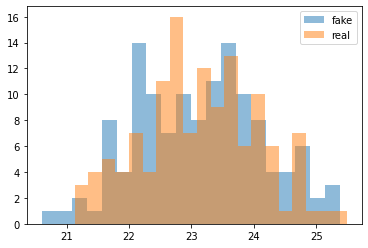

cum_dis_loss 0.2709427899122238, cum_gen_loss 0.2751499588787556


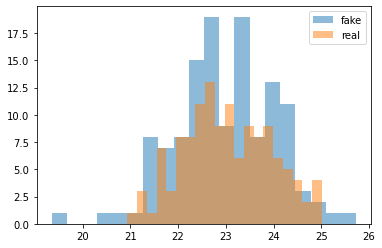

cum_dis_loss 0.2679649491906166, cum_gen_loss 0.2704113292694092


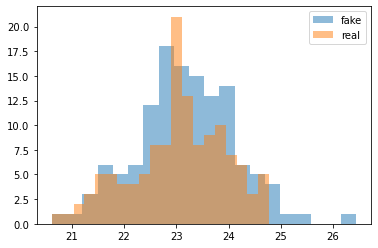

cum_dis_loss 0.2790326611697674, cum_gen_loss 0.28256141871213913


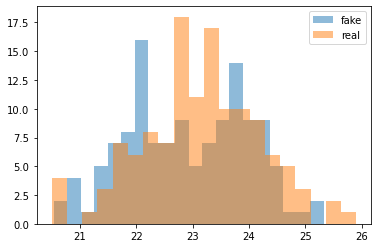

cum_dis_loss 0.2678101999759674, cum_gen_loss 0.2720514723658562


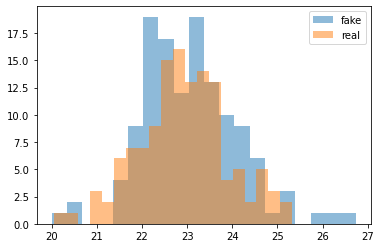

cum_dis_loss 0.2718188623189926, cum_gen_loss 0.2732619845867157


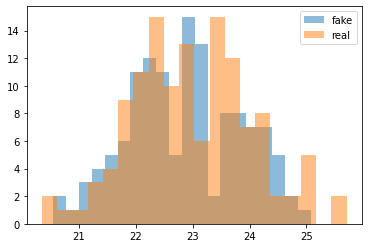

cum_dis_loss 0.272471922069788, cum_gen_loss 0.271113995462656


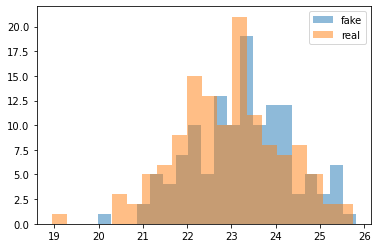

cum_dis_loss 0.2700541114807129, cum_gen_loss 0.27546712443232535


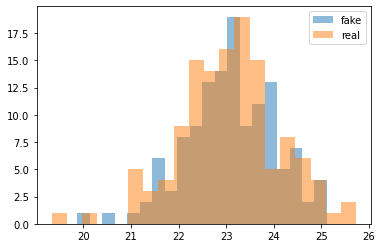

cum_dis_loss 0.26873139131069185, cum_gen_loss 0.2810279865562916


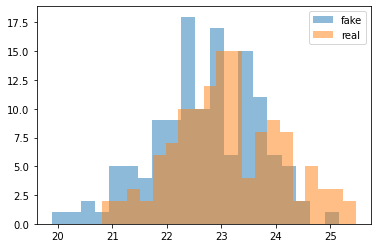

cum_dis_loss 0.2686340952813625, cum_gen_loss 0.27097220927476884


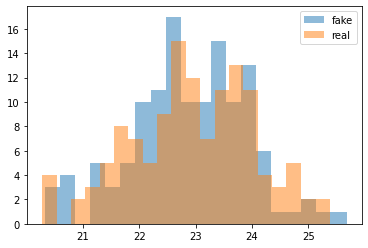

cum_dis_loss 0.27069945773482323, cum_gen_loss 0.27171276450157167


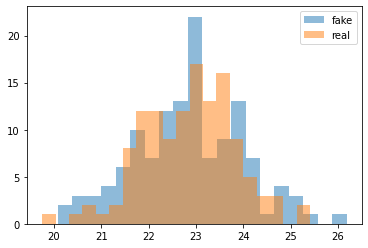

cum_dis_loss 0.2722008947134018, cum_gen_loss 0.2715079183876514


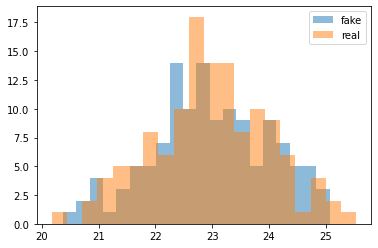

cum_dis_loss 0.2700630868375301, cum_gen_loss 0.27606658935546874


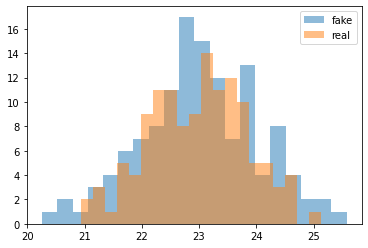

cum_dis_loss 0.2718646903932095, cum_gen_loss 0.2730384597182274


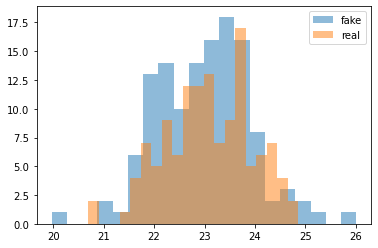

cum_dis_loss 0.26805300575494767, cum_gen_loss 0.2752041655778885


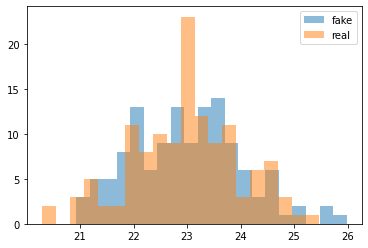

cum_dis_loss 0.2698272726535797, cum_gen_loss 0.27254646211862565


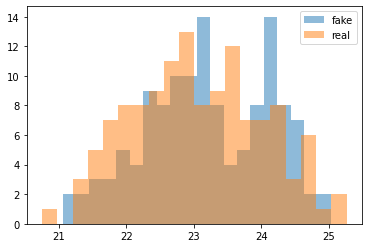

cum_dis_loss 0.2692152083218098, cum_gen_loss 0.27018692657351495


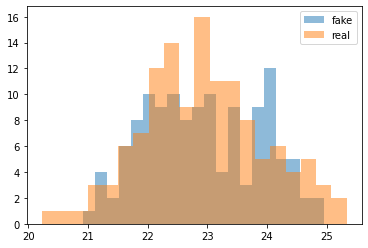

cum_dis_loss 0.2703963817954063, cum_gen_loss 0.2743250513076782


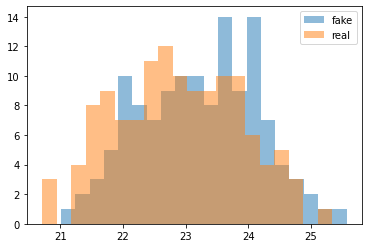

cum_dis_loss 0.272175062328577, cum_gen_loss 0.27954036980867386


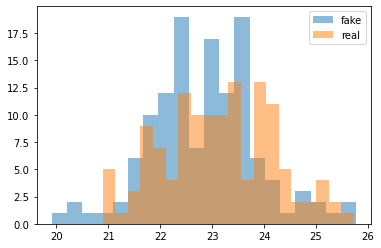

cum_dis_loss 0.27057368090748785, cum_gen_loss 0.27680350437760354


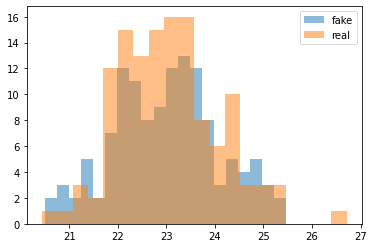

cum_dis_loss 0.2688492662012577, cum_gen_loss 0.27255520835518837


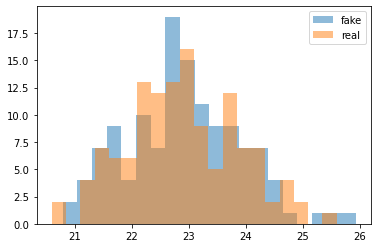

cum_dis_loss 0.26790160501003263, cum_gen_loss 0.26547782734036446


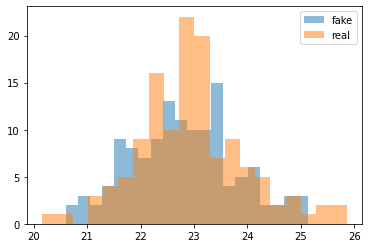

cum_dis_loss 0.2750420663356781, cum_gen_loss 0.27881563261151315


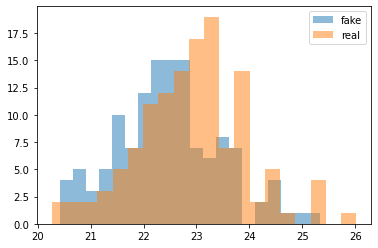

cum_dis_loss 0.2742243523299694, cum_gen_loss 0.2864549282193184


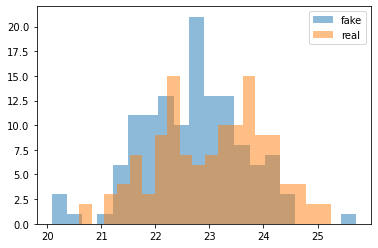

cum_dis_loss 0.2750262479186058, cum_gen_loss 0.27708080351352693


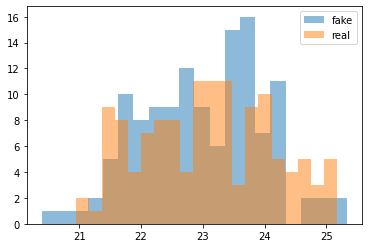

cum_dis_loss 0.2702593732774258, cum_gen_loss 0.26834239035844804


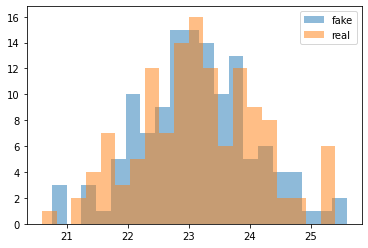

cum_dis_loss 0.27201704755425454, cum_gen_loss 0.2697024475038052


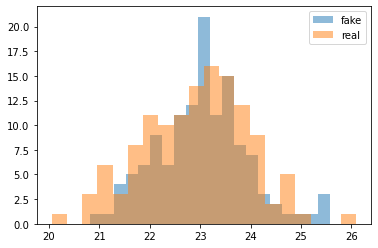

cum_dis_loss 0.2722390469908714, cum_gen_loss 0.2824649925529957


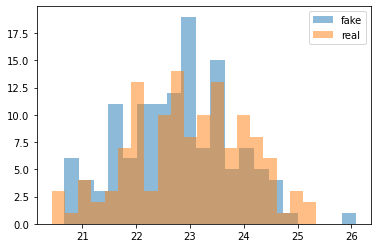

cum_dis_loss 0.2654621320664883, cum_gen_loss 0.27012591004371644


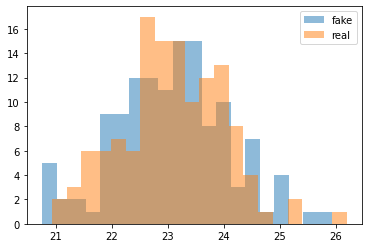

cum_dis_loss 0.2737775717377663, cum_gen_loss 0.27144723415374755


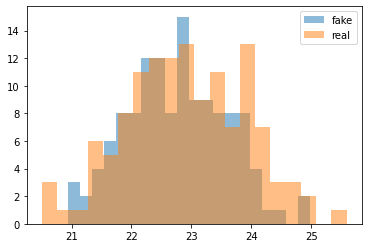

cum_dis_loss 0.27293837997317316, cum_gen_loss 0.2790933087468147


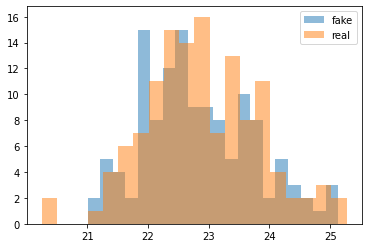

cum_dis_loss 0.2655502966940403, cum_gen_loss 0.2705715920031071


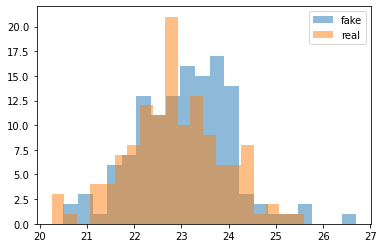

cum_dis_loss 0.2704694423675537, cum_gen_loss 0.27321151584386827


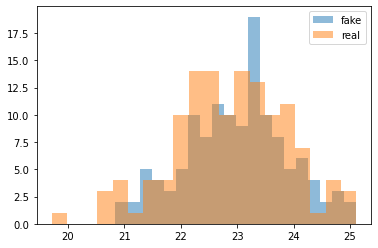

cum_dis_loss 0.2652462426126003, cum_gen_loss 0.26601131752133367


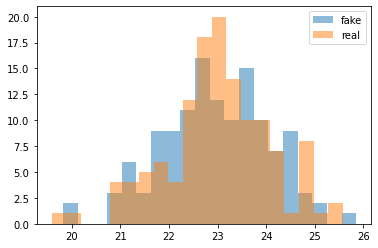

cum_dis_loss 0.268757609218359, cum_gen_loss 0.2707567273080349


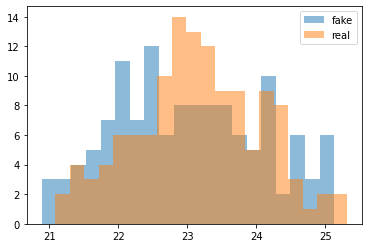

cum_dis_loss 0.27018778029084206, cum_gen_loss 0.2744953724741936


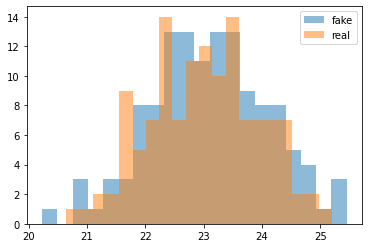

cum_dis_loss 0.27516880783438685, cum_gen_loss 0.27162441447377206


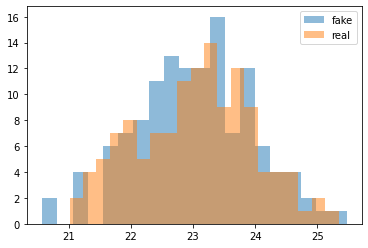

cum_dis_loss 0.2673839135169983, cum_gen_loss 0.2776417388021946


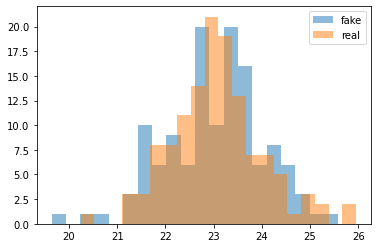

cum_dis_loss 0.27266507512331006, cum_gen_loss 0.2808958797156811


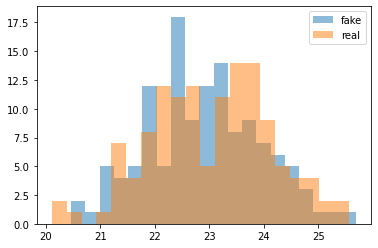

cum_dis_loss 0.2704392893910408, cum_gen_loss 0.268710221350193


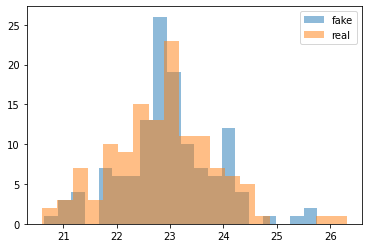

cum_dis_loss 0.26846426606178286, cum_gen_loss 0.27597736939787865


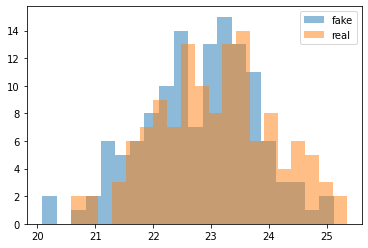

cum_dis_loss 0.2717913788855076, cum_gen_loss 0.2750261442363262


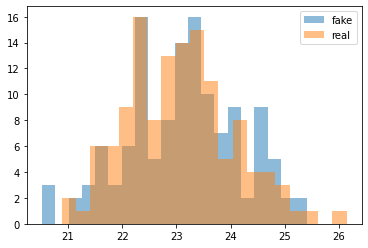

cum_dis_loss 0.27668283113837244, cum_gen_loss 0.26751927837729456


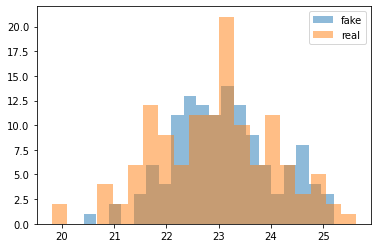

cum_dis_loss 0.2742741665244102, cum_gen_loss 0.27277991905808446


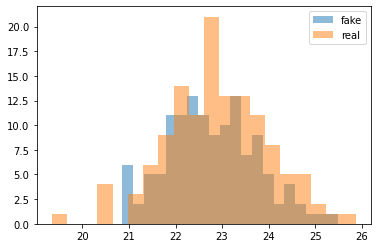

cum_dis_loss 0.27482568404078483, cum_gen_loss 0.278208535015583


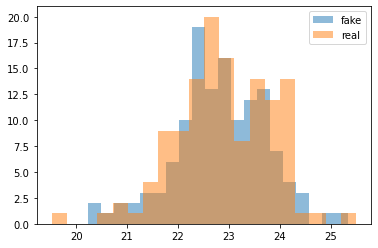

cum_dis_loss 0.27100453343987463, cum_gen_loss 0.2771481941640377


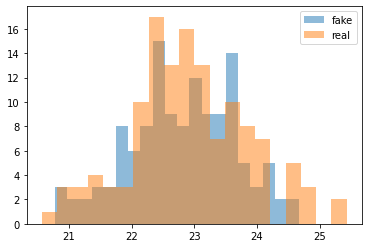

cum_dis_loss 0.2724207821190357, cum_gen_loss 0.28015478238463404


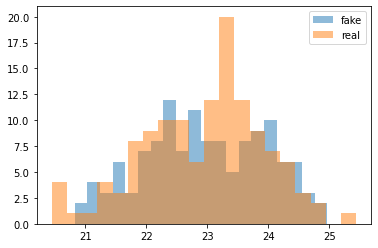

cum_dis_loss 0.28334245944023134, cum_gen_loss 0.2821449741721153


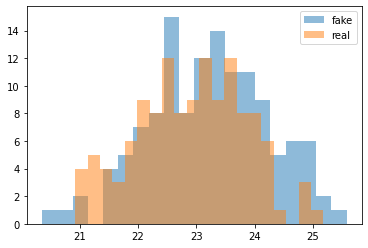

cum_dis_loss 0.2709517313838005, cum_gen_loss 0.27314606741070746


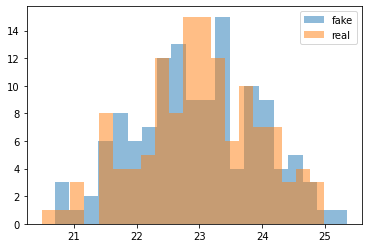

cum_dis_loss 0.26934505918622015, cum_gen_loss 0.27074191987514495


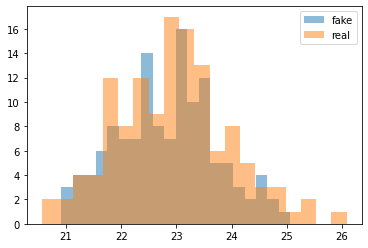

cum_dis_loss 0.27327001830935477, cum_gen_loss 0.27481484204530715


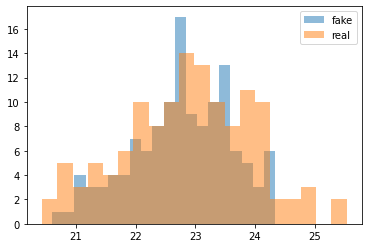

cum_dis_loss 0.2691051820218563, cum_gen_loss 0.2703762069344521


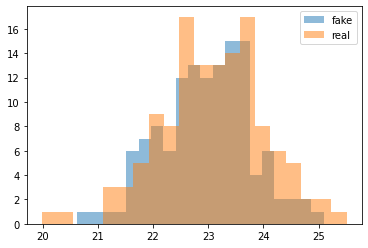

cum_dis_loss 0.2719332215487957, cum_gen_loss 0.27298544079065323


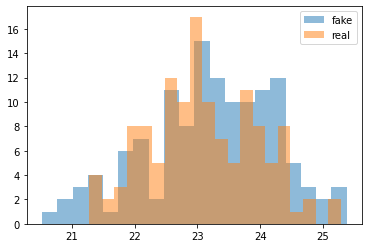

cum_dis_loss 0.2771209505498409, cum_gen_loss 0.2836565233767033


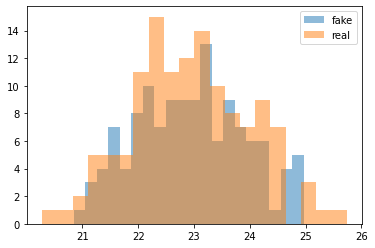

cum_dis_loss 0.27437471416592596, cum_gen_loss 0.27868448495864867


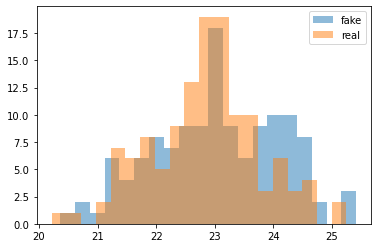

cum_dis_loss 0.2696620092093945, cum_gen_loss 0.27047268211841585


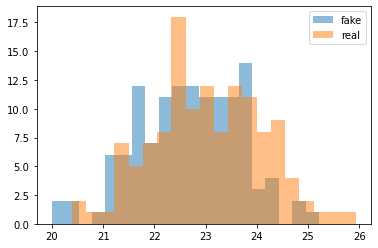

cum_dis_loss 0.2690411780625582, cum_gen_loss 0.2771614477038383


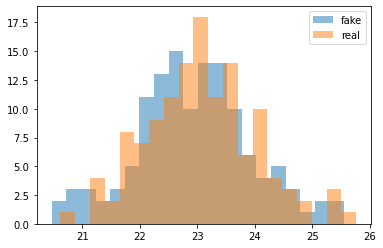

cum_dis_loss 0.2783081155717373, cum_gen_loss 0.2858514167368412


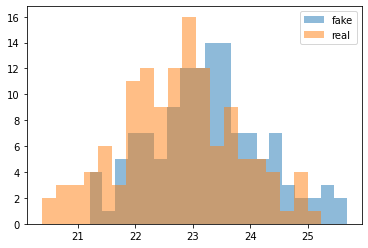

cum_dis_loss 0.27450450816750527, cum_gen_loss 0.27355380564928056


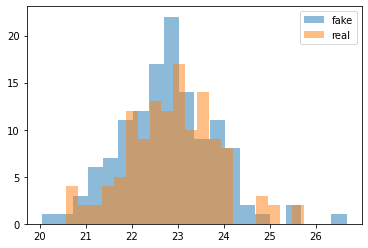

KeyboardInterrupt: 

In [12]:
for iteration in range(num_iteration):
    for i in range(num_enc_dec):
        enc.zero_grad()
        dec.zero_grad()
        target = data_sampler(target_dist, target_param, batch_size)
        noise = data_sampler(noise_dist, noise_param, batch_size)
        encoded_target = enc.forward(target)
        decoded_target = dec.forward(encoded_target)
        L2_AE_target = (target - decoded_target).pow(2).mean()
        transformed_noise = gen.forward(noise)
        encoded_noise = enc.forward(transformed_noise)
        decoded_noise = dec.forward(encoded_noise)
        L2_AE_noise = (transformed_noise - decoded_noise).pow(2).mean()
        MMD = mix_rbf_mmd2(encoded_target, encoded_noise, sigma_list)
        MMD = F.relu(MMD)
        L_MMD_AE = -1 * (torch.sqrt(MMD)-lambda_AE*(L2_AE_noise+L2_AE_target))
        L_MMD_AE.backward()
        enc_optimizer.step()
        dec_optimizer.step()
        cum_dis_loss = cum_dis_loss - L_MMD_AE.item()
    for i in range(num_gen):
        gen.zero_grad()
        target = data_sampler(target_dist, target_param, batch_size)
        noise = data_sampler(noise_dist, noise_param, batch_size)
        encoded_target = enc.forward(target)
        encoded_noise = enc.forward(gen.forward(noise))
        MMD = torch.sqrt(F.relu(mix_rbf_mmd2(encoded_target, encoded_noise, sigma_list)))
        MMD.backward()
        gen_optimizer.step()
        cum_gen_loss = cum_gen_loss + MMD.item()
    if iteration % print_int == 0 and iteration != 0:
        print('cum_dis_loss {}, cum_gen_loss {}'.format(cum_dis_loss/(print_int*num_enc_dec), cum_gen_loss/(print_int*num_gen)))
        cum_dis_loss = 0
        cum_gen_loss = 0
        target = data_sampler(target_dist, target_param, batch_size)
        target = target.data.numpy().reshape(batch_size)
        noise = data_sampler(noise_dist, noise_param, batch_size)
        transformed_noise = gen.forward(noise)
        transformed_noise = transformed_noise.data.numpy().reshape(batch_size)

        # plt.hist(target, 20)
        plt.hist(transformed_noise, 20, label='fake',alpha=0.5)

        plt.hist(target,20,label="real",alpha=0.5)
        plt.legend()
        plt.show()